# Abstract

Author : Geneviève Masioni

Email : genevieve.masioni@estudiants.urv.cat


### /!\ The full PDF report can be found in the same folder as this notebook.  /!\ 

### Background

**Sentiment analysis (or opinion mining) is a natural language processing technique usually performed on textual data to determine whether a piece of data is positive, negative, or neutral**. Traditionally, it allows businesses to monitor sentiment in customer feedback and therefore tailor their products or services to match their customers’ needs. This technique is **here applied to YouTube comments to help online content creators monitor their audience’s opinion without reading all the comments under a video**. This is particularly useful for those whose content generates thousands to millions of reactions.

###  Aims 

This project has multiple goals that work towards allowing the user to :
1. Get an overview of the audience's opinion on a piece of content (**sentiment + emotion classification**), 
2. Roughly know what is discussed in the comment section (**topic classification**), 
3. Spot intense negative emotions and take actions (report or ban toxic viewers).

The optimal situation is for the overview to provide insights on different objective aspects of the video : video, audio, content, length and editing quality.

###  Method 

The key steps of this project are :
1. **Data collection using the Youtube API**. Creation of JSON files to design a **NoSQL database using Elasticsearch**. Each comment is a document and one JSON file is created per video (a reference to the video is stored in the document).
2. **Data preprocessing** : text cleaning and comment classification (sentiment, emotion, toxicity and topic) using Tensorflow/ PyTorch.
3. **Data analysis** : analysis of the classified comments to answer 3 key questions ; 
    - What are the overall sentiment and emotions ? 
    - What are people talking about ? 
    - Are they any inappropriate comments ? Who is publishing those comments ?

4. **Data summarisation in a Kibana dashboard**.

### Results 

Dashboard sentiment, topics and emotions portrayed under a video’s comment section. 

### Tools  
- Youtube API : data collection (video comments).
- NoSQL with Elasticsearch : for its tokenization feature that allows us to search through text.
- Python Transformers package (based on Tensorflow and PyTorch) for text classification using different models (sentiment, emotion, toxicity and topic classification).
- Kibana : data visualisation (final dashboard).
- Jupyter notebook : source code and synthetic explanation of our process.


### About this notebook
This notebook applies our method on a TEDx Talks video *[When money isn’t real: the 10,000 experiment](https://www.youtube.com/watch?v=_VB39Jo8mAQ)* with **4 690 comments**.

# 0. Configuration : packages, database

In [111]:
# Install required packages
import sys
!{sys.executable} -m pip install --upgrade pip
!{sys.executable} -m pip install torch
!{sys.executable} -m pip install tensorflow
!{sys.executable} -m pip install transformers
!{sys.executable} -m pip install --upgrade google-api-python-client
!{sys.executable} -m pip install detoxify
!{sys.executable} -m pip install python-setuptools
!{sys.executable} -m pip install top2vec[sentence_transformers]

# utils  
import pprint
import json
import time
import re
import pandas as pd
import matplotlib.pyplot as plt

Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable


Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable


Defaulting to user installation because normal site-packages is not writeable
ERROR: Could not find a version that satisfies the requirement python-setuptools (from versions: none)
ERROR: No matching distribution found for python-setuptools
Defaulting to user installation because normal site-packages is not writeable
  Using cached top2vec-1.0.26-py3-none-any.whl (23 kB)
  Using cached hdbscan-0.8.27.tar.gz (6.4 MB)
  distutils: /private/var/folders/kw/3dmrcwg93xg8dgblvc_0rvnc0000gn/T/pip-build-env-4s1natqx/normal/lib/python3.8/site-packages
  sysconfig: /Library/Python/3.8/site-packages
  distutils: /private/var/folders/kw/3dmrcwg93xg8dgblvc_0rvnc0000gn/T/pip-build-env-4s1natqx/normal/lib/python3.8/site-packages
  sysconfig: /Library/Python/3.8/site-packages
  user = False
  home = None
  root = None
  prefix = '/private/var/folders/kw/3dmrcwg93xg8dgblvc_0rvnc0000gn/T/pip-build-env-4s1natqx/normal'
  distutils: /private/var/folders/kw/3dmrcwg93xg8dgblvc_0rvnc0000gn/T/pip-build-env-4s1

## Database setup : Elasticsearch and Kibana

In [83]:
import docker

client = docker.from_env()
# pull elasticsearch
image = client.images.pull('docker.elastic.co/elasticsearch/elasticsearch:7.12.1')
print(image)
# pull kibana
image = client.images.pull('docker.elastic.co/kibana/kibana:7.12.1')
print(image)

# create a network so kibana can find elastic
client.networks.create('elastic')
container = client.containers.run(
    image='docker.elastic.co/elasticsearch/elasticsearch:7.12.1',
    auto_remove=True,
    environment={'discovery.type':'single-node'},
    name='bda-project-masioni',
    ports={9200:9200, 9300:9300},
    network='elastic',
    detach=True)
container.logs()

# Now let's start kibana
container = client.containers.run(
    image='docker.elastic.co/kibana/kibana:7.12.1',
    auto_remove=True,
    name='bda-kb',
    environment={'ELASTICSEARCH_HOSTS':'http://bda-project-masioni:9200'},
    ports={5601:5601},
    network='elastic',
    detach=True)
container.logs()
display(container.status)
container.top()

<Image: 'docker.elastic.co/elasticsearch/elasticsearch:7.12.1'>
<Image: 'docker.elastic.co/kibana/kibana:7.12.1'>


'created'

{'Processes': [['1000',
   '9152',
   '9124',
   '3',
   '11:12',
   '?',
   '00:00:00',
   '/bin/tini -- /usr/local/bin/kibana-docker'],
  ['1000',
   '9235',
   '9152',
   '0',
   '11:12',
   '?',
   '00:00:00',
   '/bin/bash /usr/local/bin/kibana-docker'],
  ['1000',
   '9282',
   '9235',
   '0',
   '11:12',
   '?',
   '00:00:00',
   '/bin/bash /usr/local/bin/kibana-docker']],
 'Titles': ['UID', 'PID', 'PPID', 'C', 'STIME', 'TTY', 'TIME', 'CMD']}

# 1. Data gathering

**NOTE** : You can either 
- Block 1.1 : run the entire data gathering process using the YouTube API and classify (approx 1.8 minute)
- Block 1.2 : load the data from a JSON file in the *dataset/* folder (ready-to-use result of block 1.1).

In [52]:
# GLOBAL VARS + UTILS - THIS BLOCK MUST BE EXECUTED 
   
# Video to analyze : TEDx Talks - "When money isn’t real: the $10,000 experiment"
VIDEO_ID = "_VB39Jo8mAQ"

def save_data(video_id, comments):
    file = open("dataset/" + video_id + ".json", "w")
    json.dump(comments, file)
    f.close()
    
def load_data(video_id):
    with open("dataset/" + video_id + ".json") as json_file:
        data = json.load(json_file)
        data = {int(k):v for k,v in data.items()}
        return data

## 1.1 Fetch data using YouTube API

In [53]:
import os
import googleapiclient.discovery

# Get YouTube API Key from file
DEVELOPER_KEY = ""
with open('credentials/credentials.txt') as f: 
    DEVELOPER_KEY = f.readlines()

# Disable OAuthlib's HTTPS verification when running locally.
# *DO NOT* leave this option enabled in production.
os.environ["OAUTHLIB_INSECURE_TRANSPORT"] = "1"

api_service_name = "youtube"
api_version = "v3"
youtube = googleapiclient.discovery.build(
    api_service_name, api_version, developerKey = DEVELOPER_KEY)
    
def get_comment_replies(comments):
    comments_extended = comments
    for comment in comments:
        if(comment['snippet']['totalReplyCount'] > 0):
            comment_id = comment['id']
            request = youtube.comments().list(
                part="snippet",
                maxResults=100,
                parentId=comment_id,
                textFormat="plainText"
            )
            response = request.execute()
            comments_extended = comments_extended + response["items"]
    return comments_extended
    
def get_data_from_youtube_api(video_id):
    request = youtube.commentThreads().list(
        part="snippet",
        maxResults=100,
        textFormat="plainText",
        videoId=video_id
    )
    response = request.execute()
    comments = get_comment_replies(response["items"])
    
    if("nextPageToken" in response):
        next_page_token = response["nextPageToken"]
        while(next_page_token):
            request = youtube.commentThreads().list(
                part="snippet",
                maxResults=100,
                textFormat="plainText",
                videoId=video_id,
                pageToken=next_page_token
            )
            response = request.execute()
            comments = comments + get_comment_replies(response["items"])
            if("nextPageToken" in response):
                next_page_token = response["nextPageToken"]
            else:
                next_page_token = None
    return comments

start = time.time()
comments = get_data_from_youtube_api(VIDEO_ID)
end = time.time()
print("Elapsed time : ", end - start)
print("Number of comments : ", len(comments))
print("Sneak peek : ")
pprint.pprint(comments[0])

# Transform to dictionary
indexes = list(range(len(comments)))
comments = dict(zip(indexes, comments))
# Save to JSON file
save_data(VIDEO_ID, comments)

Elapsed time :  55.13409399986267
Number of comments :  4656
Sneak peek : 
{'etag': 'VYCu_WJjXxGgqAuGYvyP-1zTjOo',
 'id': 'UgxK5RGyzy_FAG4R_1d4AaABAg',
 'kind': 'youtube#commentThread',
 'snippet': {'canReply': True,
             'isPublic': True,
             'topLevelComment': {'etag': 'ze2S-AAQlPiB2p3bdV5qM7YNTm4',
                                 'id': 'UgxK5RGyzy_FAG4R_1d4AaABAg',
                                 'kind': 'youtube#comment',
                                 'snippet': {'authorChannelId': {'value': 'UCzY2ONyq7_ge_doVLjOdBJg'},
                                             'authorChannelUrl': 'http://www.youtube.com/channel/UCzY2ONyq7_ge_doVLjOdBJg',
                                             'authorDisplayName': 'Pete '
                                                                  'Romocki',
                                             'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTY4QYWXCxqmfXtPsy7rq3ofDicZUPTf3E9nbcv8A=s48-c-k-c0x00ffffff-no-rj',
 

## 1.2 Load data from a stored JSON file

The file is a ready-to-use result of the gathering process 1.1.

In [36]:
comments = load_data(VIDEO_ID)
pprint.pprint(comments[0])

{'etag': 'VYCu_WJjXxGgqAuGYvyP-1zTjOo',
 'id': 'UgxK5RGyzy_FAG4R_1d4AaABAg',
 'kind': 'youtube#commentThread',
 'snippet': {'canReply': True,
             'isPublic': True,
             'topLevelComment': {'etag': 'ze2S-AAQlPiB2p3bdV5qM7YNTm4',
                                 'id': 'UgxK5RGyzy_FAG4R_1d4AaABAg',
                                 'kind': 'youtube#comment',
                                 'snippet': {'authorChannelId': {'value': 'UCzY2ONyq7_ge_doVLjOdBJg'},
                                             'authorChannelUrl': 'http://www.youtube.com/channel/UCzY2ONyq7_ge_doVLjOdBJg',
                                             'authorDisplayName': 'Pete '
                                                                  'Romocki',
                                             'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTY4QYWXCxqmfXtPsy7rq3ofDicZUPTf3E9nbcv8A=s48-c-k-c0x00ffffff-no-rj',
                                             'canRate': True,
              

# 2. Data preprocessing

### 2.1 Text cleaning 

- Special character cleaning (e.g. "\n")
- Links (e.g. self-promotion, spam)

We DO NOT apply the following :
- Remove punctuations (e.g. "?, !, ;")
- Remove emojis

BECAUSE that information (punctuation, emojis...) **helps correctly classify emotions**. Removing those key elements affects the performance of the emotion classifier, as our tests showed :

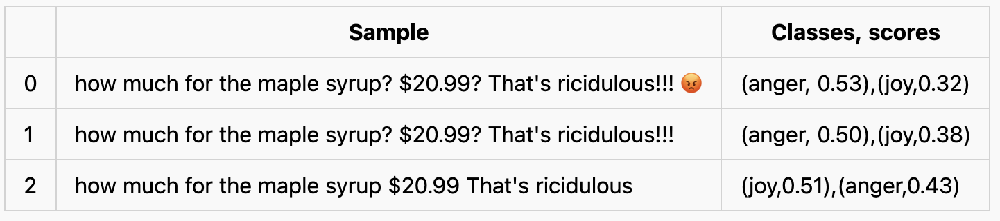

In [54]:
def normalise_comments(comments):
    normalised_comments = comments
    for key in comments:
        comment = comments[key]
        comment_type = comment["kind"]
        message = ""
        if(comment_type == "youtube#commentThread"):
            normalised_comments[key] = comment['snippet']['topLevelComment']
    return normalised_comments

def clean_comments(comments):
    for key in comments:
        comment = comments[key]
        comment_type = comment["kind"]
        message = comment['snippet']['textDisplay']
        message = re.sub(r"\\n|\\r|\\t|\\v", "", message)
        message = re.sub(r"\S*https?:\S*", "", message)
        if(comment_type == "youtube#comment"):
            comment['snippet']['textDisplay'] = message
        else:
            comment['snippet']['topLevelComment']['snippet']['textDisplay'] = message
        
start = time.time()
comments = normalise_comments(comments)
clean_comments(comments)
end = time.time()
print("Elapsed time : ", end - start)
print("Sneak peek : ")
pprint.pprint(comments[0])

Elapsed time :  0.13419508934020996
Sneak peek : 
{'etag': 'ze2S-AAQlPiB2p3bdV5qM7YNTm4',
 'id': 'UgxK5RGyzy_FAG4R_1d4AaABAg',
 'kind': 'youtube#comment',
 'snippet': {'authorChannelId': {'value': 'UCzY2ONyq7_ge_doVLjOdBJg'},
             'authorChannelUrl': 'http://www.youtube.com/channel/UCzY2ONyq7_ge_doVLjOdBJg',
             'authorDisplayName': 'Pete Romocki',
             'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTY4QYWXCxqmfXtPsy7rq3ofDicZUPTf3E9nbcv8A=s48-c-k-c0x00ffffff-no-rj',
             'canRate': True,
             'likeCount': 0,
             'publishedAt': '2021-12-21T13:55:43Z',
             'textDisplay': 'In the old days we got our money from '
                            'working.....paper routes.',
             'textOriginal': 'In the old days we got our money from '
                             'working.....paper routes.',
             'updatedAt': '2021-12-21T13:55:43Z',
             'videoId': '_VB39Jo8mAQ',
             'viewerRating': 'none'}}


### 2.1 Missing values

The YouTube API doesn't return missing (null / None) per se as the data is preprocessed to be searchable, e.g. *'viewerRating': 'none'* (string value) for the first comment.

Even if Elasticsearch doesn't index missing values, all data will be indexed here and searching  for missing values won't return an error. For that reason, we won't need to create a new index to be able to map missing values.

### 2.3 Add sentiment, emotion and topic attributes

**The classification takes about 20,35 minutes. You can skip steps 2.3 and run 2.4 instead (load preprocessed dataset, ready-to-use).**

- Sentiment : { positive, negative }
- Emotion : { sadness, joy, love, anger, fear, surprise }
- Toxicity : { toxic, severe_toxic, obscene, threat, insult, identity_hate }
- Topic : {}


In [55]:
import tensorflow
from transformers import pipeline
from detoxify import Detoxify
from top2vec import Top2Vec

sentiment_classifier = pipeline("sentiment-analysis", model="distilbert-base-uncased-finetuned-sst-2-english") 
emotion_classifier = pipeline("text-classification", model='bhadresh-savani/distilbert-base-uncased-emotion')
toxic_classifier = Detoxify('original')
topic_classifier = Top2Vec(documents, embedding_model='universal-sentence-encoder')

def classify_comments(comments):
    for key in comments:
        comment = comments[key]
        comment_type = comment["kind"]
        message = comment['snippet']['textDisplay']
        # truncate string at 510 characters to match the size of sentiment analysis tensor (512)
        message = (message[:510]) if len(message) > 510 else message
        sentiment = sentiment_classifier(message)[0]
        comment['sentiment'] = { }
        comment['sentiment']['label'] = sentiment['label']
        comment['sentiment']['score'] = str(sentiment['score'])

        emotion = emotion_classifier(message)[0]
        comment['emotion'] = { }
        comment['emotion']['label'] = emotion['label']
        comment['emotion']['score'] = str(emotion['score'])

        toxicity = toxic_classifier.predict(message)
        # ensure naming consistency
        toxicity['identityAttack'] = toxicity.pop("identity_attack")
        toxicity['severeToxicity'] = toxicity.pop("severe_toxicity")
        # float to string (to make them JSON serializable)
        toxicity['identityAttack'] = str(toxicity['identityAttack'])
        toxicity['severeToxicity'] = str(toxicity['severeToxicity'])
        toxicity['toxicity'] = str(toxicity.pop('toxicity'))
        toxicity['obscene'] = str(toxicity.pop('obscene'))
        toxicity['threat'] = str(toxicity.pop('threat'))
        toxicity['insult'] = str(toxicity.pop('insult'))
        comment['toxicity'] = toxicity

start = time.time()
classify_comments(comments)
end = time.time()

# Save the extended dataset in JSON file
save_data(VIDEO_ID + "_preprocessed", comments)

print("Elapsed time : ", end - start)
print("Sneak peek : ")
pprint.pprint(comments[0])

Elapsed time :  1300.4763469696045
Sneak peek : 
{'emotion': {'label': 'joy', 'score': '0.6709767580032349'},
 'etag': 'ze2S-AAQlPiB2p3bdV5qM7YNTm4',
 'id': 'UgxK5RGyzy_FAG4R_1d4AaABAg',
 'kind': 'youtube#comment',
 'sentiment': {'label': 'NEGATIVE', 'score': '0.9932653903961182'},
 'snippet': {'authorChannelId': {'value': 'UCzY2ONyq7_ge_doVLjOdBJg'},
             'authorChannelUrl': 'http://www.youtube.com/channel/UCzY2ONyq7_ge_doVLjOdBJg',
             'authorDisplayName': 'Pete Romocki',
             'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTY4QYWXCxqmfXtPsy7rq3ofDicZUPTf3E9nbcv8A=s48-c-k-c0x00ffffff-no-rj',
             'canRate': True,
             'likeCount': 0,
             'publishedAt': '2021-12-21T13:55:43Z',
             'textDisplay': 'In the old days we got our money from '
                            'working.....paper routes.',
             'textOriginal': 'In the old days we got our money from '
                             'working.....paper routes.',

### 2.4 Load preprocessed data from saved JSON file (instead of 2.3)

In [29]:
comments = load_data(VIDEO_ID + "_preprocessed")
pprint.pprint(comments[0])

<class 'dict'>
{'0': {'emotion': {'label': 'joy', 'score': '0.6709767580032349'},
       'etag': 'VYCu_WJjXxGgqAuGYvyP-1zTjOo',
       'id': 'UgxK5RGyzy_FAG4R_1d4AaABAg',
       'kind': 'youtube#commentThread',
       'sentiment': {'label': 'NEGATIVE', 'score': '0.9932653903961182'},
       'snippet': {'canReply': True,
                   'isPublic': True,
                   'topLevelComment': {'etag': 'ze2S-AAQlPiB2p3bdV5qM7YNTm4',
                                       'id': 'UgxK5RGyzy_FAG4R_1d4AaABAg',
                                       'kind': 'youtube#comment',
                                       'snippet': {'authorChannelId': {'value': 'UCzY2ONyq7_ge_doVLjOdBJg'},
                                                   'authorChannelUrl': 'http://www.youtube.com/channel/UCzY2ONyq7_ge_doVLjOdBJg',
                                                   'authorDisplayName': 'Pete '
                                                                        'Romocki',
                    

 '1009': {'emotion': {'label': 'anger', 'score': '0.7611037492752075'},
          'etag': 'bLN7zeGlpynVzoiYn1_8lRe86w0',
          'id': 'Ugz8-Ts4kIEKHcTS-rZ4AaABAg',
          'kind': 'youtube#commentThread',
          'replies': {'comments': [{'etag': 'yn1CAyXxqXsL2uSZtQM31hNYXYE',
                                    'id': 'Ugz8-Ts4kIEKHcTS-rZ4AaABAg.8zZO73UXm448z_79pCRjM_',
                                    'kind': 'youtube#comment',
                                    'snippet': {'authorChannelId': {'value': 'UCC2-TgVrgGAf_TR-XzETbuQ'},
                                                'authorChannelUrl': 'http://www.youtube.com/channel/UCC2-TgVrgGAf_TR-XzETbuQ',
                                                'authorDisplayName': 'Tomasz',
                                                'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQec7LdWCvHt2nFxLUjXLXBC8zsCOdeWdk0eItxhbo=s48-c-k-c0x00ffffff-no-rj',
                                                'canRate': True,
    

                                                                     'explain '
                                                                     'that.',
                                                      'textOriginal': 'On '
                                                                      'comment '
                                                                      'sections '
                                                                      'people '
                                                                      'always '
                                                                      'say '
                                                                      'money '
                                                                      'isn’t '
                                                                      'real '
                                                                      'but '
                                                     

                                                                      'but '
                                                                      'sure, '
                                                                      'millennials '
                                                                      'and '
                                                                      'their '
                                                                      'damn '
                                                                      'technology '
                                                                      'is the '
                                                                      'problem.',
                                                      'updatedAt': '2019-08-29T15:25:44Z',
                                                      'videoId': '_VB39Jo8mAQ',
                                                      'viewerRating': 'none'}},
                      'total

                      'videoId': '_VB39Jo8mAQ'},
          'toxicity': {'identityAttack': '0.00029446936',
                       'insult': '0.0005591409',
                       'obscene': '0.00037434392',
                       'severeToxicity': '9.732149e-05',
                       'threat': '0.00017594695',
                       'toxicity': '0.013686819'}},
 '103': {'emotion': {'label': 'anger', 'score': '0.7316976189613342'},
         'etag': 'gtJwEOlh5IpiBhqYOF77RA1z7yQ',
         'id': 'Ugx0ldYXrv3jiHapJlx4AaABAg.9Mv9_bbdTVp9Mv9urq0qHJ',
         'kind': 'youtube#comment',
         'sentiment': {'label': 'NEGATIVE', 'score': '0.9958776235580444'},
         'snippet': {'authorChannelId': {'value': 'UCHidrhgaNJ6qc1wdcJtkWNA'},
                     'authorChannelUrl': 'http://www.youtube.com/channel/UCHidrhgaNJ6qc1wdcJtkWNA',
                     'authorDisplayName': 'Qwerty',
                     'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLR-X1prcu3fRHSN4YR1p5RHUip

                                                                      'they '
                                                                      'have '
                                                                      'new way '
                                                                      'to pay '
                                                                      'called '
                                                                      'pay '
                                                                      'after. '
                                                                      'They '
                                                                      'all the '
                                                                      'same '
                                                                      'things '
                                                                      'just '
                                                   

                                                                      'by '
                                                                      'it. \n'
                                                                      '\n'
                                                                      'Have a '
                                                                      'nice '
                                                                      'day & '
                                                                      'enjoy '
                                                                      'your '
                                                                      'life!',
                                                      'updatedAt': '2019-08-15T13:15:31Z',
                                                      'videoId': '_VB39Jo8mAQ',
                                                      'viewerRating': 'none'}},
                      'totalReplyCount': 0,
  

                                     'something, rather than via tax. Think '
                                     'McDonalds printing tickets for free '
                                     'burgers.',
                      'textOriginal': '@Nidhogg Nope, if the state is on the '
                                      'gold standard then any money created by '
                                      'the state has to be "backed up" with '
                                      'physical gold. Neither the UK or US are '
                                      'able to do this anymore. They can print '
                                      'money.\n'
                                      'It is identical for private companies, '
                                      'except private companies have to '
                                      'produce something, rather than via tax. '
                                      'Think McDonalds printing tickets for '
                                   

                       'toxicity': '0.0008426435'}},
 '1082': {'emotion': {'label': 'joy', 'score': '0.90317702293396'},
          'etag': 'jJSxuSZB4Ydt4o9qgq2tzFNRbmo',
          'id': 'UgwIFsTHrs2Lx2GIYOh4AaABAg.8yfTFK_k7478ygrq6ex2ho',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'POSITIVE', 'score': '0.9996306896209717'},
          'snippet': {'authorChannelId': {'value': 'UCGHbkVsnFyE44mL07J6VDJg'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCGHbkVsnFyE44mL07J6VDJg',
                      'authorDisplayName': 'Justas',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTcSXTfrkTB2uM2EOH1Ag7sgljxZIP-pR_LmA77Yg=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 1,
                      'parentId': 'UgwIFsTHrs2Lx2GIYOh4AaABAg',
                      'publishedAt': '2019-08-16T12:10:13Z',
                      'textDisplay': "I think that's what real

                                                                     'She had '
                                                                     'many '
                                                                     'other '
                                                                     'money '
                                                                     'tricks '
                                                                     'she '
                                                                     'taught '
                                                                     'us...lessons '
                                                                     'well '
                                                                     'learned '
                                                                     'and now '
                                                                     'being '
                                                     

                                                                     'for '
                                                                     'money '
                                                                     'are more '
                                                                     'financially '
                                                                     'stable '
                                                                     'then '
                                                                     'those '
                                                                     'who are '
                                                                     'not. \n'
                                                                     '\n'
                                                                     'side '
                                                                     'theory: '
                                                         

                                                               'can. Because '
                                                               'of jail, the '
                                                               'orange '
                                                               'properties '
                                                               'have high '
                                                               'probability to '
                                                               'be landed on.',
                                                'textOriginal': 'I always '
                                                                'bought the '
                                                                'orange '
                                                                'properties '
                                                                'and won '
                                                                'probably 

 '1118': {'emotion': {'label': 'joy', 'score': '0.9985976815223694'},
          'etag': '4sMNzE7d9I5NanNZTKuA2wsSLhk',
          'id': 'Ugy8I9hnMocARN4Cmq94AaABAg',
          'kind': 'youtube#commentThread',
          'replies': {'comments': [{'etag': 'pGz7_MKG7fQIHAzV7b0kc4ASQNI',
                                    'id': 'Ugy8I9hnMocARN4Cmq94AaABAg.8yA23qUfg359-_OjNd9LGy',
                                    'kind': 'youtube#comment',
                                    'snippet': {'authorChannelId': {'value': 'UCfKfpm1uUM6zjfpXXrYcz_g'},
                                                'authorChannelUrl': 'http://www.youtube.com/channel/UCfKfpm1uUM6zjfpXXrYcz_g',
                                                'authorDisplayName': 'Typical '
                                                                     'Tom',
                                                'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLS-rTAxdCFBsqG42P03GVDNjg9wFoKUoGqk9ww8=s48-c-k-c0x00ffffff-no-rj

                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCuUBokizTY_jvCuW9tN2Y6w'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCuUBokizTY_jvCuW9tN2Y6w',
                                                      'authorDisplayName': 'Icy '
                                                                           'Kioshii',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTxZYJtooQxPedqK4fmlPNggZhflcwlA1EIlka4TA=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                                      'publishedAt': '2019-08-01T00:45:38Z',
                                                      'textDisplay': 'This '
                          

                                                      'textOriginal': 'I seen '
                                                                      'a '
                                                                      'father '
                                                                      'letting '
                                                                      'his kid '
                                                                      'pay for '
                                                                      'his '
                                                                      'food on '
                                                                      'his own '
                                                                      'it was '
                                                                      'cute '
                                                                      'and '
                                                

          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'XIGtwLw6D2rcWTw1-KgSI5jDT4w',
                                          'id': 'UgwIZ3FYSTstOmnWogd4AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCFUj65aaK_EohaPdMvxy3qg'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCFUj65aaK_EohaPdMvxy3qg',
                                                      'authorDisplayName': 'GarGar',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLRlT42ufp30q-dBeCbHakDX5LwPm7o5xs5MNq9e5A=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 1,
                                        

                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLT8VRqLumY7k7PUWT-MV4HhBC8YsgklTghw83LaKA=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                                      'publishedAt': '2019-07-10T03:05:30Z',
                                                      'textDisplay': 'Excellent '
                                                                     'presentation, '
                                                                     'well '
                                                                     'worth '
                                                                     'the time '
                                                                     'spent '
                                                                     'watching! '
                     

                                                                     'because '
                                                                     "it's "
                                                                     'tangible '
                                                                     'and you '
                                                                     'see how '
                                                                     'much '
                                                                     'your '
                                                                     'spending',
                                                      'textOriginal': 'I '
                                                                      'always '
                                                                      'use '
                                                                      'cash I '
                                                       

                      'isPublic': True,
                      'topLevelComment': {'etag': 'nhOIqY0YntEToqm9fPXNIFuiO5Q',
                                          'id': 'Ugya7kAQQFwJNukR-x54AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCq3Opt3VOd9eU-QLVDSpCyQ'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCq3Opt3VOd9eU-QLVDSpCyQ',
                                                      'authorDisplayName': 'MrNilsenone',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTRWHXK9FmkDBQlpSvhLEVFqikXtZUT42wWXw=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 7,
                                                      'publishedAt': '2019-06-2

                       'threat': '0.0001720125',
                       'toxicity': '0.0088121705'}},
 '1198': {'emotion': {'label': 'joy', 'score': '0.6406774520874023'},
          'etag': 'TlTFIFRd1o6s-MGAiDKL-jLydFg',
          'id': 'UgwLrWmM3EI8BLwT8ed4AaABAg.8yBbWkWW-by8yEshEcv9_0',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9950193166732788'},
          'snippet': {'authorChannelId': {'value': 'UCluJulf7VscRmivap-a-7_w'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCluJulf7VscRmivap-a-7_w',
                      'authorDisplayName': 'Phil The Cow',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLR4skj1r5xmclcrZsiXcLocKFkXM9dsAePbMpFt=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 1,
                      'parentId': 'UgwLrWmM3EI8BLwT8ed4AaABAg',
                      'publishedAt': '2019-08-05T05:59:46Z',
       

                                                      'viewerRating': 'none'}},
                      'totalReplyCount': 0,
                      'videoId': '_VB39Jo8mAQ'},
          'toxicity': {'identityAttack': '0.00013797093',
                       'insult': '0.00017218219',
                       'obscene': '0.00017782616',
                       'severeToxicity': '0.000115316834',
                       'threat': '0.00011663751',
                       'toxicity': '0.0006776116'}},
 '1215': {'emotion': {'label': 'joy', 'score': '0.9699928760528564'},
          'etag': 'eQFRS2jDCR8Y4CIeKSniG5UwWVk',
          'id': 'Ugz5raeKvPjsO588czR4AaABAg',
          'kind': 'youtube#commentThread',
          'replies': {'comments': [{'etag': 'tTNDCtmUiwLYCQ7OlZRoLAdDEsY',
                                    'id': 'Ugz5raeKvPjsO588czR4AaABAg.8wYo6f5Uc_F9BhgmOxJxp0',
                                    'kind': 'youtube#comment',
                                    'snippet': {'authorChannelId'

                                                                     'only an '
                                                                     'abstraction '
                                                                     "that's "
                                                                     'difficult '
                                                                     'to '
                                                                     'comprehend, '
                                                                     'it is '
                                                                     'also a '
                                                                     'serious '
                                                                     'danger '
                                                                     'to '
                                                                     'society.  '
                                           

                                                                      'worth '
                                                                      'actually '
                                                                      'requires '
                                                                      '$160k.',
                                                      'updatedAt': '2019-06-16T05:38:24Z',
                                                      'videoId': '_VB39Jo8mAQ',
                                                      'viewerRating': 'none'}},
                      'totalReplyCount': 0,
                      'videoId': '_VB39Jo8mAQ'},
          'toxicity': {'identityAttack': '0.00013789425',
                       'insult': '0.00018209642',
                       'obscene': '0.00019587312',
                       'severeToxicity': '0.00010146677',
                       'threat': '0.000106790976',
                       'toxicity': '0.0010671172'}},
 '1229': {'e

                       'obscene': '0.00018586493',
                       'severeToxicity': '9.5838484e-05',
                       'threat': '0.0001050333',
                       'toxicity': '0.0017145191'}},
 '1235': {'emotion': {'label': 'joy', 'score': '0.823815107345581'},
          'etag': 'u9w31Pb5DFW3YnSdrgCnTFKn90M',
          'id': 'UgwCOvwKpQiTfLHMRA94AaABAg',
          'kind': 'youtube#commentThread',
          'replies': {'comments': [{'etag': 'eXrYqduIwL0dNZ_0o88pIwZDxlk',
                                    'id': 'UgwCOvwKpQiTfLHMRA94AaABAg.8w6V98t2AZP8w6uMT5SKRL',
                                    'kind': 'youtube#comment',
                                    'snippet': {'authorChannelId': {'value': 'UC4pBM6hq8GGRagVIL9h1fdg'},
                                                'authorChannelUrl': 'http://www.youtube.com/channel/UC4pBM6hq8GGRagVIL9h1fdg',
                                                'authorDisplayName': 'Caspar',
                                     

                                                                      'for '
                                                                      'this '
                                                                      'experiment '
                                                                      'Annually. '
                                                                      'Now '
                                                                      'continuing '
                                                                      'forward, '
                                                                      'considering '
                                                                      "there's "
                                                                      '327M '
                                                                      'people '
                                                                      'in the '
                               

                       'obscene': '0.0007134563',
                       'severeToxicity': '0.000109804605',
                       'threat': '0.00021656159',
                       'toxicity': '0.027170481'}},
 '1246': {'emotion': {'label': 'anger', 'score': '0.5315079689025879'},
          'etag': 'EJwbofehh8POTauAirQ-101ABaI',
          'id': 'Ugzi4ScNauavNOTjJb14AaABAg',
          'kind': 'youtube#commentThread',
          'replies': {'comments': [{'etag': 'aiweUmVYWNVUDe6_2IdJ0X-vwZo',
                                    'id': 'Ugzi4ScNauavNOTjJb14AaABAg.8vjrZ9HBxi98wQaiUAOiPr',
                                    'kind': 'youtube#comment',
                                    'snippet': {'authorChannelId': {'value': 'UCbVMPxR5Pv91KmQa1L89lgg'},
                                                'authorChannelUrl': 'http://www.youtube.com/channel/UCbVMPxR5Pv91KmQa1L89lgg',
                                                'authorDisplayName': 'PC Adam '
                                 

                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCsWVZ8rVaPKdvMhSlFQKxWQ'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCsWVZ8rVaPKdvMhSlFQKxWQ',
                                                      'authorDisplayName': 'Brent',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSM-SPHzPdm5R3xXzNpWa0jZOw1hvSQeuZl2A=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                                      'publishedAt': '2019-05-25T14:30:56Z',
                                                      'textDisplay': 'jp '
                                                                     'morgan '
                                     

          'toxicity': {'identityAttack': '0.00019689609',
                       'insult': '0.00063290884',
                       'obscene': '0.00052075647',
                       'severeToxicity': '9.1289374e-05',
                       'threat': '0.000151119',
                       'toxicity': '0.011745326'}},
 '1262': {'emotion': {'label': 'joy', 'score': '0.9971011281013489'},
          'etag': 'KtJQAgLfs-GcKnCkKkUPZF5eMOc',
          'id': 'UgygBJ_-2aVHxTTeREt4AaABAg',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'POSITIVE', 'score': '0.9944009184837341'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'CWOUJJRk4C4IxE8RPKngA7BJW0I',
                                          'id': 'UgygBJ_-2aVHxTTeREt4AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCvEDz

                                                                      'watched '
                                                                      'the '
                                                                      'video '
                                                                      'again '
                                                                      'with my '
                                                                      'wife, '
                                                                      'who '
                                                                      'also '
                                                                      'enjoyed '
                                                                      'the '
                                                                      'video, '
                                                                      'BTW.  '
                                                    

                                                                     'finances.',
                                                      'textOriginal': "Can't "
                                                                      'focus '
                                                                      'on this '
                                                                      'right '
                                                                      'now. We '
                                                                      'have an '
                                                                      'epidemic '
                                                                      'of '
                                                                      'trans '
                                                                      'people '
                                                                      'becoming '
                                       

                                                                     'the '
                                                                     'game, '
                                                                     'but with '
                                                                     'reduced '
                                                                     'reward '
                                                                     'and '
                                                                     'higher '
                                                                     'investment '
                                                                     'requirements.',
                                                      'textOriginal': '6:30 '
                                                                      'its '
                                                                      'more '
                                                 

                       'threat': '0.00026275238',
                       'toxicity': '0.017250463'}},
 '1289': {'emotion': {'label': 'sadness', 'score': '0.9721693396568298'},
          'etag': '0S3YkZRl7ZUrLASGJUAlQI8AsQQ',
          'id': 'UgwHxbM1uzRCDrs6pgt4AaABAg',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.988477349281311'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'tXaz_DBMMVwL-gucQOa5OZco7iM',
                                          'id': 'UgwHxbM1uzRCDrs6pgt4AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UC9n4JpsDRn_Sv45GRDWS0zA'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UC9n4JpsDRn_Sv45GRDWS0zA',
                                                      'au

                                                'likeCount': 0,
                                                'parentId': 'UgzqmsSONpk9zOf2b4Z4AaABAg',
                                                'publishedAt': '2020-10-16T00:56:20Z',
                                                'textDisplay': "I'm sure u "
                                                               'guys are fast '
                                                               'typer to have '
                                                               'a lots of '
                                                               'money in gta '
                                                               'lol.\n'
                                                               '\n'
                                                               'hesoyam '
                                                               'multiple '
                                                               'times.',
     

                                                                      'concoction '
                                                                      'of no '
                                                                      'f*cks '
                                                                      'given '
                                                                      'and '
                                                                      'follow '
                                                                      'your '
                                                                      'heart. '
                                                                      'Sure, '
                                                                      'do '
                                                                      'that, '
                                                                      'but '
                                                     

                                      'bonus greater than your opponents '
                                      'yearly earnings and then tell them that '
                                      'they caused this whole thing because '
                                      "they wouldn't live within their means.  "
                                      'Lol',
                      'updatedAt': '2020-01-23T06:26:48Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.0001897717',
                       'insult': '0.0003415667',
                       'obscene': '0.00025329567',
                       'severeToxicity': '8.403562e-05',
                       'threat': '0.0001295778',
                       'toxicity': '0.005017709'}},
 '132': {'emotion': {'label': 'joy', 'score': '0.7672154307365417'},
         'etag': 'vVG_kcWLuYWaUT1cdHZ6yrFDMvk',
         'id': 'UgwWQFoaUyFQaZPm2Jh4AaABAg.9GmlZZ_S1q89GrgroK3ds7',
         'kind': 'youtube#comment'

                      'textOriginal': 'Not even the "paper money" is real. The '
                                      'Federal Reserve issues it out of thin '
                                      'air, and then LOANS it (at interest ) '
                                      "to the US Mint to print it. It's an "
                                      'IOU  NOTE with some numbers and '
                                      'patriotic graffiti on it to make it '
                                      'LOOK real.',
                      'updatedAt': '2019-06-23T04:11:54Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.00014071674',
                       'insult': '0.00017788043',
                       'obscene': '0.00018037851',
                       'severeToxicity': '0.000114883405',
                       'threat': '0.00011178518',
                       'toxicity': '0.0007023337'}},
 '1344': {'emotion': {'label': 'anger', 'score': '0.962

          'snippet': {'authorChannelId': {'value': 'UCpfhods2Rj8mGw_NVNONDzA'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCpfhods2Rj8mGw_NVNONDzA',
                      'authorDisplayName': 'Lil_Molerat-2',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSWmCW8RVpAP_BlF2ccCE-cBlirrBZBj_IKbg=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 0,
                      'parentId': 'UgzqmsSONpk9zOf2b4Z4AaABAg',
                      'publishedAt': '2020-04-19T09:42:10Z',
                      'textDisplay': 'Bruh I say I’m broke when I only have a '
                                     'million or 2',
                      'textOriginal': 'Bruh I say I’m broke when I only have a '
                                      'million or 2',
                      'updatedAt': '2020-04-19T09:42:10Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack

                      'textOriginal': 'branboy24 you can’t do that in gta 4 '
                                      'tho...',
                      'updatedAt': '2019-09-13T02:36:32Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.0001429035',
                       'insult': '0.00020459818',
                       'obscene': '0.0002106849',
                       'severeToxicity': '8.922094e-05',
                       'threat': '0.00010037469',
                       'toxicity': '0.0016423786'}},
 '1387': {'emotion': {'label': 'anger', 'score': '0.9112727046012878'},
          'etag': '22RqZcxpBCEa_WBE_Z1U-Bk77iY',
          'id': 'UgzqmsSONpk9zOf2b4Z4AaABAg.8sxj-F7WOZd8znwNc76mTE',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9799826145172119'},
          'snippet': {'authorChannelId': {'value': 'UCrY-IXTuWEJL4Q6pbUIdq2w'},
                      'authorChannelUrl': 'http://www.youtube.com/c

                                                      'canRate': True,
                                                      'likeCount': 0,
                                                      'publishedAt': '2019-03-09T12:52:24Z',
                                                      'textDisplay': 'Is this '
                                                                     'Mr. '
                                                                     "Beasts' "
                                                                     'Dad?',
                                                      'textOriginal': 'Is this '
                                                                      'Mr. '
                                                                      "Beasts' "
                                                                      'Dad?',
                                                      'updatedAt': '2019-03-09T12:52:24Z',
                                             

                                                                      'point '
                                                                      'is '
                                                                      'because '
                                                                      'people '
                                                                      "didn't "
                                                                      'realize '
                                                                      'the '
                                                                      'money '
                                                                      "isn't "
                                                                      'enough '
                                                                      'until '
                                                                      'it was '
                                                 

                                                      'viewerRating': 'none'}},
                      'totalReplyCount': 1,
                      'videoId': '_VB39Jo8mAQ'},
          'toxicity': {'identityAttack': '0.00013999097',
                       'insult': '0.00017924813',
                       'obscene': '0.0001815439',
                       'severeToxicity': '0.00012170751',
                       'threat': '0.0001305199',
                       'toxicity': '0.00063571753'}},
 '142': {'emotion': {'label': 'sadness', 'score': '0.9852249026298523'},
         'etag': 'krpTMOuwhqxzhbdxzRHZZ03TnaE',
         'id': 'Ugxrh4LUCJt1dBxvNCd4AaABAg',
         'kind': 'youtube#commentThread',
         'sentiment': {'label': 'NEGATIVE', 'score': '0.9991718530654907'},
         'snippet': {'canReply': True,
                     'isPublic': True,
                     'topLevelComment': {'etag': 'YG_Epl2fZbMV5DogS7twVOgsGlI',
                                         'id': 'Ugxrh4LUCJt1dBxvNC

          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'POSITIVE', 'score': '0.9985945820808411'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': '7Tga32iUcCLTmRTQg-4fxfuQQIs',
                                          'id': 'Ugzw3TJBAPu8uTOgeoV4AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCPGVQhxSAWQ3bTEY168ARbQ'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCPGVQhxSAWQ3bTEY168ARbQ',
                                                      'authorDisplayName': 'PleXi',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSIObGQQz2b_MXJ2pQEQ1OciPZ01iSB22emmg=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': T

                                                      'canRate': True,
                                                      'likeCount': 0,
                                                      'publishedAt': '2019-02-12T03:19:46Z',
                                                      'textDisplay': 'Teach '
                                                                     'your '
                                                                     'kids, '
                                                                     'how much '
                                                                     'nature '
                                                                     'we '
                                                                     'destroy '
                                                                     'daily '
                                                                     'with our '
                                                           

          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9315117597579956'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': '5fxGwGFCvvOoktprWXsxR0V7KLY',
                                          'id': 'Ugxwa9juG1P0O4Xa9DJ4AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCUUlu6rzltQmZNlzPkpX7Nw'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCUUlu6rzltQmZNlzPkpX7Nw',
                                                      'authorDisplayName': 'SproutFreeZone',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSzFx0u6SVXPi5Ypku154PBPv4RMGJTovo4wf9MfQ=s48-c-k-c0x00ffffff-no-rj',
                                                     

                                                                     'in a '
                                                                     'cashless '
                                                                     'society.  '
                                                                     'Once the '
                                                                     'move on '
                                                                     'to using '
                                                                     'cards, '
                                                                     'suddenly '
                                                                     "it's "
                                                                     'more '
                                                                     'abstract '
                                                                     'then '
                                              

                                          'snippet': {'authorChannelId': {'value': 'UCbG1td85qj3Zoj0MwINAWzQ'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCbG1td85qj3Zoj0MwINAWzQ',
                                                      'authorDisplayName': 'JMH',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSQ3hP4thpaRqHj3pg_sBygBp386yACFrWJgbn9qh0=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 9,
                                                      'publishedAt': '2019-01-29T18:08:23Z',
                                                      'textDisplay': 'Anyone '
                                                                     'with '
                                                                     'easy '
                        

                                                                      'needed',
                                                      'updatedAt': '2019-01-24T17:25:36Z',
                                                      'videoId': '_VB39Jo8mAQ',
                                                      'viewerRating': 'none'}},
                      'totalReplyCount': 1,
                      'videoId': '_VB39Jo8mAQ'},
          'toxicity': {'identityAttack': '0.00014090122',
                       'insult': '0.000175954',
                       'obscene': '0.00017553875',
                       'severeToxicity': '0.00011697409',
                       'threat': '0.000125707',
                       'toxicity': '0.00067719613'}},
 '1469': {'emotion': {'label': 'anger', 'score': '0.9751023054122925'},
          'etag': 'Y27BrFdIsnhuGYzgiN-jXXnoSg0',
          'id': 'UgzlGkPFN5kl4oVXAzN4AaABAg',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'NEGATIVE', 'sco

                                                                           'gonna '
                                                                           'say',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLR9_Nfo9WesR2kVmevdZa2yowKbaX5724YgN3qK=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                                      'publishedAt': '2019-01-20T19:24:21Z',
                                                      'textDisplay': 'Excellent! '
                                                                     'Thanks '
                                                                     'for '
                                                                     'sharing!',
                                                      'textOriginal': 'Excellent! '
                  

                                                                     'that '
                                                                     'young '
                                                                     'people '
                                                                     'are in '
                                                                     'debt '
                                                                     'because '
                                                                     'of their '
                                                                     'lack of '
                                                                     'perception '
                                                                     'of '
                                                                     'money. '
                                                                     'Unless '
                                                     

          'snippet': {'authorChannelId': {'value': 'UCE2DgZQ3yNA_5uS7UZNwQ0g'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCE2DgZQ3yNA_5uS7UZNwQ0g',
                      'authorDisplayName': 'Momchil Andonov',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQQ1KciYRNAqf-MFQ2rf0aYiiL0dMF-nsnkCrnQPw=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 1,
                      'parentId': 'Ugx5wwBuMYvkPkD867N4AaABAg',
                      'publishedAt': '2020-01-04T15:00:00Z',
                      'textDisplay': '@Timothy Agopian wtf? There is a famous '
                                     'Youtuber Mr Beast so he referred to him '
                                     "but I don't fins what is funny about "
                                     'it...',
                      'textOriginal': '@Timothy Agopian wtf? There is a famous '
                                      'You

                      'authorChannelUrl': 'http://www.youtube.com/channel/UC582ixC8KpoIIh6UlMF55hw',
                      'authorDisplayName': 'SnaY',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTOIh-aKogPs49JlzZg8bTHm1s5iwrGH4V-brJDhw=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 0,
                      'parentId': 'UgyioiNYV7UYVd_B7G94AaABAg',
                      'publishedAt': '2020-05-22T20:52:39Z',
                      'textDisplay': 'Ily Robert Kiyosaki',
                      'textOriginal': 'Ily Robert Kiyosaki',
                      'updatedAt': '2020-05-22T20:52:39Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.00016880174',
                       'insult': '0.00020456445',
                       'obscene': '0.00018880898',
                       'severeToxicity': '0.00010132173',
                       'threat': '0.00010231487',
   

          'id': 'UgyCZz0E79nHC7153vN4AaABAg',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'POSITIVE', 'score': '0.9940236210823059'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'a24CZf5Jta4mR1pv3I8IBYZdzNs',
                                          'id': 'UgyCZz0E79nHC7153vN4AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCMCLcJhg1vOBcC4yJ-ii8iQ'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCMCLcJhg1vOBcC4yJ-ii8iQ',
                                                      'authorDisplayName': 'Allan '
                                                                           'Bartones',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKed

                                                                      'would '
                                                                      'have '
                                                                      'been '
                                                                      'realistic.',
                                                      'updatedAt': '2018-12-27T17:32:05Z',
                                                      'videoId': '_VB39Jo8mAQ',
                                                      'viewerRating': 'none'}},
                      'totalReplyCount': 0,
                      'videoId': '_VB39Jo8mAQ'},
          'toxicity': {'identityAttack': '0.00014180578',
                       'insult': '0.00017889656',
                       'obscene': '0.00018901667',
                       'severeToxicity': '0.00012945272',
                       'threat': '0.00013275616',
                       'toxicity': '0.0005601683'}},
 '1544': {'emotio

                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLRJTVtHgaPnKOITEaPMKxT2aX4yLqNtJV0L4w=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                                      'publishedAt': '2018-12-20T02:00:44Z',
                                                      'textDisplay': 'Perfectly '
                                                                     'correct '
                                                                     '!!!\n'
                                                                     'Very '
                                                                     'dangerous '
                                                                     '!!!',
                                                      'textOriginal': 'Perfectly '
                                

                                                                     'real '
                                                                     'cash',
                                                      'textOriginal': 'so '
                                                                      'truee '
                                                                      'dont '
                                                                      'use '
                                                                      'credit '
                                                                      'card '
                                                                      'only '
                                                                      'pay '
                                                                      'with '
                                                                      'real '
                                                                   

                                          'snippet': {'authorChannelId': {'value': 'UCAoW_kflSqEKfs-u_vLW3Bg'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCAoW_kflSqEKfs-u_vLW3Bg',
                                                      'authorDisplayName': 'kirbyblade',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTpxMLFY5QhpHMFnoAjTkpF9RzYSXyyZicK1Fr62A=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                                      'publishedAt': '2018-12-12T02:46:01Z',
                                                      'textDisplay': 'Wish I '
                                                                     'had an '
                                                                     'allowance. '
          

                                                                      'and '
                                                                      'that a '
                                                                      'world '
                                                                      'run '
                                                                      'that '
                                                                      'way '
                                                                      'would '
                                                                      'be a '
                                                                      'much '
                                                                      'better '
                                                                      'one to '
                                                                      'live '
                                                           

 '1589': {'emotion': {'label': 'joy', 'score': '0.9909217953681946'},
          'etag': 'Tcokq5mOK8Nyffxyv6mY7Gvph1I',
          'id': 'UgxF26cXwyCpEaNGUPh4AaABAg',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'POSITIVE', 'score': '0.99146568775177'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'cus8flA0imEp9fTQDk8pXQik464',
                                          'id': 'UgxF26cXwyCpEaNGUPh4AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UC5hjqZjVS-xH92waV5REAIQ'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UC5hjqZjVS-xH92waV5REAIQ',
                                                      'authorDisplayName': 'Thomas '
                                                                           'Hyl

                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UChNGINNYMg98mcB0WfplaMQ',
                                                      'authorDisplayName': 'Satchel '
                                                                           'Gin',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTMFTkjdG8fWRkYNcvMiE2IPMo5JBDLLr2Hy2dOaw=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                                      'publishedAt': '2018-11-23T07:26:57Z',
                                                      'textDisplay': 'Lmao '
                                                                     'what? '
                                                                     'Anecdote '
                                                

                                                                      'sense '
                                                                      'of '
                                                                      'course: '
                                                                      'Teach '
                                                                      'your '
                                                                      'kids '
                                                                      'monetary '
                                                                      'responsibility. '
                                                                      'Wow! '
                                                                      'Noone '
                                                                      'ever '
                                                                      'thought '
                                          

 '1620': {'emotion': {'label': 'joy', 'score': '0.99564528465271'},
          'etag': '-pcd905SXtXECRWN5C56EdJ0j00',
          'id': 'UgxcQf1Oz1silwIPa0J4AaABAg',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'POSITIVE', 'score': '0.9690884351730347'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'gDUgepqLDtssDDvgRGGEadI6wew',
                                          'id': 'UgxcQf1Oz1silwIPa0J4AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UC-QElmESQdCfsaQrBwNv01Q'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UC-QElmESQdCfsaQrBwNv01Q',
                                                      'authorDisplayName': 'Life '
                                                                           'Imita

                                                      'updatedAt': '2018-11-07T04:08:14Z',
                                                      'videoId': '_VB39Jo8mAQ',
                                                      'viewerRating': 'none'}},
                      'totalReplyCount': 0,
                      'videoId': '_VB39Jo8mAQ'},
          'toxicity': {'identityAttack': '0.00013346276',
                       'insult': '0.00017287393',
                       'obscene': '0.00018434794',
                       'severeToxicity': '0.0001126686',
                       'threat': '0.000113854454',
                       'toxicity': '0.0007106074'}},
 '1628': {'emotion': {'label': 'anger', 'score': '0.8218486309051514'},
          'etag': 'ic49n5Wmg27Ru8Vu2B03N8KwWsA',
          'id': 'Ugxcu-5auE85dJNBnF54AaABAg.8pocHqa0L9n99EoxiEYBn5',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'POSITIVE', 'score': '0.9996060729026794'},
          'snippet': {'authorCha

                                                                     'spent '
                                                                     'time and '
                                                                     'money '
                                                                     'and did '
                                                                     'tests '
                                                                     'and '
                                                                     'experiments '
                                                                     'to '
                                                                     'realize '
                                                                     'that '
                                                                     'people '
                                                                     'treat '
                                                        

                                                     'viewerRating': 'none'}},
                     'totalReplyCount': 0,
                     'videoId': '_VB39Jo8mAQ'},
         'toxicity': {'identityAttack': '0.00025010732',
                      'insult': '0.00045696253',
                      'obscene': '0.00025416366',
                      'severeToxicity': '8.692864e-05',
                      'threat': '0.00013896277',
                      'toxicity': '0.008369575'}},
 '1660': {'emotion': {'label': 'joy', 'score': '0.9978823065757751'},
          'etag': 'WD3Uzi2B85g2_PyhvvB2ORyLO-s',
          'id': 'Ugwx0TZehu9Hcb3paAZ4AaABAg',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'POSITIVE', 'score': '0.999828577041626'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'leJtztqg5fGzSsP5w2pBIa-J45Q',
                                          'id': 'Ugwx0TZehu9Hcb3paAZ4AaAB

 '1670': {'emotion': {'label': 'joy', 'score': '0.9964402318000793'},
          'etag': 'yhcIU6rZbb5TdrMdOJXnuhl5s90',
          'id': 'UgwIEbc8Moacu8yl9454AaABAg',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9556119441986084'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'rTf1rKUUGtWiQlS_tCt_dllj92I',
                                          'id': 'UgwIEbc8Moacu8yl9454AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCvrJT4MP3sdBcuXSYrMFtwA'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCvrJT4MP3sdBcuXSYrMFtwA',
                                                      'authorDisplayName': 'Drew '
                                                                           'Rev

          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9968125224113464'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'SiBAnlmxK8h2R_S6hEN6YFffeXc',
                                          'id': 'UgwNbVOaoyt8GCev7Ct4AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCQa1MazQAGSxmyQx5AgbiGA'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCQa1MazQAGSxmyQx5AgbiGA',
                                                      'authorDisplayName': 'Blue- '
                                                                           'Blue',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQg3TD8S1Z8KYTLNauULrCfuKWBh73827dk70zExQ=s48-c-k

          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'IvzYamaoojrqHYknAR0mG6lD8ns',
                                          'id': 'Ugz8TzC1F-HQ0uDlRol4AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCjZHrv8qjfvD8JDQ663_2Ew'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCjZHrv8qjfvD8JDQ663_2Ew',
                                                      'authorDisplayName': 'MyUSBisBroken',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLR2N3fqeWoaTuXkGjdsU5LhDrgvwZ5Dj7t2fnfh=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                   

                                                      'textDisplay': 'Ok but '
                                                                     'for '
                                                                     'people '
                                                                     'who '
                                                                     "weren't "
                                                                     'given '
                                                                     'that '
                                                                     'tangible '
                                                                     'cash '
                                                                     'growing '
                                                                     'up, and '
                                                                     'are now '
                                                         

                                                     'publishedAt': '2020-10-02T10:41:55Z',
                                                     'textDisplay': '9:44 “I '
                                                                    'am not '
                                                                    'poopoing”',
                                                     'textOriginal': '9:44 “I '
                                                                     'am not '
                                                                     'poopoing”',
                                                     'updatedAt': '2020-10-02T10:41:55Z',
                                                     'videoId': '_VB39Jo8mAQ',
                                                     'viewerRating': 'none'}},
                     'totalReplyCount': 0,
                     'videoId': '_VB39Jo8mAQ'},
         'toxicity': {'identityAttack': '0.0002528129',
                      'insult': '0

                                    'id': 'Ugz_bKE7P-HKO2IyhTp4AaABAg.8m9J2Pfrcga8npHRRI1S6g',
                                    'kind': 'youtube#comment',
                                    'snippet': {'authorChannelId': {'value': 'UCmINSEIb4sAIFFnc2lV_rdA'},
                                                'authorChannelUrl': 'http://www.youtube.com/channel/UCmINSEIb4sAIFFnc2lV_rdA',
                                                'authorDisplayName': 'Hello Hi',
                                                'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSudsojOo2VOoIJCVjUmWkMG_ewj3NSqKAq6Be_ZA=s48-c-k-c0x00ffffff-no-rj',
                                                'canRate': True,
                                                'likeCount': 23,
                                                'parentId': 'Ugz_bKE7P-HKO2IyhTp4AaABAg',
                                                'publishedAt': '2018-11-19T08:51:14Z',
                                              

                                                      'textDisplay': 'what '
                                                                     'Adam '
                                                                     'Caroll '
                                                                     'does not '
                                                                     'talk '
                                                                     'about '
                                                                     'are the '
                                                                     'many '
                                                                     'other '
                                                                     'varying '
                                                                     'benefits '
                                                                     'financial '
                                                     

                                                                      '000,000,000,000,000,000,000,000,000,000,000,000,000,000,000,000,\n'
                                                                      '000,000,000,000,000,000,000,000,000,000,000,000,000,000,000,000,\n'
                                                                      '000,000,000,000,000,000,000,000,000,000,000,000,000,000,000,000,\n'
                                                                      '000,000,000,000,000,000,000,000,000,000,000,000,000,000,000,000,\n'
                                                                      '000,000,000,000,000,000,000,000,000,000,000,000,000,000,000,000,\n'
                                                                      '000,000,000,000,000,000,000,000,000,000,000,000,000,000,000,000,\n'
                                                                      '000,000,000,000,000,000,000,000,000,000,000,000,000,000,000,000,\n'
                           

          'id': 'UgyCzTUE6W0E1chfwkt4AaABAg.8mCWLBNnBZO9TEvKG7sLLU',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9995953440666199'},
          'snippet': {'authorChannelId': {'value': 'UCEV2D2y8ydipXbHbWpVT0KA'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCEV2D2y8ydipXbHbWpVT0KA',
                      'authorDisplayName': 'Michael Van Horn',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSAQMXl6G3YHeVW1OL49qmr9lvppOu62WQDqg=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 0,
                      'parentId': 'UgyCzTUE6W0E1chfwkt4AaABAg',
                      'publishedAt': '2021-10-08T15:07:19Z',
                      'textDisplay': 'My ex wife had the exactly that thought '
                                     'pattern, she had no understanding of how '
                                     'money worked.',
           

                                     'Annual income\xa0twenty pounds,\xa0'
                                     'annual\xa0expenditure twenty pounds '
                                     'ought and six, result misery."',
                      'textOriginal': 'How can I be out of money, I still have '
                                      'checks.  John Paulson talked about how '
                                      'his maid just kept getting new credit '
                                      'cards to pay off old credit cards and '
                                      'eventually had a huge debt.  If it was '
                                      'easy to be good at money everyone would '
                                      'be rich.  Albert Einstein “Compound '
                                      'interest is the eighth wonder of the '
                                      'world. He who understands it, earns it '
                                      "... he who doesn't ... p

          'sentiment': {'label': 'POSITIVE', 'score': '0.9998181462287903'},
          'snippet': {'authorChannelId': {'value': 'UC5TWwXcW8IXuIFXV7YnhXRw'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UC5TWwXcW8IXuIFXV7YnhXRw',
                      'authorDisplayName': 'Hairo Hukosu',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQvGP4JpDfRrc7HgmfCJ71Qtu973AtDD4qXA7Dc=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 0,
                      'parentId': 'UgyfXXue7YyTTJw03nh4AaABAg',
                      'publishedAt': '2018-10-13T15:43:56Z',
                      'textDisplay': '... altough he makes some valid points '
                                     'on raising your own children...',
                      'textOriginal': '... altough he makes some valid points '
                                      'on raising your own children...',
                      'updated

                       'threat': '0.00015646679',
                       'toxicity': '0.0084641995'}},
 '1804': {'emotion': {'label': 'joy', 'score': '0.6951441168785095'},
          'etag': 'P_qohyr0_92ETKNdrSuVDQiDRRw',
          'id': 'Ugy92om28uannPq2cUl4AaABAg',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9994274377822876'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': '1gtxl6oXE2l6xKqV60hU3PHoujM',
                                          'id': 'Ugy92om28uannPq2cUl4AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCRvoS9PfO467aSX-NqrPJdg'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCRvoS9PfO467aSX-NqrPJdg',
                                                      'auth

          'toxicity': {'identityAttack': '0.0007560484',
                       'insult': '0.0075349',
                       'obscene': '0.18202966',
                       'severeToxicity': '0.0013645842',
                       'threat': '0.00060654985',
                       'toxicity': '0.194848'}},
 '1813': {'emotion': {'label': 'surprise', 'score': '0.7529064416885376'},
          'etag': 'pMC4DWlXCvKa87pEuvaDLh8_Le4',
          'id': 'UgwFPtB9uMsok0t1WFd4AaABAg',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'POSITIVE', 'score': '0.8037078380584717'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'RdzV2hPOptxTtFSJhEj3AvVidrM',
                                          'id': 'UgwFPtB9uMsok0t1WFd4AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCLICdghxs4

 '1820': {'emotion': {'label': 'joy', 'score': '0.9885761141777039'},
          'etag': 'wsYiL8Vavi_O3DAWJ3NEiCLfWMY',
          'id': 'UgwbFSgF81Amuf6DBe94AaABAg',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9988377690315247'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'HSt3uSzrPEvrikdVfLtQNIy76xo',
                                          'id': 'UgwbFSgF81Amuf6DBe94AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCU8k_6E1c2fZPWN9CIe9b6A'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCU8k_6E1c2fZPWN9CIe9b6A',
                                                      'authorDisplayName': 'David '
                                                                           'Go

                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQ4ikPscS7WEcb3uNw0bJC8HznIy0TMIq_GAYFH=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                                      'publishedAt': '2018-09-10T09:23:31Z',
                                                      'textDisplay': 'It '
                                                                     'probably '
                                                                     "wasn't "
                                                                     'because '
                                                                     'of the '
                                                                     'real '
                                                                     'cash, it '
                                   

                                          'snippet': {'authorChannelId': {'value': 'UCYsiJRk1x3C0Ui8FmVtE9Mw'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCYsiJRk1x3C0Ui8FmVtE9Mw',
                                                      'authorDisplayName': 'Rebecca '
                                                                           'Hicks',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLR1GkEVGAWbI1ZfLCtJDKnfa2e9ZAmIIeKbdw=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                                      'publishedAt': '2018-09-05T18:58:38Z',
                                                      'textDisplay': 'So his '
                                                                     'kids '
                  

                                                                     'Service\xa0'
                                                                     '"\xa0'
                                                                     'video I '
                                                                     'was '
                                                                     'forced '
                                                                     'to '
                                                                     'watch.\xa0 '
                                                                     'There '
                                                                     'was a '
                                                                     'more '
                                                                     'real and '
                                                                     'tangible '
                                                    

                                                     'authorChannelUrl': 'http://www.youtube.com/channel/UC9F1rYP92czySKU2AyQofRA',
                                                     'authorDisplayName': 'Hamad '
                                                                          'El '
                                                                          'Kahza',
                                                     'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSJft9x3xo8Sn1UoZPuqy9yjvgQG-SUlex2sA=s48-c-k-c0x00ffffff-no-rj',
                                                     'canRate': True,
                                                     'likeCount': 0,
                                                     'publishedAt': '2020-08-13T04:05:41Z',
                                                     'textDisplay': 'updated',
                                                     'textOriginal': 'updated',
                                                     'up

                                          'snippet': {'authorChannelId': {'value': 'UCuxfu3Ve2gUbt6YrjiV9fJQ'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCuxfu3Ve2gUbt6YrjiV9fJQ',
                                                      'authorDisplayName': 'Hillman '
                                                                           'Hung',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTMWZv3yexSa6xUB1JsEHMglEDZUL01kOQFXE-Szg=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                                      'publishedAt': '2018-08-21T07:37:30Z',
                                                      'textDisplay': 'Sees '
                                                                     'children '
             

                                                                      'now.... '
                                                                      'I mean, '
                                                                      'just to '
                                                                      'see how '
                                                                      'disconnected '
                                                                      'this '
                                                                      'man is, '
                                                                      'my '
                                                                      'parents '
                                                                      'NEVER '
                                                                      'owned '
                                                                      'anywhere '
                                  

                                    'id': 'UgwpCmoqD_WeX2QpdRR4AaABAg.8jxrDzr-B4i91DoK99Q0Fo',
                                    'kind': 'youtube#comment',
                                    'snippet': {'authorChannelId': {'value': 'UCPqoIRMCrdd5z3hcuo4l2Dw'},
                                                'authorChannelUrl': 'http://www.youtube.com/channel/UCPqoIRMCrdd5z3hcuo4l2Dw',
                                                'authorDisplayName': 'Thunder '
                                                                     'Cloud',
                                                'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLRONhdad9EdFwymgsvW7UqIbpT_0Xe3tHrahTu04g=s48-c-k-c0x00ffffff-no-rj',
                                                'canRate': True,
                                                'likeCount': 0,
                                                'parentId': 'UgwpCmoqD_WeX2QpdRR4AaABAg',
                                                'publishe

                                          'snippet': {'authorChannelId': {'value': 'UCpCX-2wrr15E8rGDX2YPPgA'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCpCX-2wrr15E8rGDX2YPPgA',
                                                      'authorDisplayName': 'ardi '
                                                                           'nusawan',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQi6jpCzWIeZFwvjmc23CEXxrOS_NEhvf1eqlaafsA=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                                      'publishedAt': '2018-08-08T17:36:58Z',
                                                      'textDisplay': 'Best '
                                                                     'talk I '
              

                     'topLevelComment': {'etag': 'e2B7gNYxI_c5tkoW_r0ehKa5D4s',
                                         'id': 'UgyDgsQGTUl_v8NQqax4AaABAg',
                                         'kind': 'youtube#comment',
                                         'snippet': {'authorChannelId': {'value': 'UCKwBA2hZxoubLapTbIxwulQ'},
                                                     'authorChannelUrl': 'http://www.youtube.com/channel/UCKwBA2hZxoubLapTbIxwulQ',
                                                     'authorDisplayName': 'Evan '
                                                                          'Simpson',
                                                     'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSnSX88RheD2LpUmwonQkVtxbxaFK3KnZHF42oCag=s48-c-k-c0x00ffffff-no-rj',
                                                     'canRate': True,
                                                     'likeCount': 0,
                                              

                      'textOriginal': 'PLS help in completing challenge',
                      'updatedAt': '2019-10-02T12:53:36Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.00013716708',
                       'insult': '0.0001751968',
                       'obscene': '0.00017849462',
                       'severeToxicity': '0.00011788019',
                       'threat': '0.0001237666',
                       'toxicity': '0.0006438607'}},
 '1916': {'emotion': {'label': 'joy', 'score': '0.7326565980911255'},
          'etag': 'u0ocye6WHZGxXZwBve6oggOQZv8',
          'id': 'UgwBwz8yrluVJbc7QzJ4AaABAg.8kTvoSkhpLl9-UMofsZWRm',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.8839909434318542'},
          'snippet': {'authorChannelId': {'value': 'UC6-_8moMSEf3r-L7TbktRrA'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UC6-_8moMSEf3r-L7TbktRrA',
                   

                      'publishedAt': '2019-06-18T05:33:33Z',
                      'textDisplay': '@ICY PROFITS Thank god you can buy all '
                                     'the prostitutes you desire.',
                      'textOriginal': '@ICY PROFITS Thank god you can buy all '
                                      'the prostitutes you desire.',
                      'updatedAt': '2019-06-18T05:33:33Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.122983366',
                       'insult': '0.10911394',
                       'obscene': '0.0690263',
                       'severeToxicity': '0.0046072756',
                       'threat': '0.004036946',
                       'toxicity': '0.69700086'}},
 '1936': {'emotion': {'label': 'joy', 'score': '0.9974466562271118'},
          'etag': 'HQmI71QxdKyo-XJMtmpcj5ku1_E',
          'id': 'UgwBwz8yrluVJbc7QzJ4AaABAg.8kTvoSkhpLl8w8NbcB2sp5',
          'kind': 'youtube#comment',
      

                                                               'is a huge '
                                                               'topic within '
                                                               'itself and I '
                                                               "don't believe "
                                                               "there's enough "
                                                               'research that '
                                                               'has been done '
                                                               'that could '
                                                               'help with '
                                                               'adding it into '
                                                               'our '
                                                               'curriculum. '
                                                               

                      'updatedAt': '2018-10-11T07:31:04Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.0005633316',
                       'insult': '0.0065371245',
                       'obscene': '0.0027535877',
                       'severeToxicity': '0.00016873301',
                       'threat': '0.00040165771',
                       'toxicity': '0.09621355'}},
 '1966': {'emotion': {'label': 'anger', 'score': '0.9642808437347412'},
          'etag': 'UYwUX3mzGDgIz8E2LBPSwXcGBVs',
          'id': 'UgwBwz8yrluVJbc7QzJ4AaABAg.8kTvoSkhpLl8m9qUIrUZ5k',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'POSITIVE', 'score': '0.725174069404602'},
          'snippet': {'authorChannelId': {'value': 'UCFwR6tgZTbBBNOqqNkj8rwg'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCFwR6tgZTbBBNOqqNkj8rwg',
                      'authorDisplayName': 'ICY PROFITS',
                      'authorProfileI

                      'parentId': 'UgwpCmoqD_WeX2QpdRR4AaABAg',
                      'publishedAt': '2019-10-20T10:23:25Z',
                      'textDisplay': "@005 AGIMA And that's why the "
                                     'establishment promotes the oppos... '
                                     "Sorry can't finish my post, gotta run "
                                     'downtown to get me the latest...',
                      'textOriginal': "@005 AGIMA And that's why the "
                                      'establishment promotes the oppos... '
                                      "Sorry can't finish my post, gotta run "
                                      'downtown to get me the latest...',
                      'updatedAt': '2019-10-20T10:23:25Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.00015021936',
                       'insult': '0.00019769104',
                       'obscene': '0.00022323898',
            

                   'isPublic': True,
                   'topLevelComment': {'etag': 'g3-f4fYOmFs1Ox_Ir-r3t8iz9Nc',
                                       'id': 'UgzdxZCYDhbCZf7qPuV4AaABAg',
                                       'kind': 'youtube#comment',
                                       'snippet': {'authorChannelId': {'value': 'UCWmXanAcVJQ4iT-0P62a7mQ'},
                                                   'authorChannelUrl': 'http://www.youtube.com/channel/UCWmXanAcVJQ4iT-0P62a7mQ',
                                                   'authorDisplayName': 'Stephen '
                                                                        'Piggott',
                                                   'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQc6tlc6AdBQ9vwWIYP01_E48Lg1DOuEqmwYg=s48-c-k-c0x00ffffff-no-rj',
                                                   'canRate': True,
                                                   'likeCount': 0,
                              

                      'likeCount': 0,
                      'parentId': 'UgwpCmoqD_WeX2QpdRR4AaABAg',
                      'publishedAt': '2019-07-12T20:02:52Z',
                      'textDisplay': '@Kurt E. Clothier i think this is '
                                     'transfereble to real life but the bank '
                                     'would run out of money and noone else '
                                     'thats why it seems to be abstract even '
                                     'if it isnt',
                      'textOriginal': '@Kurt E. Clothier i think this is '
                                      'transfereble to real life but the bank '
                                      'would run out of money and noone else '
                                      'thats why it seems to be abstract even '
                                      'if it isnt',
                      'updatedAt': '2019-07-12T20:02:52Z',
                      'viewerRating': 'none'},
    

                      'parentId': 'UgwpCmoqD_WeX2QpdRR4AaABAg',
                      'publishedAt': '2018-12-12T22:43:34Z',
                      'textDisplay': 'Is there a lesson? How often is it that '
                                     'everyone is paid by the bank for passing '
                                     'Go and one of the players is a banker?',
                      'textOriginal': 'Is there a lesson? How often is it that '
                                      'everyone is paid by the bank for '
                                      'passing Go and one of the players is a '
                                      'banker?',
                      'updatedAt': '2018-12-12T22:43:34Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.00014497183',
                       'insult': '0.00022223743',
                       'obscene': '0.000187966',
                       'severeToxicity': '8.75191e-05',
                       'threat':

                                                                    'right '
                                                                    'your '
                                                                    'seven '
                                                                    'year old '
                                                                    'youngest '
                                                                    'wheelbarrow '
                                                                    'suddenly '
                                                                    'made '
                                                                    'statistical '
                                                                    'analyses '
                                                                    'to '
                                                                    'determine '
                                                     

                                                                     "RPG's "
                                                                     'knows '
                                                                     'how to '
                                                                     'manage '
                                                                     'currency',
                                                      'textOriginal': 'Any '
                                                                      'person '
                                                                      'who '
                                                                      'plays '
                                                                      "RPG's "
                                                                      'knows '
                                                                      'how to '
                                                      

                                                                'time. the '
                                                                'limited '
                                                                'amount of the '
                                                                'currency is a '
                                                                'large factor '
                                                                'in its value.',
                                                'updatedAt': '2018-10-21T07:14:12Z',
                                                'videoId': '_VB39Jo8mAQ',
                                                'viewerRating': 'none'}},
                                   {'etag': 'pFLKHRn1TxKXC_HG0rA_StSVXzc',
                                    'id': 'UgwckknhG6wFqtXApLB4AaABAg.8jLwK9FpUtH8mYrP0dHfF1',
                                    'kind': 'youtube#comment',
                                    'snippet': {'authorChan

                      'topLevelComment': {'etag': 'cpYcAQ5nrkUkIjwgGG9W_0kPKUQ',
                                          'id': 'Ugyr_OfULXrvktJeCDp4AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCDx6e88G7_DOF0gdbF74Z_w'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCDx6e88G7_DOF0gdbF74Z_w',
                                                      'authorDisplayName': 'Shea '
                                                                           'BMX',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQJEGvEeUWBdH_7YPC6uxBnFDN1gXOplkaUnNh3YA=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                        

                                          'snippet': {'authorChannelId': {'value': 'UCD-Qpg8UQMSW2tyitKXuJUw'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCD-Qpg8UQMSW2tyitKXuJUw',
                                                      'authorDisplayName': 'Sean '
                                                                           'Thomas',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQ7Hr2K5X0aoKEW92koh37pIoG-zF7IpzBnnwqd=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 1,
                                                      'publishedAt': '2018-07-27T19:59:17Z',
                                                      'textDisplay': "I'll "
                                                                     'chose to '
                

                                                      'likeCount': 0,
                                                      'publishedAt': '2018-07-26T00:53:43Z',
                                                      'textDisplay': 'Looks '
                                                                     'like '
                                                                     'bald '
                                                                     'idubbz '
                                                                     'in the '
                                                                     'thumbnail',
                                                      'textOriginal': 'Looks '
                                                                      'like '
                                                                      'bald '
                                                                      'idubbz '
                                                  

                                                      'likeCount': 5,
                                                      'publishedAt': '2018-07-22T12:15:55Z',
                                                      'textDisplay': 'universal '
                                                                     'basic '
                                                                     'income',
                                                      'textOriginal': 'universal '
                                                                      'basic '
                                                                      'income',
                                                      'updatedAt': '2018-07-22T12:15:55Z',
                                                      'videoId': '_VB39Jo8mAQ',
                                                      'viewerRating': 'none'}},
                      'totalReplyCount': 0,
                      'videoId': '_VB39Jo8mAQ'},
          't

 '2098': {'emotion': {'label': 'anger', 'score': '0.9976868629455566'},
          'etag': 'imtGK7Dq11VhIppdvTzbh9rlJ7U',
          'id': 'Ugwm7_ofnGI20uvNWfN4AaABAg',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9961244463920593'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'NwjoZfIzbgTvveaKplWe4dZFZug',
                                          'id': 'Ugwm7_ofnGI20uvNWfN4AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCix7-Bu-fOfr0HDv9uxG_Xg'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCix7-Bu-fOfr0HDv9uxG_Xg',
                                                      'authorDisplayName': 'Miss '
                                                                           'E

                      'topLevelComment': {'etag': 'EEKgNvbBt8YU4XFjgv43UMBHfFI',
                                          'id': 'Ugw5AN-cLhRyFnIRR694AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCNwPMAQdQcnBZlXnptWrRXQ'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCNwPMAQdQcnBZlXnptWrRXQ',
                                                      'authorDisplayName': 'FREDMANSAM '
                                                                           "WearN'Tear",
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSBRPMHKoNMH3etomb8L6t8AB-ZGlY4UPUpJ_tm=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                             

                                                                      'and '
                                                                      'bytes '
                                                                      'whose '
                                                                      'only '
                                                                      'value '
                                                                      'exists '
                                                                      'in our '
                                                                      'human '
                                                                      'minds.',
                                                      'updatedAt': '2018-07-17T20:37:19Z',
                                                      'videoId': '_VB39Jo8mAQ',
                                                      'viewerRating': 'none'}},
                      'totalReplyCount

                       'insult': '0.00019225628',
                       'obscene': '0.00017314497',
                       'severeToxicity': '0.00010250374',
                       'threat': '0.00011914929',
                       'toxicity': '0.001115358'}},
 '2127': {'emotion': {'label': 'joy', 'score': '0.9099876284599304'},
          'etag': 'utkkHrVPAtLh-DM0JljjkjsdO28',
          'id': 'UgwEqIo2TeQq6eSaXeV4AaABAg',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9978210926055908'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'jydp_xQX14fQlSPNy6sfand3Ir8',
                                          'id': 'UgwEqIo2TeQq6eSaXeV4AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCeZ2FkkH29S4vePEanxLlMg'},
                                  

 '2138': {'emotion': {'label': 'anger', 'score': '0.8837530016899109'},
          'etag': 'LVRb0_O6esHuOlE9bkpkX7fHqx4',
          'id': 'UgysIQ6_QV_R-ObjaDZ4AaABAg',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9987414479255676'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'eQIHmdglMMHYCbY72Nmg_JvUZLI',
                                          'id': 'UgysIQ6_QV_R-ObjaDZ4AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCZDZJK4e3u7bDoFBoNj4XDA'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCZDZJK4e3u7bDoFBoNj4XDA',
                                                      'authorDisplayName': 'lieuwe '
                                                                           

                       'obscene': '0.00018806837',
                       'severeToxicity': '9.7030344e-05',
                       'threat': '0.00011340803',
                       'toxicity': '0.0012510266'}},
 '2149': {'emotion': {'label': 'joy', 'score': '0.9216853976249695'},
          'etag': '9xM4OwYxtZNIc-Bz67ZKkhAtxZ0',
          'id': 'Ugz0RE_B0qQ-AE9xtjF4AaABAg',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9974253177642822'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'aUf9vEQj15IRdFiOxMJHgM9oOiI',
                                          'id': 'Ugz0RE_B0qQ-AE9xtjF4AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCOdp6JuE-jiYv0bjQefirlQ'},
                                                      'authorChannelUrl': 'http://w

                                          'snippet': {'authorChannelId': {'value': 'UCiuP5Lb-VzNkh61LkupvS4Q'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCiuP5Lb-VzNkh61LkupvS4Q',
                                                      'authorDisplayName': 'Larry '
                                                                           'Williams',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLS0Veamw5M7-q2SuFBYwwU-vbITem8Uq0lEOpR-=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 6,
                                                      'publishedAt': '2018-07-09T14:24:22Z',
                                                      'textDisplay': 'Trading '
                                                                     'Forex/binary '
      

                                      'jobs. Think of the richest people you '
                                      'personally know, how much money do they '
                                      'pour back into the economy? Right now '
                                      'the demand for low level works is so '
                                      'high kids are getting jobs only because '
                                      'others are "winning." It\'s not winners '
                                      "take all, it's everyone gets to move up "
                                      'a little and even more get to join the '
                                      'game.',
                      'updatedAt': '2019-10-13T10:13:55Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.00016491394',
                       'insult': '0.00020981386',
                       'obscene': '0.00017373654',
                       'severeToxicity': '9.5165

          'kind': 'youtube#comment',
          'sentiment': {'label': 'POSITIVE', 'score': '0.891221284866333'},
          'snippet': {'authorChannelId': {'value': 'UCaxkEbHADb_0AxFCJcPLONA'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCaxkEbHADb_0AxFCJcPLONA',
                      'authorDisplayName': 'Ryan Jensen',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQx9nwDmQZqq1EVFrIK4JWZM7gH-wvUukvgpw=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 6,
                      'parentId': 'UgxCky04GtSOf-c2wsh4AaABAg',
                      'publishedAt': '2019-07-25T00:33:59Z',
                      'textDisplay': "I take this a step further. I'll buy ice "
                                     "cream. I'll ocaisionally buy a game. But "
                                     'spending those gems they give me for '
                                     'free in the game, that c

                                     "value? What's backing it? Go into a "
                                     'random store. Everything you see for '
                                     'sell is just a drop in the ocean to what '
                                     'all is backing it.\n'
                                     '\n'
                                     'The reason that all of that is backing '
                                     'it is because people have enough faith '
                                     'in the value of the currency that they '
                                     'are willing to work and create for it. '
                                     'And until those two things changes cash '
                                     'will continue being valuable.\n'
                                     '\n'
                                     "And no, money isn't printed on a whim. "
                                     'In fact the government try to limit th

                                          'snippet': {'authorChannelId': {'value': 'UCZ6rZNSkzJNAJKlfCEzMoQw'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCZ6rZNSkzJNAJKlfCEzMoQw',
                                                      'authorDisplayName': 'Parth '
                                                                           'Patel',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLT371sE5VuzWgDLdF5HbF6-ImWvjQFBSIGcFIOTAZM=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                                      'publishedAt': '2018-07-07T21:14:27Z',
                                                      'textDisplay': 'I love '
                                                                     'it. This '
           

                                                                     'money '
                                                                     'ever '
                                                                     'real '
                                                                     "it's "
                                                                     'paper',
                                                      'textOriginal': 'How is '
                                                                      'money '
                                                                      'ever '
                                                                      'real '
                                                                      "it's "
                                                                      'paper',
                                                      'updatedAt': '2018-07-05T12:18:19Z',
                                                  

                                                      'likeCount': 0,
                                                      'publishedAt': '2018-07-03T15:08:08Z',
                                                      'textDisplay': 'Kids '
                                                                     'today = '
                                                                     'white '
                                                                     'upper '
                                                                     'middle '
                                                                     'class '
                                                                     'kids.  '
                                                                     'Poor '
                                                                     'kids '
                                                                     'know '
                                                         

                                                              'explode. Which '
                                                              'is a very '
                                                              'common problem '
                                                              'for ted talks '
                                                              'because many '
                                                              'topics are to '
                                                              'big for this '
                                                              'short time '
                                                              'thats given to '
                                                              'them especially '
                                                              'considering '
                                                              'that there are '
                                                         

                      'topLevelComment': {'etag': 'PPrl6CVr4IhTwcTqJyvFiz-MBm8',
                                          'id': 'Ugx0rV3Jt3mv2fAqzuV4AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UC3VDFFRbXuIqviXDEABzTqw'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UC3VDFFRbXuIqviXDEABzTqw',
                                                      'authorDisplayName': 'CraisPlais',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLRbTa5j0qoPogUPWvySRNB4ORxmzD0hLz6rvd7j=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                                      'publishedAt': '2018-06-30T01:40:20Z',
                         

                                                      'publishedAt': '2018-06-28T19:05:17Z',
                                                      'textDisplay': 'I think '
                                                                     'a lot of '
                                                                     'it has '
                                                                     'to do '
                                                                     'with it '
                                                                     'being so '
                                                                     'expensive '
                                                                     'to go '
                                                                     'out, '
                                                                     'anywhere '
                                                                     'u go '
                                 

                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UChsrjrTtOR3zzsWlgw71t0w',
                                                      'authorDisplayName': 'Superbustr',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLS0aHOX03CaajmshTS8XV7qUOaez9LV1ffjio71=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                                      'publishedAt': '2018-06-27T01:03:29Z',
                                                      'textDisplay': 'With '
                                                                     'life '
                                                                     "it's not "
                                                                     'the case '
                                                 

                                                                     'zeros), '
                                                                     'I have '
                                                                     'made '
                                                                     'unbelievable '
                                                                     'risks. I '
                                                                     'have '
                                                                     'made a '
                                                                     'killing, '
                                                                     'and lost '
                                                                     'more '
                                                                     'money '
                                                                     'than you '
                                            

                                                                     'and '
                                                                     'then.',
                                                      'textOriginal': 'So, you '
                                                                      'teach '
                                                                      'people '
                                                                      'how to '
                                                                      'become '
                                                                      'slaves '
                                                                      'to '
                                                                      'money. '
                                                                      'Successfully '
                                                                      'play '
                                              

                                                                      'similar '
                                                                      'to '
                                                                      'writing '
                                                                      'notes '
                                                                      'on '
                                                                      'paper '
                                                                      'instead '
                                                                      'of '
                                                                      'typing '
                                                                      'them, '
                                                                      'or '
                                                                      'recording '
                                                     

                      'topLevelComment': {'etag': '2juLYPf1HumYerYlF7ztM_6axfc',
                                          'id': 'Ugwh9i_6AhYVlmoiKMV4AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCsG6B097DMF7p4aXzpK0cng'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCsG6B097DMF7p4aXzpK0cng',
                                                      'authorDisplayName': 'Love '
                                                                           'Lea '
                                                                           'Light',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/Gxxiy_QcIgL-ZdOSyV4mSn4eK9UMQUBfkOx1Teu1m-QfsG0w62XHtkgDdqzk5Oq2wCe6wQHITQ=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
  

                       'obscene': '0.00017482584',
                       'severeToxicity': '0.00010959153',
                       'threat': '0.00011835504',
                       'toxicity': '0.0007784936'}},
 '2309': {'emotion': {'label': 'anger', 'score': '0.7867262363433838'},
          'etag': '-sMdJGx46oplM-_na7BG_Baxpy4',
          'id': 'UgyNehSLBul-bVdIo094AaABAg.8iIJDdnrm838zpduseNFVz',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'POSITIVE', 'score': '0.9977487921714783'},
          'snippet': {'authorChannelId': {'value': 'UCjWPGwjc1Fdu98pvjcZOb3w'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCjWPGwjc1Fdu98pvjcZOb3w',
                      'authorDisplayName': 'Rubén Chiquin',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTIOnWZYUQVk70LuFq8A_np3cRd0pZ8gEhlku9aeA=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 2,
                 

                       'severeToxicity': '0.00016543525',
                       'threat': '0.00037477774',
                       'toxicity': '0.04217751'}},
 '2323': {'emotion': {'label': 'joy', 'score': '0.9918984174728394'},
          'etag': 'DBHtVl0vLXwP3f1_LCUM55IGs7o',
          'id': 'UgwaCI3ric65DOnK9KN4AaABAg',
          'kind': 'youtube#commentThread',
          'replies': {'comments': [{'etag': 'DuzOw6bMfLv1ysWf78Oh8bX00eg',
                                    'id': 'UgwaCI3ric65DOnK9KN4AaABAg.8gT0onuOga18gT10shZhLR',
                                    'kind': 'youtube#comment',
                                    'snippet': {'authorChannelId': {'value': 'UCzJNmz23vHErCLMX5GJH-rA'},
                                                'authorChannelUrl': 'http://www.youtube.com/channel/UCzJNmz23vHErCLMX5GJH-rA',
                                                'authorDisplayName': 'DeeSNutts',
                                                'authorProfileImageUrl': 'https://yt3

                                          'id': 'UgzzceUjOwEvRX6BV914AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCRQDNokcO3s81idEhWbz8Kw'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCRQDNokcO3s81idEhWbz8Kw',
                                                      'authorDisplayName': 'Adem '
                                                                           'Whitney',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLR09VkI_rDA5FOwT1Ce_YKs-6YKdoXGXUC6BA=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                                      'publishedAt': '2018-05-15T19:34:20Z',
                            

                                                                    'your '
                                                                    'monopoly, '
                                                                    'you have '
                                                                    'to build '
                                                                    'evenly. '
                                                                    'Building '
                                                                    'on the '
                                                                    'first set '
                                                                    'of '
                                                                    'monopolies '
                                                                    'is '
                                                                    'cheaper, '
                                                       

                                    'id': 'UgzJjp5CthcIdqXVmTN4AaABAg.8fycOCbOkff8hxvyCKC0Ke',
                                    'kind': 'youtube#comment',
                                    'snippet': {'authorChannelId': {'value': 'UCBVw3EjI2hrOkDK8HfjkHgQ'},
                                                'authorChannelUrl': 'http://www.youtube.com/channel/UCBVw3EjI2hrOkDK8HfjkHgQ',
                                                'authorDisplayName': 'Luciola '
                                                                     'Lazilia',
                                                'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLS-ePchoY68n2Mxc0MaFdjtZsUYYVoiY3szvuSq=s48-c-k-c0x00ffffff-no-rj',
                                                'canRate': True,
                                                'likeCount': 0,
                                                'parentId': 'UgzJjp5CthcIdqXVmTN4AaABAg',
                                                'publishe

          'etag': 'X472nd0wf6IrcSn4385R061QU8M',
          'id': 'UgzEUxiK_TFeZhjBq8t4AaABAg',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'POSITIVE', 'score': '0.9995662569999695'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'xHu3Gt_RVtyRznORJpHKEBJ6by4',
                                          'id': 'UgzEUxiK_TFeZhjBq8t4AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCB0KUy39iPcKo8K72HiDZcQ'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCB0KUy39iPcKo8K72HiDZcQ',
                                                      'authorDisplayName': 'Don '
                                                                           'O',
                                                      'authorProfileIm

                      'isPublic': True,
                      'topLevelComment': {'etag': '1jJR-M7w-99aKf-rPd8hrbKfMsc',
                                          'id': 'Ugx4SZMhhpUZatZIJMt4AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCaI-wWSQHp10SaCD8PPw2BQ'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCaI-wWSQHp10SaCD8PPw2BQ',
                                                      'authorDisplayName': 'MunkyChunk',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTp7ZHpnN7HcC2H7DHgloJCG8B9IpE7k9T4u0YBZg=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 2,
                                                      'publishedAt': '2018-0

                                                                      'game '
                                                                      'play '
                                                                      'itself, '
                                                                      'also '
                                                                      'when '
                                                                      'there '
                                                                      'is no '
                                                                      'money '
                                                                      'involved, '
                                                                      'and '
                                                                      'while I '
                                                                      'enjoy '
                                                  

                                                      'authorDisplayName': 'Jacob '
                                                                           'Morris',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLRZciV94aKTlMJrq-ovOxA_hZe0IzgRvRMQo1mUZA=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                                      'publishedAt': '2018-04-05T17:32:50Z',
                                                      'textDisplay': 'I got '
                                                                     'myself '
                                                                     'in '
                                                                     'trouble '
                                                                     'by '
                             

 '2391': {'emotion': {'label': 'joy', 'score': '0.9924565553665161'},
          'etag': 'jx0m-un1rKkwA4F3WTcqpmgR6h8',
          'id': 'Ugyl9g4RJfh86c1TcKd4AaABAg',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'POSITIVE', 'score': '0.9998667240142822'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'hgVwZ20Gq7KrbYPbj9-8PFhxGOA',
                                          'id': 'Ugyl9g4RJfh86c1TcKd4AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCo8tmp_9F2p5BIJCdQCY4Fg'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCo8tmp_9F2p5BIJCdQCY4Fg',
                                                      'authorDisplayName': 'Parker '
                                                                           'F

                                                     'updatedAt': '2020-06-03T17:12:28Z',
                                                     'videoId': '_VB39Jo8mAQ',
                                                     'viewerRating': 'none'}},
                     'totalReplyCount': 1,
                     'videoId': '_VB39Jo8mAQ'},
         'toxicity': {'identityAttack': '0.00015354555',
                      'insult': '0.00018899378',
                      'obscene': '0.00016454452',
                      'severeToxicity': '0.00011636732',
                      'threat': '0.00011929799',
                      'toxicity': '0.0006875258'}},
 '2400': {'emotion': {'label': 'sadness', 'score': '0.6384873390197754'},
          'etag': 'w4ZHvK34tZrUVZrg_ou-NzYo4Ig',
          'id': 'UgwnvqJaERrDn4zt0k94AaABAg',
          'kind': 'youtube#commentThread',
          'replies': {'comments': [{'etag': 'bnncrBnBCpV-uu2cUXRbfHNtsNs',
                                    'id': 'UgwnvqJaERrDn4zt0

                      'videoId': '_VB39Jo8mAQ'},
          'toxicity': {'identityAttack': '0.00014297356',
                       'insult': '0.0001814719',
                       'obscene': '0.00017347283',
                       'severeToxicity': '0.000110202374',
                       'threat': '0.000112839116',
                       'toxicity': '0.0007726512'}},
 '2407': {'emotion': {'label': 'anger', 'score': '0.7706113457679749'},
          'etag': 'Ky7zb1PSEgGUu26wQOwrTBCivrg',
          'id': 'UgytrGpU58M3N0OduTp4AaABAg',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'POSITIVE', 'score': '0.9981042146682739'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'PjqGvnSUwNh_cGKpOJpkv7sPT-M',
                                          'id': 'UgytrGpU58M3N0OduTp4AaABAg',
                                          'kind': 'youtube#comment',
                                   

                                   {'etag': 'NNx4jykfPUeUqHzA8vu68Ds2J5s',
                                    'id': 'Ugyw8EQhJt53IjX74h94AaABAg.8cpAkDlswLH8tT_IIBHcQ7',
                                    'kind': 'youtube#comment',
                                    'snippet': {'authorChannelId': {'value': 'UCWOPSWdie1tgj1o7Am6vB_w'},
                                                'authorChannelUrl': 'http://www.youtube.com/channel/UCWOPSWdie1tgj1o7Am6vB_w',
                                                'authorDisplayName': 'D Monk',
                                                'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSrHkEE33damc2L4VnP5wRUqQFlkWc6zY47lvK3eQ=s48-c-k-c0x00ffffff-no-rj',
                                                'canRate': True,
                                                'likeCount': 0,
                                                'parentId': 'Ugyw8EQhJt53IjX74h94AaABAg',
                                                'publishedAt'

 '2424': {'emotion': {'label': 'joy', 'score': '0.9932617545127869'},
          'etag': 'Xkcy8TSgd0DB-lLnTyLH7iLq_Jw',
          'id': 'Ugyb1DlGI6dYTuf7fM14AaABAg.8g8f0tqGcHu8yzlb7QXmPS',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'POSITIVE', 'score': '0.9929701685905457'},
          'snippet': {'authorChannelId': {'value': 'UCHcUxnYTG3FfCt1vSb-262g'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCHcUxnYTG3FfCt1vSb-262g',
                      'authorDisplayName': 'Han reality.',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSR7EvTtNe4zjF-Eh4vtrH5b9iq0jjavVHSH3zP=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 0,
                      'parentId': 'Ugyb1DlGI6dYTuf7fM14AaABAg',
                      'publishedAt': '2019-08-23T20:21:19Z',
                      'textDisplay': 'Maybe he was expecting you to thank '
                                 

          'kind': 'youtube#comment',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.986236572265625'},
          'snippet': {'authorChannelId': {'value': 'UCWOPSWdie1tgj1o7Am6vB_w'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCWOPSWdie1tgj1o7Am6vB_w',
                      'authorDisplayName': 'D Monk',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSrHkEE33damc2L4VnP5wRUqQFlkWc6zY47lvK3eQ=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 0,
                      'parentId': 'Ugyw8EQhJt53IjX74h94AaABAg',
                      'publishedAt': '2019-04-08T16:02:11Z',
                      'textDisplay': "@Stewart Cambridge we've traded that for "
                                     'less decision making power over the '
                                     'course of our lives, a dying planet and '
                                     'inescapable boredom. Also a

                      'textOriginal': 'Schluckauf Zwölf Gotta take care of '
                                      'yourself before you can take care of '
                                      'others. While coming together is great '
                                      'and all our societies have become *too* '
                                      'diverse and that level of cooperation '
                                      'and coexistence is nearly unachievable. '
                                      'That’s why it’s so important for '
                                      'strong, determined leaders to use up '
                                      'and unite us all for a similar cause: '
                                      'to live freely and happily',
                      'updatedAt': '2018-10-12T05:25:08Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.00023597623',
                       'insult': '0.0003369838',
            

          'toxicity': {'identityAttack': '0.00021403239',
                       'insult': '0.00024336879',
                       'obscene': '0.00019126819',
                       'severeToxicity': '8.963026e-05',
                       'threat': '0.000109829314',
                       'toxicity': '0.0028391003'}},
 '2475': {'emotion': {'label': 'joy', 'score': '0.9957594275474548'},
          'etag': 'IMevvew2DS2iyii9GybXqFYG4yc',
          'id': 'Ugyw8EQhJt53IjX74h94AaABAg.8cpAkDlswLH8jwlM7GmGCZ',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'POSITIVE', 'score': '0.9998730421066284'},
          'snippet': {'authorChannelId': {'value': 'UCaDoW3FlsT69DtB8ZAyAxRg'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCaDoW3FlsT69DtB8ZAyAxRg',
                      'authorDisplayName': 'D W',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQ3gv87sMlN_7nYKqMvhlAmHvTsiFpK6X7MVg=s48-c-k-c0x00ffffff-no-rj',
  

                                                                     'rent.',
                                                      'textOriginal': "We're "
                                                                      'poor '
                                                                      'because '
                                                                      'the '
                                                                      'economy '
                                                                      'sucks '
                                                                      'and one '
                                                                      'college '
                                                                      'textbook '
                                                                      'costs '
                                                                      'more '
                                              

          'toxicity': {'identityAttack': '0.00023006275',
                       'insult': '0.00058198627',
                       'obscene': '0.0006151273',
                       'severeToxicity': '0.00010796212',
                       'threat': '0.00014668352',
                       'toxicity': '0.014469304'}},
 '249': {'emotion': {'label': 'sadness', 'score': '0.42653366923332214'},
         'etag': '89Gwa_U7dVseAJ5l2dVuUWUiOtM',
         'id': 'UgxHbV5_z6ddaoUsUvl4AaABAg.9DrQOkU724B9IQhjHSsXmu',
         'kind': 'youtube#comment',
         'sentiment': {'label': 'POSITIVE', 'score': '0.6011626720428467'},
         'snippet': {'authorChannelId': {'value': 'UClfKDDpcycb4JXZWfnR5anQ'},
                     'authorChannelUrl': 'http://www.youtube.com/channel/UClfKDDpcycb4JXZWfnR5anQ',
                     'authorDisplayName': 'What Did Clay Say',
                     'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQ5oCo6GwBSlZ72l24gbvqbv3RZE-WOjCfbBhwv=s48-c-k-c0x00ffffff-

                                                                     'healthy '
                                                                     'they '
                                                                     'become.  '
                                                                     'Your '
                                                                     'daughter '
                                                                     'who went '
                                                                     'off to '
                                                                     'do '
                                                                     'something '
                                                                     'actually '
                                                                     'valuable '
                                                                     '(reading '
                                            

                                                      'textDisplay': 'Cryptocurrency',
                                                      'textOriginal': 'Cryptocurrency',
                                                      'updatedAt': '2018-01-06T14:01:42Z',
                                                      'videoId': '_VB39Jo8mAQ',
                                                      'viewerRating': 'none'}},
                      'totalReplyCount': 0,
                      'videoId': '_VB39Jo8mAQ'},
          'toxicity': {'identityAttack': '0.00044970732',
                       'insult': '0.003124357',
                       'obscene': '0.004616248',
                       'severeToxicity': '0.00020975624',
                       'threat': '0.0002872019',
                       'toxicity': '0.09833471'}},
 '2505': {'emotion': {'label': 'anger', 'score': '0.7999708652496338'},
          'etag': 'V6WPxePM26RUvDtRWlGZOn515OM',
          'id': 'UgzgNDkzKRBrlYFMxt14AaABAg',
 

                                                                     'which '
                                                                     'was also '
                                                                     '"Printed"... '
                                                                     'That '
                                                                     'makes a '
                                                                     'lot of '
                                                                     'sense... '
                                                                     'SMH',
                                                      'textOriginal': 'So you '
                                                                      'replaced '
                                                                      '"Monopoly '
                                                                      'money" '
                                      

                                                                     'data on '
                                                                     'this ? '
                                                                     'Are '
                                                                     'young '
                                                                     'people '
                                                                     'the ones '
                                                                     'concerned, '
                                                                     'or is '
                                                                     'anyone '
                                                                     'using '
                                                                     'dematerialized '
                                                                     'money ? '
                                          

                                                                     'magic, '
                                                                     'and when '
                                                                     'people '
                                                                     'grow up '
                                                                     'they '
                                                                     "don't "
                                                                     'believe '
                                                                     'in magic '
                                                                     'anymore.',
                                                      'textOriginal': 'This '
                                                                      'talk '
                                                                      'was so '
                                                

                                                                      '(money '
                                                                      'is '
                                                                      'accepted '
                                                                      'because '
                                                                      'people '
                                                                      'believe '
                                                                      'that '
                                                                      'they '
                                                                      'can use '
                                                                      'it '
                                                                      'again '
                                                                      'to buy '
                                                

          'toxicity': {'identityAttack': '0.00018331781',
                       'insult': '0.00026513878',
                       'obscene': '0.0002221275',
                       'severeToxicity': '9.674568e-05',
                       'threat': '0.000104511186',
                       'toxicity': '0.0028537714'}},
 '2541': {'emotion': {'label': 'joy', 'score': '0.7074607014656067'},
          'etag': 'F8l8wMxUqeapMKNzClGvhjvbFqI',
          'id': 'UgyO5bG8Kvdwrl9-3oN4AaABAg',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'POSITIVE', 'score': '0.9923887848854065'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'qfHHe8tRUF5NmUs4EQIcle5KGxQ',
                                          'id': 'UgyO5bG8Kvdwrl9-3oN4AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCdX

                      'videoId': '_VB39Jo8mAQ'},
          'toxicity': {'identityAttack': '0.00032530678',
                       'insult': '0.00055214437',
                       'obscene': '0.00025733918',
                       'severeToxicity': '9.2877985e-05',
                       'threat': '0.00016194911',
                       'toxicity': '0.008711372'}},
 '2546': {'emotion': {'label': 'anger', 'score': '0.5097787976264954'},
          'etag': 'q_gnjaejm5bheQZ16s8gdLR_qRw',
          'id': 'UgzSjITDjQ-354HSZ_R4AaABAg',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9992608428001404'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'wcgmuH2VqJ_CMgAADb_YkIREoI4',
                                          'id': 'UgzSjITDjQ-354HSZ_R4AaABAg',
                                          'kind': 'youtube#comment',
                                     

          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9919643402099609'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'nyDM0d51Cikq5lJOZOqCBsY3xrM',
                                          'id': 'Ugwk7Vff-I53bQVkd114AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCJiuQbhrvhAvbUcquOleH6A'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCJiuQbhrvhAvbUcquOleH6A',
                                                      'authorDisplayName': 'TwoAyem',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTXGTUPnZyCnsIrcrLHLIpx1tr6KUeS3gDdL_qMHg=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRa

                                                                      'this '
                                                                      'money '
                                                                      'actually '
                                                                      'isnt '
                                                                      'real. '
                                                                      'In '
                                                                      'difference '
                                                                      'to the '
                                                                      '"real '
                                                                      'money " '
                                                                      'game, '
                                                                      'everyone '
                                           

                                                                     'was '
                                                                     'worth. '
                                                                     'Was it '
                                                                     'too much '
                                                                     'to buy '
                                                                     'that '
                                                                     'extra '
                                                                     'delicious '
                                                                     'sandwich? '
                                                                     'Should I '
                                                                     'just '
                                                                     'restrict '
                                                

          'kind': 'youtube#comment',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9991514682769775'},
          'snippet': {'authorChannelId': {'value': 'UCytWUZupvSEyQgVXuh4cJAw'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCytWUZupvSEyQgVXuh4cJAw',
                      'authorDisplayName': 'Dranco Savale',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSDJFNvTKFXaNrg52ldqXF1g93cOHxgKPG9CA=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 1,
                      'parentId': 'Ugz7iHITEIF3bmCkZyh4AaABAg',
                      'publishedAt': '2018-11-20T23:03:38Z',
                      'textDisplay': "Those kids couldn't use the money on "
                                     'real life transactions either',
                      'textOriginal': "Those kids couldn't use the money on "
                                      'real life transactions either',
  

                      'textDisplay': 'Because they are just chips, right?',
                      'textOriginal': 'Because they are just chips, right?',
                      'updatedAt': '2019-10-06T03:25:25Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.00014540099',
                       'insult': '0.0002045619',
                       'obscene': '0.00019425892',
                       'severeToxicity': '9.538872e-05',
                       'threat': '9.030337e-05',
                       'toxicity': '0.001268716'}},
 '2614': {'emotion': {'label': 'joy', 'score': '0.9898146390914917'},
          'etag': 'jhUG4LfzuXJuiJw_tlCnwaZwz0s',
          'id': 'Ugzq3WZq5dfJpg9ZE214AaABAg.8apgeUN-qfK9-fNzdo__ez',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9952825903892517'},
          'snippet': {'authorChannelId': {'value': 'UCIy-XEtIcFirITlwVtrHrLg'},
                      'authorChannelUrl': '

 '2631': {'emotion': {'label': 'fear', 'score': '0.7292157411575317'},
          'etag': '4cAXl1uNyBRRBaXwqqFHy5hPSRY',
          'id': 'Ugzq3WZq5dfJpg9ZE214AaABAg.8apgeUN-qfK8rH8g-KjvKU',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9962917566299438'},
          'snippet': {'authorChannelId': {'value': 'UClJQ0LQOKJNbOegwaU1CAUA'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UClJQ0LQOKJNbOegwaU1CAUA',
                      'authorDisplayName': 'karl williams',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLRYsAZbWGq6wSBJGIEN_Enealm5wQXv_pRB-pdaIw=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 5,
                      'parentId': 'Ugzq3WZq5dfJpg9ZE214AaABAg',
                      'publishedAt': '2019-02-13T03:26:52Z',
                      'textDisplay': 'allso noticed no casino has clocks '
                              

          'etag': 'je8lzjC83DZe1Vcspykpzyq-XFA',
          'id': 'Ugzq3WZq5dfJpg9ZE214AaABAg.8apgeUN-qfK8mQ_b9YBrSK',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9752407073974609'},
          'snippet': {'authorChannelId': {'value': 'UCniZamKfTGg9znlN4KJqG6w'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCniZamKfTGg9znlN4KJqG6w',
                      'authorDisplayName': 'Crumbsly',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQxNThPD5LLkJbKGxZhOLZVTL3TBCHV7pyKAGhbzw=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 32,
                      'parentId': 'Ugzq3WZq5dfJpg9ZE214AaABAg',
                      'publishedAt': '2018-10-15T12:47:04Z',
                      'textDisplay': 'That makes sense, never thought about '
                                     'that. I know the only places you can use '
                     

                                     'system is an absolute necessity.',
                      'textOriginal': "James Heal, I'm glad I'm not the only "
                                      'one here who realizes the ignorance of '
                                      '93 Octane. Try living outside of '
                                      'society and gathering your own '
                                      'resources (in America at least), and '
                                      'see how quickly you end up in court or '
                                      "in jail. It's literally illegal. Our "
                                      'society has been engineered to create '
                                      'extreme wealth inequality, and keeping '
                                      'people in that system is an absolute '
                                      'necessity.',
                      'updatedAt': '2018-08-04T00:29:53Z',
                      'viewerRating': 

          'snippet': {'authorChannelId': {'value': 'UChfPrikuX5e-GvhV01aLueQ'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UChfPrikuX5e-GvhV01aLueQ',
                      'authorDisplayName': 'Tombro',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQR05VQk5hESkEqARcpxhAWtvN7pHot_NlVOyH4=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 0,
                      'parentId': 'UgxbefuZcOeK6dlINCx4AaABAg',
                      'publishedAt': '2019-06-05T09:55:23Z',
                      'textDisplay': 'Ente Aldente [YTK] I got £2.50 a week '
                                     'until I was about 10 then it went up to '
                                     '£5 a week lol',
                      'textOriginal': 'Ente Aldente [YTK] I got £2.50 a week '
                                      'until I was about 10 then it went up to '
                                      '£5 a w

                                                               'what will stay '
                                                               'in your memory '
                                                               'most vividly.',
                                                'textOriginal': 'Lady.Whatever '
                                                                '- The last '
                                                                'thing you '
                                                                'read before '
                                                                'falling '
                                                                'asleep and '
                                                                'the first '
                                                                'thing you '
                                                                'read upon '
                                                           

                                                      'canRate': True,
                                                      'likeCount': 0,
                                                      'publishedAt': '2017-10-22T03:24:56Z',
                                                      'textDisplay': 'seems '
                                                                     'like the '
                                                                     'kids '
                                                                     'were '
                                                                     'better '
                                                                     'when it '
                                                                     'was fake '
                                                                     'money',
                                                      'textOriginal': 'seems '
                                                        

                                                      'authorDisplayName': 'cjxgraphics',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTWx0tFPmb88aMkHxdn_cFO6GD_KTmvm8eM8w=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                                      'publishedAt': '2017-10-17T16:25:07Z',
                                                      'textDisplay': 'So, '
                                                                     'teaching '
                                                                     'kids how '
                                                                     'money '
                                                                     'works is '
                                                                     'a good '
                       

 '2709': {'emotion': {'label': 'joy', 'score': '0.9941457509994507'},
          'etag': 'AoKca_ZWUOJGo3Gydf7QVGvYzIw',
          'id': 'UgxgW8x7fz98ynYHdJF4AaABAg',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9976162910461426'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'k7ij9G0ggCXrYD9JAakurIy3c98',
                                          'id': 'UgxgW8x7fz98ynYHdJF4AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UC0V9ncmfKbftHHiWsGhSpiA'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UC0V9ncmfKbftHHiWsGhSpiA',
                                                      'authorDisplayName': 'Marouane '
                                                                           

                                                'canRate': True,
                                                'likeCount': 8,
                                                'parentId': 'Ugxb1sOm0SBniNiPcGJ4AaABAg',
                                                'publishedAt': '2018-08-26T14:16:16Z',
                                                'textDisplay': "Market isn't a "
                                                               'zero sum game. '
                                                               'First you need '
                                                               'to distinguish '
                                                               'value and '
                                                               'price. Value '
                                                               'is subjective, '
                                                               'different '
                                                          

         'kind': 'youtube#comment',
         'sentiment': {'label': 'NEGATIVE', 'score': '0.9977430105209351'},
         'snippet': {'authorChannelId': {'value': 'UCpj4bZCtxCxfPj3fAgDdIVw'},
                     'authorChannelUrl': 'http://www.youtube.com/channel/UCpj4bZCtxCxfPj3fAgDdIVw',
                     'authorDisplayName': 's3lfFish',
                     'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQqnVfwD1KHnJbXqqTFR5b0t8YaNuCS8YH0bA=s48-c-k-c0x00ffffff-no-rj',
                     'canRate': True,
                     'likeCount': 0,
                     'parentId': 'Ugz7kXtKUE6RIELLK9h4AaABAg',
                     'publishedAt': '2020-06-21T15:24:58Z',
                     'textDisplay': '@Lala Lili then why does it work, where '
                                    'anarchist societies are implemented ?',
                     'textOriginal': '@Lala Lili then why does it work, where '
                                     'anarchist societies are implemented ?',

          'toxicity': {'identityAttack': '0.00014543884',
                       'insult': '0.00019529632',
                       'obscene': '0.00017948689',
                       'severeToxicity': '0.000101700796',
                       'threat': '0.00010906911',
                       'toxicity': '0.0010365093'}},
 '2728': {'emotion': {'label': 'joy', 'score': '0.7069928646087646'},
          'etag': 'JoJQ1KqwPTWVnRmd4YwdmSk7DdU',
          'id': 'Ugzsiie5qp0PekVPWB54AaABAg',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9983382225036621'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'S0rTnAjBSJ6IQztgxnFo4slPSbk',
                                          'id': 'Ugzsiie5qp0PekVPWB54AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UC

                                                                      'CURRENCY '
                                                                      'IS A '
                                                                      'FRAUD   '
                                                                      '!!  the '
                                                                      'DE-VALUING '
                                                                      'of that '
                                                                      'money '
                                                                      'supply '
                                                                      'IS THIS '
                                                                      'PROBLEM '
                                                                      'AT IT"S '
                                                                      'CORE.  '
                               

          'etag': '1GZw32ineDESrmmRxwv7yf5hDEw',
          'id': 'UgxCvqIUR7mJvSsPk4p4AaABAg',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9286702871322632'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': '7CwomHEtgxMvCXgmjetkR8vGh1c',
                                          'id': 'UgxCvqIUR7mJvSsPk4p4AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCBzDivNylWrfi7feFoJPlEQ'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCBzDivNylWrfi7feFoJPlEQ',
                                                      'authorDisplayName': 'Yazan '
                                                                           'Hussein',
                                                      'authorP

 '2754': {'emotion': {'label': 'anger', 'score': '0.5092609524726868'},
          'etag': 'VHVX7EI8c4BJmZd8uiDh-sznFUY',
          'id': 'UgxMx4Mhj6ufRn5rXWp4AaABAg',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9900581240653992'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'VLWLIXAQCJR2D8kU5xgJc8GEfII',
                                          'id': 'UgxMx4Mhj6ufRn5rXWp4AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCbzRqRWZ6yXPgWk7k2F0QwA'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCbzRqRWZ6yXPgWk7k2F0QwA',
                                                      'authorDisplayName': 'graczmisiek',
                                                      'authorProfileIm

                                          'snippet': {'authorChannelId': {'value': 'UC8PTkqkflVyG0mfE6gXItmg'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UC8PTkqkflVyG0mfE6gXItmg',
                                                      'authorDisplayName': 'EGGACION〈3',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSEuW9JakhOnUZpwvFHRXcOgjMt9nydSyC7R7S_mQ=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                                      'publishedAt': '2017-09-07T05:05:54Z',
                                                      'textDisplay': 'To bad i '
                                                                     'never '
                                                                     'was '
                

          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'dfvxTmRgAQugjPlfPCnwhY3mUFM',
                                          'id': 'UgxhMKmfQrlYzuldIsJ4AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCwOQDIGv0V0HCKtlPUYDChA'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCwOQDIGv0V0HCKtlPUYDChA',
                                                      'authorDisplayName': 'JAYTEE',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLRYvstnu0Y6hzGY0kVzsvWzs8V0j23kjAE38AoL2g=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                        

          'kind': 'youtube#comment',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9975460171699524'},
          'snippet': {'authorChannelId': {'value': 'UCDNLXhq1NB7AlDwaLVy2ELw'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCDNLXhq1NB7AlDwaLVy2ELw',
                      'authorDisplayName': 'Dean Walker',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQLGlKo4LyEOyfwJs9A1lHfN2uq53a4HSHq5LkvYg=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 41,
                      'parentId': 'UgyKZH-ehd_TlCvodq94AaABAg',
                      'publishedAt': '2018-10-15T16:10:07Z',
                      'textDisplay': 'Oversimplifying things, how parents do '
                                     'trials and errors with parenting styles '
                                     'on their first child to see what works '
                                     "and what doesn't to

          'sentiment': {'label': 'NEGATIVE', 'score': '0.9381566047668457'},
          'snippet': {'authorChannelId': {'value': 'UCuAESPdoDsyYyMg6WvuXxjQ'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCuAESPdoDsyYyMg6WvuXxjQ',
                      'authorDisplayName': 'Ramon Herber',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLRVUWeVKBswz2e_14-kTze0DBSAhV8RvcBxt_CYpg=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 16,
                      'parentId': 'UgyJj5Dl9nhVn0bjBgp4AaABAg',
                      'publishedAt': '2018-10-03T07:06:09Z',
                      'textDisplay': "@Shadow0013 you're wrong. You buy "
                                     "everything, then mortgage what you don't "
                                     'need to keep buying. Having one of every '
                                     'color prevents other players being able '
               

                                                                     'they had '
                                                                     'made us '
                                                                     'aware of '
                                                                     'their '
                                                                     'own '
                                                                     'financial '
                                                                     'circumstances. '
                                                                     'We knew '
                                                                     'our '
                                                                     "parents' "
                                                                     'salaries, '
                                                                     'home '
                                       

                      'isPublic': True,
                      'topLevelComment': {'etag': '2i9xEcSBLN8PfQ4nnCRUnJ0xHds',
                                          'id': 'UgyPfb8F7cEWXttBZ5h4AaABAg',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UC_4K-wCqKPyjYx-9RRtS4Wg'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UC_4K-wCqKPyjYx-9RRtS4Wg',
                                                      'authorDisplayName': 'rogueaire',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLT6HU7iFp4dvvZxds7TO8fFp67T6NRB-j6E95uK=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                                      'publishedAt': '2017-08-0

                      'topLevelComment': {'etag': 'k_C-IPzbiDhX1YvvGoZhH1PBZms',
                                          'id': 'UgjIjoaSuPchzngCoAEC',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCtqHgkr9XLtS7VkbDitHMGA'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCtqHgkr9XLtS7VkbDitHMGA',
                                                      'authorDisplayName': 'Bharat '
                                                                           'Patel',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQk7b7Ug_z4OyF1V-4U2HBwzkX8_9Ajx7g4BBX30Q=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                          

                                                                     'everybody '
                                                                     'in the '
                                                                     'future '
                                                                     'will be '
                                                                     'in '
                                                                     'bankrupt '
                                                                     'if we do '
                                                                     'not '
                                                                     'something',
                                                      'textOriginal': 'watching '
                                                                      'those '
                                                                      'news '
                                              

          'kind': 'youtube#commentThread',
          'replies': {'comments': [{'etag': 'NZrnp0borhpp18HDiMYbZ6g45oU',
                                    'id': 'UghgHVUuCo2L_HgCoAEC.8UsLb3TxcXj8V7BRRmFzcg',
                                    'kind': 'youtube#comment',
                                    'snippet': {'authorChannelId': {'value': 'UCUdu6Qk9YUBp_VvfGJ-pqdA'},
                                                'authorChannelUrl': 'http://www.youtube.com/channel/UCUdu6Qk9YUBp_VvfGJ-pqdA',
                                                'authorDisplayName': 'Matt '
                                                                     'Hunter',
                                                'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSNqI5Q7bDQbfT0xRmLMCuw-xSJXoEOJLZOpA=s48-c-k-c0x00ffffff-no-rj',
                                                'canRate': True,
                                                'likeCount': 6,
                                         

                                                                     'adult, I '
                                                                     'have my '
                                                                     'own '
                                                                     'place '
                                                                     "but I'm "
                                                                     'struggling '
                                                                     'just as '
                                                                     'my mum '
                                                                     'did '
                                                                     'cause my '
                                                                     "boyfriend's "
                                                                     'and my '
                                           

                                                'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLRC8jyO01OI3gtBhT8cVkZErz-C33zbRN_dTCQe_g=s48-c-k-c0x00ffffff-no-rj',
                                                'canRate': True,
                                                'likeCount': 3,
                                                'parentId': 'Ugjh0GzuX-E8XXgCoAEC',
                                                'publishedAt': '2019-10-23T22:04:30Z',
                                                'textDisplay': 'Sure i just '
                                                               'need your bank '
                                                               'account info '
                                                               'please',
                                                'textOriginal': 'Sure i just '
                                                                'need your '
                                                          

                                          'snippet': {'authorChannelId': {'value': 'UC0kB7ln6l6iZHed1BAqwA9A'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UC0kB7ln6l6iZHed1BAqwA9A',
                                                      'authorDisplayName': 'Simon '
                                                                           'bastin',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLRoZC2-2b9kDpWCzGwA_g8wewvhYFkC3o7ZL7PdVQ=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                                      'publishedAt': '2017-06-25T16:46:21Z',
                                                      'textDisplay': 'Are you '
                                                                     'not '
               

                                                      'textOriginal': 'This '
                                                                      'guys '
                                                                      'family '
                                                                      'is so '
                                                                      'white '
                                                                      'it '
                                                                      'makes '
                                                                      'me (a '
                                                                      'pale '
                                                                      'person) '
                                                                      'look '
                                                                      'black,',
                                                      '

                                                                      'girlfriend '
                                                                      'dumped '
                                                                      'me! '
                                                                      'Cheers!',
                                                      'updatedAt': '2017-06-21T03:25:44Z',
                                                      'videoId': '_VB39Jo8mAQ',
                                                      'viewerRating': 'none'}},
                      'totalReplyCount': 0,
                      'videoId': '_VB39Jo8mAQ'},
          'toxicity': {'identityAttack': '0.00016317054',
                       'insult': '0.0002422617',
                       'obscene': '0.00024678165',
                       'severeToxicity': '9.6967815e-05',
                       'threat': '0.00011371991',
                       'toxicity': '0.0021409874'}},
 '289': {'emoti

                       'severeToxicity': '9.016106e-05',
                       'threat': '0.00011537711',
                       'toxicity': '0.0047522695'}},
 '2894': {'emotion': {'label': 'joy', 'score': '0.9858330488204956'},
          'etag': 'CTgR97V42wV5MCsf-txrO0C2EV0',
          'id': 'Ugg_5xLOwutL2ngCoAEC',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'POSITIVE', 'score': '0.9916738867759705'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'xInM1H8-aqmC8Bf55sYGpyom2NQ',
                                          'id': 'Ugg_5xLOwutL2ngCoAEC',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCDi4tId_REt-7PzYujNnE0Q'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCDi4tId_REt-7PzYujNnE0Q',
              

                                          'snippet': {'authorChannelId': {'value': 'UCLH1Jq9yWs1cCengfHqhyxQ'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCLH1Jq9yWs1cCengfHqhyxQ',
                                                      'authorDisplayName': 'imya666',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQxnwFPpac5WgPEUzRz6x0Uknw0KQn4Lzq1Hg=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 1,
                                                      'publishedAt': '2017-06-17T18:03:18Z',
                                                      'textDisplay': 'One of '
                                                                     'the best '
                                                                     'lesson '
                   

                                                                     'pay that '
                                                                     'is no '
                                                                     'longer '
                                                                     'enough '
                                                                     'to live '
                                                                     'on '
                                                                     'alone. '
                                                                     'That '
                                                                     'means '
                                                                     'even if '
                                                                     'you work '
                                                                     'as a '
                                                        

                                                                'another '
                                                                'transaction '
                                                                'and get more. '
                                                                'Or, use a '
                                                                'different ATM '
                                                                'network and '
                                                                'get more.',
                                                'updatedAt': '2018-12-22T23:39:01Z',
                                                'videoId': '_VB39Jo8mAQ',
                                                'viewerRating': 'none'}},
                                   {'etag': '0nFq4o97GFH-NzLFIQUBeD5QdTs',
                                    'id': 'Uggobkx60xfUrngCoAEC.8TrCqdM0gN_8obHnBNRXs_',
                                    'kind': 'youtube#c

                                                                     'to live '
                                                                     'outside '
                                                                     'of their '
                                                                     'means. '
                                                                     'Blaming '
                                                                     'them is '
                                                                     'WRONG, '
                                                                     'you '
                                                                     'should '
                                                                     'instead '
                                                                     'blame '
                                                                     'the '
                                                    

                      'updatedAt': '2018-10-16T12:35:05Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.006685228',
                       'insult': '0.5883857',
                       'obscene': '0.028553288',
                       'severeToxicity': '0.0018207072',
                       'threat': '0.0008012097',
                       'toxicity': '0.87099475'}},
 '2925': {'emotion': {'label': 'anger', 'score': '0.44292402267456055'},
          'etag': '2FZ0xce4KdZqTKEM5DHyHlyp6lg',
          'id': 'UgjsY5924dsblXgCoAEC.8VCtlIV_aL68mRHtmPiYs4',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9694007039070129'},
          'snippet': {'authorChannelId': {'value': 'UC7wmXLzhtKzWK8X1hX5jLpg'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UC7wmXLzhtKzWK8X1hX5jLpg',
                      'authorDisplayName': 'Ella Lesavo',
                      'authorProfileImageUrl': '

                                      "that), so it's likely that it was a bit "
                                      'more complex than just strolling up to '
                                      'the hole-in-the-wall.\n'
                                      '\n'
                                      'Since he was intending to put it all '
                                      "back (minus the prize money), it's not "
                                      'too much of a shock.',
                      'updatedAt': '2018-07-26T10:59:08Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.00013853703',
                       'insult': '0.00017505168',
                       'obscene': '0.00017977688',
                       'severeToxicity': '0.000113920265',
                       'threat': '0.00011978724',
                       'toxicity': '0.0007201699'}},
 '2948': {'emotion': {'label': 'anger', 'score': '0.5029531717300415'},
          'et

                                                                      'equal '
                                                                      'or '
                                                                      'greater '
                                                                      'factor '
                                                                      'is that '
                                                                      'they '
                                                                      'are '
                                                                      'paid '
                                                                      'less '
                                                                      'and '
                                                                      'prices '
                                                                      'are '
                                                          

                       'toxicity': '0.0041806498'}},
 '2969': {'emotion': {'label': 'anger', 'score': '0.9954948425292969'},
          'etag': 'DImQrAWjMGb5uUTg3qnmW5nh2lw',
          'id': 'UgjdUFHoU1s_03gCoAEC',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9979793429374695'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'K_oSAl8apROO5q5TVGIckYIGMGo',
                                          'id': 'UgjdUFHoU1s_03gCoAEC',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCDvL7pxVH5JTsuIMKna_VDQ'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCDvL7pxVH5JTsuIMKna_VDQ',
                                                      'authorDisplayName': 'Christine '
                               

                                                                     'job and '
                                                                     'not be a '
                                                                     'failure, '
                                                                     'but '
                                                                     'college '
                                                                     'in the '
                                                                     'US is a '
                                                                     'for-profit '
                                                                     'industry '
                                                                     'and '
                                                                     'getting '
                                                                     'a four '
                                            

                                                                     '622498',
                                                'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTd5oJWey5y-F7i8IRqCIT1Jn_i5ywbY7HwtUO8zw=s48-c-k-c0x00ffffff-no-rj',
                                                'canRate': True,
                                                'likeCount': 3,
                                                'parentId': 'UggFVaCV9MDZsHgCoAEC',
                                                'publishedAt': '2018-01-05T13:14:47Z',
                                                'textDisplay': "How 'bout we "
                                                               'not',
                                                'textOriginal': "How 'bout we "
                                                                'not',
                                                'updatedAt': '2018-01-05T13:14:47Z',
                                                'videoId': '_

                                                                     'the '
                                                                     'existence '
                                                                     'of the '
                                                                     'world '
                                                                     'you want '
                                                                     'to live '
                                                                     'in '
                                                                     'tomorrow '
                                                                     'you must '
                                                                     'invest '
                                                                     "its' "
                                                                     'primary '
                                                   

                                          'snippet': {'authorChannelId': {'value': 'UCJhvGnW36OP1fxea9z26aew'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCJhvGnW36OP1fxea9z26aew',
                                                      'authorDisplayName': 'Zela '
                                                                           'Morre',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSN6Ib70YsM60MrkWNVB58dzXWWmlwZcYc04A=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                                      'publishedAt': '2017-04-17T03:19:44Z',
                                                      'textDisplay': 'Hmm. '
                                                                     '"Kids '
                      

                                          'snippet': {'authorChannelId': {'value': 'UCJPwcU4ENEJ3mR2ME81K_Dg'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCJPwcU4ENEJ3mR2ME81K_Dg',
                                                      'authorDisplayName': 'Scruffy '
                                                                           'Rex',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLT7fsUf5pqW0Ks3197QctmPiKgyD4W1MfQ5ZSCf=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                                      'publishedAt': '2017-04-10T22:48:18Z',
                                                      'textDisplay': 'He '
                                                                     'covers '
                    

                       'severeToxicity': '9.245894e-05',
                       'threat': '0.00012123342',
                       'toxicity': '0.0024982851'}},
 '3022': {'emotion': {'label': 'joy', 'score': '0.9947044253349304'},
          'etag': 'AHYmkHXb0knrjPvmyxGoEdTq7fg',
          'id': 'UgjYUdscPl7rTXgCoAEC',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'POSITIVE', 'score': '0.5695701241493225'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': '7AAv-x7QzAqdV7sMEPtzjcuoygU',
                                          'id': 'UgjYUdscPl7rTXgCoAEC',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCyWr-YnVJ_svg8LuMg6RiIA'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCyWr-YnVJ_svg8LuMg6RiIA',
              

                                                                     'institutional '
                                                                     'debt?  '
                                                                     'How can '
                                                                     'he not '
                                                                     'know '
                                                                     'about '
                                                                     'the cost '
                                                                     'of '
                                                                     'tuition '
                                                                     'fees for '
                                                                     'university '
                                                                     'education '
                                       

 '3040': {'emotion': {'label': 'joy', 'score': '0.6781747341156006'},
          'etag': 'pPMyCjfeKYFMx3DW6LGtonvyqd8',
          'id': 'UgglOSCCDnI0C3gCoAEC',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9915022850036621'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'ZpPPnBMpHQ7X0cAlGeoaQLg-VQw',
                                          'id': 'UgglOSCCDnI0C3gCoAEC',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCcTTL7rRK4cxrIrpAVKIwoA'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCcTTL7rRK4cxrIrpAVKIwoA',
                                                      'authorDisplayName': 'William '
                                                                           'Adams',
    

 '3050': {'emotion': {'label': 'joy', 'score': '0.9962984919548035'},
          'etag': '6uNqmhCdeG0-0vA6YKYvgj1W6nc',
          'id': 'UgjSbTexjbWvRngCoAEC.8Svq6CKsP028lsuHbwTVti',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'POSITIVE', 'score': '0.999727189540863'},
          'snippet': {'authorChannelId': {'value': 'UC7Ho1BErDy1faTfaozunqgQ'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UC7Ho1BErDy1faTfaozunqgQ',
                      'authorDisplayName': 'MrDoboz',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSkQmFq8GEiw9hJ8bFhBoaetX7H3-it8WsDEw=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 0,
                      'parentId': 'UgjSbTexjbWvRngCoAEC',
                      'publishedAt': '2018-10-02T01:34:21Z',
                      'textDisplay': 'except if you get nothing .. good luck '
                                     'saving that 

          'sentiment': {'label': 'NEGATIVE', 'score': '0.9594992995262146'},
          'snippet': {'authorChannelId': {'value': 'UCMjIul2Kju7PqXmMnlvXT-w'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCMjIul2Kju7PqXmMnlvXT-w',
                      'authorDisplayName': 'ResidentRumDrinker',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTFpnzWp3IPcsNAVb5QZy5Wj9XUkCfNku-8rw=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 6,
                      'parentId': 'UggAStWDNr7EYngCoAEC',
                      'publishedAt': '2018-02-08T23:44:36Z',
                      'textDisplay': 'yeah but at least its a physical thing, '
                                     'not numbers on yet another screen',
                      'textOriginal': 'yeah but at least its a physical thing, '
                                      'not numbers on yet another screen',
                      'upd

                       'insult': '0.00022594741',
                       'obscene': '0.00020369813',
                       'severeToxicity': '8.959839e-05',
                       'threat': '0.00010910282',
                       'toxicity': '0.0020759602'}},
 '3084': {'emotion': {'label': 'joy', 'score': '0.9949907660484314'},
          'etag': 'RPlFoQKxpsckqmMAAEhwUlbrY3w',
          'id': 'UginvB6STcF_iHgCoAEC',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'POSITIVE', 'score': '0.9955965876579285'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': '4TdY5spYWDzrbBKKBX0HNkkvngY',
                                          'id': 'UginvB6STcF_iHgCoAEC',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCBoxLI-MgOdD5qAlMnCG6pQ'},
                                              

                                                                      'one '
                                                                      'laughs*)',
                                                      'updatedAt': '2017-02-25T09:32:38Z',
                                                      'videoId': '_VB39Jo8mAQ',
                                                      'viewerRating': 'none'}},
                      'totalReplyCount': 0,
                      'videoId': '_VB39Jo8mAQ'},
          'toxicity': {'identityAttack': '0.00015427553',
                       'insult': '0.00020046617',
                       'obscene': '0.00018975866',
                       'severeToxicity': '9.608198e-05',
                       'threat': '0.00011463008',
                       'toxicity': '0.0016042183'}},
 '3093': {'emotion': {'label': 'joy', 'score': '0.881220281124115'},
          'etag': 'YY2z5GEJ9AGODClLJvzaNn6W2Y8',
          'id': 'UghKkL19kplGiXgCoAEC',
          'kind': 'y

         'snippet': {'canReply': True,
                     'isPublic': True,
                     'topLevelComment': {'etag': 'BceFQepW2oU1npD3ApQdREp-pss',
                                         'id': 'UgxLj7Y1xdhCKQR0AQJ4AaABAg',
                                         'kind': 'youtube#comment',
                                         'snippet': {'authorChannelId': {'value': 'UCFUvYCl9NbrTHCrlsq-yiDw'},
                                                     'authorChannelUrl': 'http://www.youtube.com/channel/UCFUvYCl9NbrTHCrlsq-yiDw',
                                                     'authorDisplayName': 'Levithian',
                                                     'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLS3z_0ZxaqRmQ77sZPTYBK2jwGUYSljkb7e9fkC=s48-c-k-c0x00ffffff-no-rj',
                                                     'canRate': True,
                                                     'likeCount': 0,
                                                  

                                                                      'the '
                                                                      'youngest '
                                                                      'would '
                                                                      'do '
                                                                      'chane',
                                                      'updatedAt': '2017-02-17T00:26:03Z',
                                                      'videoId': '_VB39Jo8mAQ',
                                                      'viewerRating': 'none'}},
                      'totalReplyCount': 0,
                      'videoId': '_VB39Jo8mAQ'},
          'toxicity': {'identityAttack': '0.00018322379',
                       'insult': '0.0003239228',
                       'obscene': '0.00027281267',
                       'severeToxicity': '9.0169495e-05',
                       'threat': '0.00010949960

 '3118': {'emotion': {'label': 'anger', 'score': '0.5308310985565186'},
          'etag': 'AglFFGc9HytyDQKsdb7-BFtmRKQ',
          'id': 'Ugh5Kh0Johth33gCoAEC',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.999026894569397'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'FTeI-4eXJibWOfOuRNjB4fJ-U6c',
                                          'id': 'Ugh5Kh0Johth33gCoAEC',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCbxngyGnyC_pBaPkC7T3C5g'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCbxngyGnyC_pBaPkC7T3C5g',
                                                      'authorDisplayName': 'mystica5551212-subs',
                                                      'authorProfileImageUr

                                                                     'could '
                                                                     'just '
                                                                     'tell '
                                                                     'your '
                                                                     'kids to '
                                                                     'pay '
                                                                     'their '
                                                                     'own way '
                                                                     'through '
                                                                     'school. '
                                                                     'Then '
                                                                     'instead '
                                                            

                                                                      'this, I '
                                                                      'was '
                                                                      'never '
                                                                      'given a '
                                                                      'periodical '
                                                                      'allowance '
                                                                      ':/\n'
                                                                      '\n'
                                                                      ' '
                                                                      'Anyways, '
                                                                      'as soon '
                                                                      'as I '
                                                

                                                               'unsecured '
                                                               'loans at a 6%+ '
                                                               'interest rate '
                                                               'that can’t '
                                                               'even be '
                                                               'released by '
                                                               'bankruptcy! \n'
                                                               '\n'
                                                               'It’s really '
                                                               'hard to '
                                                               'convince a '
                                                               'teenager to '
                                                               'start at a '
  

                                                                'you make the '
                                                                'effort.',
                                                'updatedAt': '2018-10-11T06:10:55Z',
                                                'videoId': '_VB39Jo8mAQ',
                                                'viewerRating': 'none'}},
                                   {'etag': 'KeR1kKLzkkpnp8jSQLLWvMl5d2c',
                                    'id': 'UgjvOgpfsZ7O6ngCoAEC.8O_T5b2CTrF8lyEoH-QglC',
                                    'kind': 'youtube#comment',
                                    'snippet': {'authorChannelId': {'value': 'UCjj6wUtiqI_r5jtm0os1KLg'},
                                                'authorChannelUrl': 'http://www.youtube.com/channel/UCjj6wUtiqI_r5jtm0os1KLg',
                                                'authorDisplayName': 'Brandon '
                                                                     'Ca

 '3156': {'emotion': {'label': 'anger', 'score': '0.5217282176017761'},
          'etag': 'CLM5sdiVGDdjZEsywgSTAOdK_tE',
          'id': 'Ugj_G9MGFPKg_XgCoAEC',
          'kind': 'youtube#commentThread',
          'replies': {'comments': [{'etag': 'gsFuQ5m3RVU3xv5CNl3krLiqlAk',
                                    'id': 'Ugj_G9MGFPKg_XgCoAEC.8ONIORGiZKY8koSnwxlKmW',
                                    'kind': 'youtube#comment',
                                    'snippet': {'authorChannelId': {'value': 'UCS5MDZP_lgNd_LhuJ_9lApA'},
                                                'authorChannelUrl': 'http://www.youtube.com/channel/UCS5MDZP_lgNd_LhuJ_9lApA',
                                                'authorDisplayName': 'Jagroop '
                                                                     'Dhillon',
                                                'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSyQ1pw-eyTnve9DcR2-HlZPzz8crLMDRwL-g=s48-c-k-c0x00ffffff-no-rj',
     

                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UC0qg7d_YBmJDYl4aK2UoiPw'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UC0qg7d_YBmJDYl4aK2UoiPw',
                                                      'authorDisplayName': '1ns',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLS1rrXn4jVuy5ZHPoOrjztiQgeB7ztLbMJyplDoFg=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                                      'publishedAt': '2017-01-24T02:22:59Z',
                                                      'textDisplay': 'You can '
                                                                     'make '
                                

                      'likeCount': 0,
                      'parentId': 'Ughs97m7xwvcM3gCoAEC',
                      'publishedAt': '2017-02-24T20:11:57Z',
                      'textDisplay': '+Eryk Rejner how serious a drink problem '
                                     'we talking? a bottle of gin once a week? '
                                     'you had no other chairs in the house?\n'
                                     '\n'
                                     'calculate how much they actually spent '
                                     'on you for what you needed...then '
                                     'compare it to what they spent on what '
                                     'you wanted.',
                      'textOriginal': '+Eryk Rejner how serious a drink '
                                      'problem we talking? a bottle of gin '
                                      'once a week? you had no other chairs in '
                                      'the ho

                                                                     'because '
                                                                     'I was in '
                                                                     'debt '
                                                                     'already '
                                                                     'and '
                                                                     'working '
                                                                     'two jobs '
                                                                     'just to '
                                                                     'live, '
                                                                     'every '
                                                                     'little '
                                                                     'thing '
                                                    

          'toxicity': {'identityAttack': '0.00022885836',
                       'insult': '0.0006212809',
                       'obscene': '0.00038872464',
                       'severeToxicity': '9.510461e-05',
                       'threat': '0.00012840268',
                       'toxicity': '0.00852841'}},
 '3206': {'emotion': {'label': 'anger', 'score': '0.7426685094833374'},
          'etag': 'S2T96nJMW0-EMM1SmZo1UbrEY30',
          'id': 'UghWiaQ_Og4mMngCoAEC.8ObM6nTdm-f8mHt0gyHGxA',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'POSITIVE', 'score': '0.9973002076148987'},
          'snippet': {'authorChannelId': {'value': 'UCIlR_LGkDFqS5EonRv7diiw'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCIlR_LGkDFqS5EonRv7diiw',
                      'authorDisplayName': 'NeonThunder11',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLRCEVeBB2JwuISyNlbqc2y8QDA1N8MTQWLtAk3d=s48-c-k-c0x00ffffff-no-rj'

          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'qd-A-cjBcmg6TPztxVuG3htdZ3w',
                                          'id': 'Ughzq07l0kYLwXgCoAEC',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UChEDiXTirUCZc8F782oKIow'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UChEDiXTirUCZc8F782oKIow',
                                                      'authorDisplayName': 'OverThinking',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTDk7S6mSREue3kqe6eAUTwXV5SAOOoBk-0v7wl=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 2,
                                          

                                                'viewerRating': 'none'}},
                                   {'etag': 'i0YCzvBPGdU7bv7cEbv0PrVye2I',
                                    'id': 'UggD9Pid0dnWx3gCoAEC.8NYgYAvmXb18kJ7k_luzIA',
                                    'kind': 'youtube#comment',
                                    'snippet': {'authorChannelId': {'value': 'UC4sOz5Nj6uCj_rGnXlDiJdg'},
                                                'authorChannelUrl': 'http://www.youtube.com/channel/UC4sOz5Nj6uCj_rGnXlDiJdg',
                                                'authorDisplayName': 'None '
                                                                     'Ofyerbisness',
                                                'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQh3xZcxE-Ru2pRyf35O9t9BG_3Z49FHO6NTRqY=s48-c-k-c0x00ffffff-no-rj',
                                                'canRate': True,
                                                'likeCount': 1,
  

                                                      'viewerRating': 'none'}},
                      'totalReplyCount': 0,
                      'videoId': '_VB39Jo8mAQ'},
          'toxicity': {'identityAttack': '0.00015590548',
                       'insult': '0.00019415781',
                       'obscene': '0.00016707568',
                       'severeToxicity': '9.643464e-05',
                       'threat': '0.00010416505',
                       'toxicity': '0.0012318962'}},
 '3239': {'emotion': {'label': 'joy', 'score': '0.9714086055755615'},
          'etag': '6zVRcxZL1Isoy3j4oAqX0IWCmto',
          'id': 'UghgvlDKIiPh3XgCoAEC',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'POSITIVE', 'score': '0.9993332028388977'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'zD5jqFS6F6iqTiFwHmzSpuAA07M',
                                          'id': 'UghgvlDKIiPh3XgCoAE

                                                'authorDisplayName': 'E.coli',
                                                'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLRYZiyQKGJXMvF1qFu4QnB8e_tFG67UO0cBYuuS=s48-c-k-c0x00ffffff-no-rj',
                                                'canRate': True,
                                                'likeCount': 0,
                                                'parentId': 'UgilcNfSstdwpngCoAEC',
                                                'publishedAt': '2020-06-17T00:28:08Z',
                                                'textDisplay': '@quidnick '
                                                               'true, they '
                                                               'definitely '
                                                               'should not '
                                                               'have made such '
                                                            

                                                                     'and its '
                                                                     'pretty '
                                                                     'easy to '
                                                                     'put in '
                                                                     'one 50.',
                                                      'textOriginal': 'not '
                                                                      'sure if '
                                                                      'i fully '
                                                                      'agree '
                                                                      'with '
                                                                      'this. I '
                                                                      'think '
                                              

                                                                     'looked '
                                                                     'at '
                                                                     'objectively, '
                                                                     'the '
                                                                     'transfer '
                                                                     'of '
                                                                     'money, '
                                                                     'per se, '
                                                                     'does not '
                                                                     'create '
                                                                     'any '
                                                                     'wealth.\xa0 '
                                                  

                                                      'viewerRating': 'none'}},
                      'totalReplyCount': 0,
                      'videoId': '_VB39Jo8mAQ'},
          'toxicity': {'identityAttack': '0.0001735122',
                       'insult': '0.00041998446',
                       'obscene': '0.00045765608',
                       'severeToxicity': '9.2339906e-05',
                       'threat': '0.00011630032',
                       'toxicity': '0.006699178'}},
 '3253': {'emotion': {'label': 'joy', 'score': '0.9859212040901184'},
          'etag': '_Q48cL09R0o7jDy9me_nDoLTaFw',
          'id': 'UgiPP37q-X1wsXgCoAEC',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'POSITIVE', 'score': '0.9998531341552734'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': '1Vmaq3aovsdKjC8YtiNO_HWkL4I',
                                          'id': 'UgiPP37q-X1wsXgCoAEC

          'id': 'Uggt5yugEE0IzngCoAEC',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'POSITIVE', 'score': '0.9998239874839783'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'bHTBffn4hyS0klSHhf3iHZqZVy4',
                                          'id': 'Uggt5yugEE0IzngCoAEC',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCmADC2qctvz2QU5hNfDYZrw'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCmADC2qctvz2QU5hNfDYZrw',
                                                      'authorDisplayName': 'Harri '
                                                                           'Shankar',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLRdWqX2561-t

                      'topLevelComment': {'etag': 'VqIQF-zmQwbNS3yxHu6BJifoFGk',
                                          'id': 'UgjLt4rX-ZhMQngCoAEC',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCAtoHvETZIcKkjXXqEi7DaA'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCAtoHvETZIcKkjXXqEi7DaA',
                                                      'authorDisplayName': 'Legend '
                                                                           'Creeping',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSvHHd6buFtLxPnRBUGEoL83jAbOodnNb0WWODgiw=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                       

                                    'kind': 'youtube#comment',
                                    'snippet': {'authorChannelId': {'value': 'UCFv5JYIrt6Gmt7AQMXDNdLA'},
                                                'authorChannelUrl': 'http://www.youtube.com/channel/UCFv5JYIrt6Gmt7AQMXDNdLA',
                                                'authorDisplayName': 'Jonas '
                                                                     'Sadolin',
                                                'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQkai5Iw0E59e6TnSaDNLdaBKuLf7i1XIW2bA=s48-c-k-c0x00ffffff-no-rj',
                                                'canRate': True,
                                                'likeCount': 0,
                                                'parentId': 'UghFXdtxVzcvAngCoAEC',
                                                'publishedAt': '2016-12-09T16:48:32Z',
                                                'textDisplay': 'no, its '
 

                                                      'likeCount': 1,
                                                      'publishedAt': '2016-12-08T01:09:41Z',
                                                      'textDisplay': 'Kid '
                                                                     'number 3 '
                                                                     'has it '
                                                                     'right at '
                                                                     'first, '
                                                                     'buy '
                                                                     'everything, '
                                                                     'then '
                                                                     'trade it '
                                                                     'later '
                                             

                                                                      'resources '
                                                                      'of the '
                                                                      'living '
                                                                      'earth. '
                                                                      'We are '
                                                                      'not '
                                                                      'seeing '
                                                                      'this '
                                                                      'anymore. '
                                                                      'So in '
                                                                      'stad of '
                                                                      'doing '
                                         

                                                'textOriginal': 'Yep, the more '
                                                                'properties '
                                                                'you have the '
                                                                'more people '
                                                                'have to come '
                                                                'through you '
                                                                'to trade and '
                                                                'the more you '
                                                                'can '
                                                                'charge.Even '
                                                                'more '
                                                                'effective if '
                                                             

                                                                      'more '
                                                                      'proud '
                                                                      'on kids '
                                                                      'when '
                                                                      'they '
                                                                      'change '
                                                                      'tactics '
                                                                      'to win '
                                                                      'in a '
                                                                      'game '
                                                                      'than to '
                                                                      'help '
                                                  

                                                                      'anything '
                                                                      'real. '
                                                                      'But, I '
                                                                      'would '
                                                                      'argue '
                                                                      'money '
                                                                      "isn't "
                                                                      'any '
                                                                      'more of '
                                                                      'an '
                                                                      '"illusion" '
                                                                      'with '
                                               

                                    'snippet': {'authorChannelId': {'value': 'UCxO-LysryMMVeniPIEIlh8A'},
                                                'authorChannelUrl': 'http://www.youtube.com/channel/UCxO-LysryMMVeniPIEIlh8A',
                                                'authorDisplayName': 'jason '
                                                                     'prevo',
                                                'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLRVldja1i4B51srsBYQCiuiU92_oyQ2CveFxIVxsA=s48-c-k-c0x00ffffff-no-rj',
                                                'canRate': True,
                                                'likeCount': 0,
                                                'parentId': 'UghU-JUt-TZfzHgCoAEC',
                                                'publishedAt': '2016-12-10T07:32:31Z',
                                                'textDisplay': 'thats odd.. '
                                                          

                                    'id': 'UghGHWI2iADq4XgCoAEC.8Lx7ERIzCs48X6vvXxuJ2S',
                                    'kind': 'youtube#comment',
                                    'snippet': {'authorChannelId': {'value': 'UCj2_aL9TzHwp5-bI6mqRJAA'},
                                                'authorChannelUrl': 'http://www.youtube.com/channel/UCj2_aL9TzHwp5-bI6mqRJAA',
                                                'authorDisplayName': 'DarkFy˜',
                                                'authorProfileImageUrl': 'https://yt3.ggpht.com/gRDHM9cTFh9oAc8vajfLEWi380rwyIEf1Qg9FmnUkubxh0pcVvRa1MV8KGgD_JGgO1b8uh__CX8=s48-c-k-c0x00ffffff-no-rj',
                                                'canRate': True,
                                                'likeCount': 0,
                                                'parentId': 'UghGHWI2iADq4XgCoAEC',
                                                'publishedAt': '2017-09-05T05:14:59Z',
                                   

                                                'likeCount': 1,
                                                'parentId': 'UgiLgdkwvDDk-ngCoAEC',
                                                'publishedAt': '2016-12-06T01:18:55Z',
                                                'textDisplay': '+Dweliq Just '
                                                               'wondering what '
                                                               'value does '
                                                               'gold give you '
                                                               'over paper '
                                                               'money?  If '
                                                               'tomorrow the '
                                                               'world as we '
                                                               'know it ends, '
                                                         

          'replies': {'comments': [{'etag': 'BVtBrbFXAmpCG4A2BYgMTuZETCU',
                                    'id': 'UgiE3ecNVkW-33gCoAEC.8LjTdjTghst8jPrwsnv-TQ',
                                    'kind': 'youtube#comment',
                                    'snippet': {'authorChannelId': {'value': 'UCfOXd928rEJ33b9_oWlBi3g'},
                                                'authorChannelUrl': 'http://www.youtube.com/channel/UCfOXd928rEJ33b9_oWlBi3g',
                                                'authorDisplayName': 'Frank '
                                                                     'Boston',
                                                'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQtej0VfQPZrs_cQbT7fBRgLFG7Xpcxnbhb8gdsCw=s48-c-k-c0x00ffffff-no-rj',
                                                'canRate': True,
                                                'likeCount': 0,
                                                'parentId': 'UgiE3ecNVkW-33gCoA

                                                'authorDisplayName': 'Schwaarn '
                                                                     'K Reddy',
                                                'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQkyhyFzyl63m_u1c2LWPHdDiFdKRa-hBIrXQ=s48-c-k-c0x00ffffff-no-rj',
                                                'canRate': True,
                                                'likeCount': 0,
                                                'parentId': 'Ugg7-JgbyniDF3gCoAEC',
                                                'publishedAt': '2020-01-14T12:02:21Z',
                                                'textDisplay': 'Big Bad '
                                                               'Bandana  Your '
                                                               'observation is '
                                                               'the nub and '
                                                       

                                     'station to prove it. He would go to the '
                                     'police station. They would ask him some '
                                     'questions and he would say he has a job '
                                     'making this. He would show his bank '
                                     'statement and sign the form and they '
                                     'would hand him back his money. What you '
                                     'are speaking of is only for undocumented '
                                     'proof of having money. If you had 10,000 '
                                     "and didn't have a job and were profiled "
                                     'as somebody that probably sells drugs '
                                     'then yes you are right.',
                      'textOriginal': 'They take it and ask you to come to the '
                                      'police station and clai

                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQ36XJQAEeqBaYMFLaTr_0ISvRfbrxTSXyy-hExjQ=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 2,
                      'parentId': 'UgilcNfSstdwpngCoAEC',
                      'publishedAt': '2018-09-12T08:55:22Z',
                      'textDisplay': 'You dont get rich by not understanding '
                                     'how money works lmfao, statistically '
                                     'being poor is the result of NOT knowing '
                                     'how to manage money and debt.',
                      'textOriginal': 'You dont get rich by not understanding '
                                      'how money works lmfao, statistically '
                                      'being poor is the result of NOT knowing '
                                      'how to manage money and debt.',
                      'updatedAt': '201

                      'textOriginal': "you don't have to grow up poor just "
                                      'experience it such as live on the '
                                      "street's (i'm not  saying to go do "
                                      "this) i'm just saying that it's "
                                      'possible to experience being poor (fyi '
                                      'i grew up in a family with not much '
                                      'money at all)',
                      'updatedAt': '2017-02-14T07:59:31Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.0005546879',
                       'insult': '0.0009583849',
                       'obscene': '0.00036550759',
                       'severeToxicity': '0.00011485033',
                       'threat': '0.0002280233',
                       'toxicity': '0.018500129'}},
 '3361': {'emotion': {'label': 'joy', 'score': '0.955234408378601

                      'authorChannelUrl': 'http://www.youtube.com/channel/UCYjy91C9Bngwt_JZmm1tMmA',
                      'authorDisplayName': 'IamGrimalkin',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQUCZIbGtObNWSYU_FVXRugZNyUTQBGHfVbaA=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 0,
                      'parentId': 'UggCfNCf5TQQO3gCoAEC',
                      'publishedAt': '2018-07-16T12:28:01Z',
                      'textDisplay': 'I think it depends partially on whether '
                                     'you play the (official) rule of '
                                     'auctioning off unsold properties or not. '
                                     'If they are auctioned, by buying you '
                                     'prevent other people from getting the '
                                     'same property at potentially a lower '
                                  

                                                                   'TEST '
                                                                   '123TEST '
                                                                   '123',
                                                    'textOriginal': 'TEST 123 '
                                                                    'TEST 123 '
                                                                    'TEST '
                                                                    '123TEST '
                                                                    '123',
                                                    'updatedAt': '2021-06-24T10:25:10Z',
                                                    'videoId': '_VB39Jo8mAQ',
                                                    'viewerRating': 'none'}},
                    'totalReplyCount': 0,
                    'videoId': '_VB39Jo8mAQ'},
        'toxicity': {'identityAttack': '0.0001343

          'etag': 'YqAzUDUO6bm0xAtOh5_j82xRsjI',
          'id': 'UggIzNLcxNz5WHgCoAEC.8M0racDlyqS8W5kA8CnDdn',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9965271353721619'},
          'snippet': {'authorChannelId': {'value': 'UCqnEGMMivyHr4DIfOfS3bYA'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCqnEGMMivyHr4DIfOfS3bYA',
                      'authorDisplayName': 'Idk Who cares',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTioZXdIukfLgZ2vL28IORDuqyUooCbtTaWqQ=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 1,
                      'parentId': 'UggIzNLcxNz5WHgCoAEC',
                      'publishedAt': '2017-08-10T21:41:37Z',
                      'textDisplay': 'Lap TV I spend around a $1.20 make a '
                                     'sandwich and drink some water',
                      'textOriginal': 'Lap TV

                       'obscene': '0.00017557757',
                       'severeToxicity': '9.0541704e-05',
                       'threat': '0.00011627238',
                       'toxicity': '0.0022104944'}},
 '3432': {'emotion': {'label': 'anger', 'score': '0.906706690788269'},
          'etag': 'oYl12tHZTNI19XxGyyn4BfhXU1Q',
          'id': 'UggIzNLcxNz5WHgCoAEC.8M0racDlyqS8ME0KeqCtwL',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9991793036460876'},
          'snippet': {'authorChannelId': {'value': 'UCrAzaMDHAtdbb4xnT8Ii3ew'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCrAzaMDHAtdbb4xnT8Ii3ew',
                      'authorDisplayName': 'Caleb M',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSftfHan8yqms5yniH6humOCANgIRY0xbsP2B8AOw=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 2,
                      'parentI

 '345': {'emotion': {'label': 'joy', 'score': '0.6734437346458435'},
         'etag': 'XGErdvJJ-AqYQwDrTbH1z9XWKvk',
         'id': 'Ugy9gPUJjgxzpitLTup4AaABAg',
         'kind': 'youtube#commentThread',
         'sentiment': {'label': 'NEGATIVE', 'score': '0.9990922212600708'},
         'snippet': {'canReply': True,
                     'isPublic': True,
                     'topLevelComment': {'etag': 'zKiSLGtjE8N1QlwCMv-L_pjbcrM',
                                         'id': 'Ugy9gPUJjgxzpitLTup4AaABAg',
                                         'kind': 'youtube#comment',
                                         'snippet': {'authorChannelId': {'value': 'UCXb9WGiVKJAP5IUOuYqw0-w'},
                                                     'authorChannelUrl': 'http://www.youtube.com/channel/UCXb9WGiVKJAP5IUOuYqw0-w',
                                                     'authorDisplayName': 'Crazy '
                                                                          'Curious',
      

                      'textDisplay': "Maybe you don't feel the difference "
                                     'between credit cards and coins but the '
                                     'study is here, when you have coins in '
                                     'your hand you spend less money.\n'
                                     '\n'
                                     "It's like a pile, the more you are "
                                     'taking coins from the pile the less big '
                                     'is the pile, when it comes to digital '
                                     'numbers then ... 10000 or 0, they are '
                                     'all digital numbers there is no real '
                                     'feeling of having less.\n'
                                     '\n'
                                     "If, for you, it's the exact same feeling "
                                     'then you have been educated ( or you '

                      'parentId': 'UghU-JUt-TZfzHgCoAEC',
                      'publishedAt': '2016-12-10T07:32:31Z',
                      'textDisplay': 'thats odd.. cause i see it right there '
                                     'as i type... idk.. want me to copy and '
                                     'paste" lol',
                      'textOriginal': 'thats odd.. cause i see it right there '
                                      'as i type... idk.. want me to copy and '
                                      'paste" lol',
                      'updatedAt': '2016-12-10T07:32:31Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.00019876972',
                       'insult': '0.0006198009',
                       'obscene': '0.0008332529',
                       'severeToxicity': '9.894541e-05',
                       'threat': '0.00015657977',
                       'toxicity': '0.014232879'}},
 '3495': {'emotion': {'label': 'anger'

                      'textDisplay': 'nice example lol',
                      'textOriginal': 'nice example lol',
                      'updatedAt': '2017-02-03T21:55:22Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.00014245576',
                       'insult': '0.00021847044',
                       'obscene': '0.00019955952',
                       'severeToxicity': '9.1091366e-05',
                       'threat': '8.584055e-05',
                       'toxicity': '0.0015436875'}},
 '3515': {'emotion': {'label': 'anger', 'score': '0.6868966221809387'},
          'etag': 'P5cXZPRFzvjABguNWJPRDQnUl2g',
          'id': 'UghGHWI2iADq4XgCoAEC.8Lx7ERIzCs48ODuuxHSisV',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'POSITIVE', 'score': '0.9964765906333923'},
          'snippet': {'authorChannelId': {'value': 'UC75Fg4lI9oXB87pUTKvpkRg'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UC75Fg4l

                       'obscene': '0.0005309094',
                       'severeToxicity': '0.00011805578',
                       'threat': '0.00041691476',
                       'toxicity': '0.031102257'}},
 '3532': {'emotion': {'label': 'sadness', 'score': '0.8745207786560059'},
          'etag': 'iotU21nld60Y6Dx-zl7xm7p5tO0',
          'id': 'UghEtlQZqvzTUHgCoAEC.8Lg3rb3Lt1w8irAbIysjcO',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9963945746421814'},
          'snippet': {'authorChannelId': {'value': 'UCd9SfG-5Dh6Es-JV0cwWmzw'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCd9SfG-5Dh6Es-JV0cwWmzw',
                      'authorDisplayName': 'Samone - Check out my channel',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLT6cTjMrdxAqofmSyD66Q2Y5oAwB69Cw3eh73G6gw=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 0,
       

                                     'trying to show off, just this comment '
                                     'frustrates me as ignorant maybe google '
                                     'the reasoning and read the NY times '
                                     '[reputable sources])',
                      'textOriginal': 'I think the whole college is to '
                                      'expensive comment is poorly '
                                      'misinformed. I am an economics major, '
                                      'so I understand why prices are as they '
                                      'are, at a school that cost 70,000 '
                                      'dollars a year, and my struggles are '
                                      'minimal, and may I add my tax bracket '
                                      'puts me in the working class aka '
                                      'poverty levels. I can explain this '
                       

 '3562': {'emotion': {'label': 'joy', 'score': '0.6128025650978088'},
          'etag': 'w9_ALsrvSByXC3lSwjbx22Zyr7s',
          'id': 'Ugg7-JgbyniDF3gCoAEC.8LapmgLv3ms9CXzN6X_xon',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'POSITIVE', 'score': '0.9042452573776245'},
          'snippet': {'authorChannelId': {'value': 'UCjkb_ceSUl7ObJLsJOJkAjQ'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCjkb_ceSUl7ObJLsJOJkAjQ',
                      'authorDisplayName': 'Grey Wolf',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLRqwACjKFkhAeoUhP4QuFTRli9VfMUiKJG7M1K5=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 0,
                      'parentId': 'Ugg7-JgbyniDF3gCoAEC',
                      'publishedAt': '2020-08-19T11:54:32Z',
                      'textDisplay': '@Big Bad Bandana not a loss if you dont '
                                     'take i

                      'canRate': True,
                      'likeCount': 0,
                      'parentId': 'Ugg7-JgbyniDF3gCoAEC',
                      'publishedAt': '2019-02-18T04:48:05Z',
                      'textDisplay': 'Very true',
                      'textOriginal': 'Very true',
                      'updatedAt': '2019-02-18T04:48:05Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.00014523235',
                       'insult': '0.00017598117',
                       'obscene': '0.00018258688',
                       'severeToxicity': '0.000116279705',
                       'threat': '0.00011561962',
                       'toxicity': '0.0007528803'}},
 '3579': {'emotion': {'label': 'joy', 'score': '0.8471222519874573'},
          'etag': 'ZjAeEhSRBQXcG19ED16Wr02hrxc',
          'id': 'Ugg7-JgbyniDF3gCoAEC.8LapmgLv3ms8rTHowFinlN',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'POSITIVE', 'score': '0.

                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.00059033645',
                       'insult': '0.005867627',
                       'obscene': '0.005338481',
                       'severeToxicity': '0.0002487812',
                       'threat': '0.00031944926',
                       'toxicity': '0.1588012'}},
 '36': {'emotion': {'label': 'anger', 'score': '0.3687243163585663'},
        'etag': 'reFTf6LI58aNa7CeRmRE7n65paM',
        'id': 'UgwQ7BsRlf6pGMjV-sZ4AaABAg',
        'kind': 'youtube#commentThread',
        'sentiment': {'label': 'NEGATIVE', 'score': '0.9671159386634827'},
        'snippet': {'canReply': True,
                    'isPublic': True,
                    'topLevelComment': {'etag': 'Xcua0r7qG4cQMcgRpKVMy7gTFwo',
                                        'id': 'UgwQ7BsRlf6pGMjV-sZ4AaABAg',
                                        'kind': 'youtube#comment',
                                        'snippet': {'authorChannel

                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTQOqSdYrPBG4zlp0KJX7t_uw9f3Ysu5MNrDg=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 11,
                      'parentId': 'Ugg7-JgbyniDF3gCoAEC',
                      'publishedAt': '2017-02-08T05:25:50Z',
                      'textDisplay': "You're assuming that 500$ in his wallet "
                                     'is small compared to his net worth. '
                                     "That's wrong.",
                      'textOriginal': "You're assuming that 500$ in his wallet "
                                      'is small compared to his net worth. '
                                      "That's wrong.",
                      'updatedAt': '2017-02-08T05:25:50Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.00022580054',
                       'insult': '0.0004849159',
                      

                                                'authorDisplayName': 'AK Gmail',
                                                'authorProfileImageUrl': 'https://yt3.ggpht.com/zsdkbOGfgd5qeCfhinm3nDz-p7At_711OXf_L8IvgWeb3Y-fk-OjBFwt2-IpqCcgUWrWoq1D=s48-c-k-c0x00ffffff-no-rj',
                                                'canRate': True,
                                                'likeCount': 0,
                                                'parentId': 'UgjNCkN1QrhINngCoAEC',
                                                'publishedAt': '2018-07-23T02:26:36Z',
                                                'textDisplay': '“Ahh, I’ll buy '
                                                               'it at a high '
                                                               'price”',
                                                'textOriginal': '“Ahh, I’ll '
                                                                'buy it at a '
                                

          'sentiment': {'label': 'NEGATIVE', 'score': '0.9970389604568481'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': '_g5uRik_Bk0_1B-q-ol1sV03T4U',
                                          'id': 'UggmGjkMj9oIi3gCoAEC',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCBY1lRIQn5QqCAK37DlpeSA'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCBY1lRIQn5QqCAK37DlpeSA',
                                                      'authorDisplayName': 'Sean '
                                                                           'Clarke',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTXpHZ_bcGxxiD19PmE_VdnqN5JJw64kirLaYzlLQ=s48-c-k-c0x00ffffff-no-rj',
                           

                                                               'why there is '
                                                               'massive debt.',
                                                'textOriginal': 'Look up the '
                                                                'average cost '
                                                                'of college '
                                                                'tuition today '
                                                                'versus 20 '
                                                                'years ago. '
                                                                'Then look up '
                                                                'the figures '
                                                                'for inflation '
                                                                'in the dollar '
                                               

                                                                     'of '
                                                                     'dollars '
                                                                     'to play '
                                                                     'monopoly '
                                                                     'is very '
                                                                     'practical, '
                                                                     'they '
                                                                     'have '
                                                                     'this '
                                                                     'place '
                                                                     'called '
                                                                     'kidzania '
                                                    

                                                                'messing with '
                                                                "people's "
                                                                'heads. '
                                                                'Sometimes you '
                                                                'just need to '
                                                                'read a good '
                                                                'book.',
                                                'updatedAt': '2017-07-03T10:19:55Z',
                                                'videoId': '_VB39Jo8mAQ',
                                                'viewerRating': 'none'}},
                                   {'etag': 'Y-MFDIaarxhDTRmygolsxFiPOU4',
                                    'id': 'Ugi2BmsM0uEPnXgCoAEC.8JlG6VtK5Q98RRPlzwVdUw',
                                    'kind': 'youtube#comment

                                    'snippet': {'authorChannelId': {'value': 'UCTsQAZu1nzijo5BvDURhcjQ'},
                                                'authorChannelUrl': 'http://www.youtube.com/channel/UCTsQAZu1nzijo5BvDURhcjQ',
                                                'authorDisplayName': 'tiz bit',
                                                'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSnrJZ6-e5XXgEm4Bgd4Q3VwjKvpM_XtmV_xA=s48-c-k-c0x00ffffff-no-rj',
                                                'canRate': True,
                                                'likeCount': 0,
                                                'parentId': 'UgjMpfY02PpRoHgCoAEC',
                                                'publishedAt': '2019-03-10T23:09:27Z',
                                                'textDisplay': 'well most ppl '
                                                               'have less than '
                                                       

                                                     'authorDisplayName': 'Thierno '
                                                                          'Diallo',
                                                     'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLS76o4p817RiYbIKvLhcjBsRqrjT-3oSQWmPw=s48-c-k-c0x00ffffff-no-rj',
                                                     'canRate': True,
                                                     'likeCount': 0,
                                                     'publishedAt': '2020-03-22T14:31:44Z',
                                                     'textDisplay': 'Every '
                                                                    'time he '
                                                                    'says very '
                                                                    'very real '
                                                                    'consequences, '
                     

                                                                'trolley with '
                                                                '$100. Just '
                                                                'think about '
                                                                'that for a '
                                                                'moment. While '
                                                                'we do earn '
                                                                'more '
                                                                'nowadays, the '
                                                                'cost of '
                                                                'living has '
                                                                'gone up so '
                                                                'much that '
                                                                "

                                                'textOriginal': 'Jezio \n'
                                                                'Your a '
                                                                'complete '
                                                                'hippi, other '
                                                                'people want '
                                                                'more than to '
                                                                'sing kumbaya '
                                                                'by the fire '
                                                                'they want to '
                                                                'build, '
                                                                'create, and '
                                                                'the that cost '
                                                               

                      'topLevelComment': {'etag': 'K0xEBcwMRdr6CcWMbBqpey_kB-w',
                                          'id': 'UgjJGt2SIKenrHgCoAEC',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCCUH7LjbLrkhTDEKmZ_sGmQ'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCCUH7LjbLrkhTDEKmZ_sGmQ',
                                                      'authorDisplayName': 'kiren '
                                                                           'Hinds',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQWqBwt8FhFQHAwM2pjsQSbzm1k9uFMAbDJMw=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                               

 '3690': {'emotion': {'label': 'anger', 'score': '0.9974492192268372'},
          'etag': 'lnaPN8s3vvzI8bfKOW_TQ37xzow',
          'id': 'Ugh2h8PyBguhbXgCoAEC',
          'kind': 'youtube#commentThread',
          'replies': {'comments': [{'etag': '1laHm7GhD5O8EaA10h9pzRAAKUo',
                                    'id': 'Ugh2h8PyBguhbXgCoAEC.8Fas1ipi8dt8MnfRAdsgAk',
                                    'kind': 'youtube#comment',
                                    'snippet': {'authorChannelId': {'value': 'UCLoY_6MPEUJ_3AYeZHDzndQ'},
                                                'authorChannelUrl': 'http://www.youtube.com/channel/UCLoY_6MPEUJ_3AYeZHDzndQ',
                                                'authorDisplayName': 'Eivind '
                                                                     'Ludviksen',
                                                'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTiooOwcam_gEv8YPGjBWPys0EVq5xW6pXmK6IOtA=s48-c-k-c0x00ffffff-no-rj',


          'toxicity': {'identityAttack': '0.00013907386',
                       'insult': '0.00018128149',
                       'obscene': '0.00020267868',
                       'severeToxicity': '0.00012936979',
                       'threat': '0.00011915145',
                       'toxicity': '0.0006071829'}},
 '3698': {'emotion': {'label': 'fear', 'score': '0.5922025442123413'},
          'etag': 'QoBG9FeHlRvRlFo69mY-WZ8qFl4',
          'id': 'UghDn5uO6PsqcngCoAEC',
          'kind': 'youtube#commentThread',
          'replies': {'comments': [{'etag': 'O72B5qAVyQE63tsAtTNEuSyRWfk',
                                    'id': 'UghDn5uO6PsqcngCoAEC.8F7Mnj0GCfX8FiapH0J5SR',
                                    'kind': 'youtube#comment',
                                    'snippet': {'authorChannelId': {'value': 'UC7jW1B6NwpoCqAKmBqZcGag'},
                                                'authorChannelUrl': 'http://www.youtube.com/channel/UC7jW1B6NwpoCqAKmBqZcGag',
                 

                                                                     'first '
                                                                     'graders '
                                                                     'to '
                                                                     'understand. '
                                                                     "It's the "
                                                                     'fact '
                                                                     'that '
                                                                     'people '
                                                                     'are '
                                                                     'irresponsible '
                                                                     'in '
                                                                     'general.',
                                                   

          'replies': {'comments': [{'etag': 'EboEbuIOLYWx1IImnhP0267eQb0',
                                    'id': 'UggPBTHdC41_z3gCoAEC.8EvvZ3_DkN08Fqh-X_q8kE',
                                    'kind': 'youtube#comment',
                                    'snippet': {'authorChannelId': {'value': 'UCb7uBLydLXxbtOpv1cRQmtg'},
                                                'authorChannelUrl': 'http://www.youtube.com/channel/UCb7uBLydLXxbtOpv1cRQmtg',
                                                'authorDisplayName': 'Lil Pooh',
                                                'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLRcdhFTNvkv2czpvy1lJEGJ8bcy3x_9NRpKrr8lyQ=s48-c-k-c0x00ffffff-no-rj',
                                                'canRate': True,
                                                'likeCount': 0,
                                                'parentId': 'UggPBTHdC41_z3gCoAEC',
                                                'publishedAt': '2016-07

          'sentiment': {'label': 'NEGATIVE', 'score': '0.9737941026687622'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'wkQThBrLaB2kjh01gH2iYUrLCHM',
                                          'id': 'UggsIuH9k76BjHgCoAEC',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCUpD0mL24D0ApL1tZXLnwXw'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCUpD0mL24D0ApL1tZXLnwXw',
                                                      'authorDisplayName': 'az21bob666',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLRpmvbEV8JKVBscvRCJly_KTZ4dds_5abtiuw=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                       

          'toxicity': {'identityAttack': '0.00014963438',
                       'insult': '0.00018887273',
                       'obscene': '0.00017998973',
                       'severeToxicity': '9.971643e-05',
                       'threat': '0.0001051983',
                       'toxicity': '0.0012357556'}},
 '3718': {'emotion': {'label': 'joy', 'score': '0.9770793318748474'},
          'etag': '57eMz_F-ktGyFXvvBFXTCY1aPxU',
          'id': 'UghJgpE34zjhYHgCoAEC',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9948541522026062'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'oCF1ES6HBByw2FVBo3VKPnzpp3U',
                                          'id': 'UghJgpE34zjhYHgCoAEC',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCEyi2BbVY-uzry2_

          'kind': 'youtube#comment',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9992761015892029'},
          'snippet': {'authorChannelId': {'value': 'UCLQKdQnV-L97B4viS2RxdLg'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCLQKdQnV-L97B4viS2RxdLg',
                      'authorDisplayName': 'Tyler Scheidt',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLRnomtRE0R65dYq0j373czHUXqn5FAVzfOe8-3bVg=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 3,
                      'parentId': 'UgjNCkN1QrhINngCoAEC',
                      'publishedAt': '2018-06-28T03:13:56Z',
                      'textDisplay': '*grumbling voice* "...Stranger"',
                      'textOriginal': '*grumbling voice* "...Stranger"',
                      'updatedAt': '2018-06-28T03:13:56Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.00027

                                     'bigger and bigger. I myself downloaded '
                                     'an app that lets me pay anyone easily as '
                                     'long as I have their phone number, and '
                                     "it's _scary._ I know how much money I "
                                     "have, but I'm so afraid I will waste it, "
                                     "since that's no harder than pressing a "
                                     'few buttons.',
                      'textOriginal': "I think it's both, but the problem with "
                                      'money not being real is going to get '
                                      'bigger and bigger. I myself downloaded '
                                      'an app that lets me pay anyone easily '
                                      'as long as I have their phone number, '
                                      "and it's _scary._ I know how much 

                       'obscene': '0.0014857088',
                       'severeToxicity': '0.00013302607',
                       'threat': '0.00037757168',
                       'toxicity': '0.037628565'}},
 '3772': {'emotion': {'label': 'joy', 'score': '0.9916308522224426'},
          'etag': '-BR2B2GDTNQEKpYljB4sleWZ5TI',
          'id': 'Uggz0mLKcTA9dngCoAEC.8JFumOlD0Oa8Jn7vU6kLN7',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9906098246574402'},
          'snippet': {'authorChannelId': {'value': 'UC1fZvKv038KH4_4coMt1IrA'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UC1fZvKv038KH4_4coMt1IrA',
                      'authorDisplayName': 'Nathaniel Flint',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQMtN0ZSYjNyx3WaoezpCm0waLtFfwegmbamybUHw=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 1,
                      'pa

                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.00014233425',
                       'insult': '0.00017865298',
                       'obscene': '0.00018786691',
                       'severeToxicity': '0.00011486008',
                       'threat': '0.00010952832',
                       'toxicity': '0.0007286449'}},
 '3789': {'emotion': {'label': 'joy', 'score': '0.586884081363678'},
          'etag': 'Rb7j0KCQfDwFYs1IqelccQc9WiU',
          'id': 'UgjMpfY02PpRoHgCoAEC.8JBQg0mYxIN8dTRy4-EL6x',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9251165390014648'},
          'snippet': {'authorChannelId': {'value': 'UCLjeEWpzjU23DA-CtUI-mDA'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCLjeEWpzjU23DA-CtUI-mDA',
                      'authorDisplayName': 'key_v',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSQz6uapw5PpoD0uzvRNCZ8hK6

                      'authorChannelUrl': 'http://www.youtube.com/channel/UC1rdjj4iWLrG4fUVZEh5wtQ',
                      'authorDisplayName': 'Juan Nieto',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSOoHJSqwFke-5JFHE6Pqp3npHjkf3dMKC2lQ=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 6,
                      'parentId': 'Ugjr0L8iEifY_3gCoAEC',
                      'publishedAt': '2016-11-08T00:22:42Z',
                      'textDisplay': 'Still grumpy about Jenny leaving you, '
                                     'hey?',
                      'textOriginal': 'Still grumpy about Jenny leaving you, '
                                      'hey?',
                      'updatedAt': '2016-11-08T00:22:42Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.00019792719',
                       'insult': '0.00040571185',
                       'obscene': '0.00

         'etag': 'rQjTsmkDFl1r6VpL1VnT8t_Wibw',
         'id': 'Ugxdwfw76keoFpK8oxh4AaABAg',
         'kind': 'youtube#commentThread',
         'sentiment': {'label': 'NEGATIVE', 'score': '0.7733296155929565'},
         'snippet': {'canReply': True,
                     'isPublic': True,
                     'topLevelComment': {'etag': '1cD4cgW_aeP2aAZ9_13fTv1fK_I',
                                         'id': 'Ugxdwfw76keoFpK8oxh4AaABAg',
                                         'kind': 'youtube#comment',
                                         'snippet': {'authorChannelId': {'value': 'UCE6gvGzMBjF1cYVvTCXf1EQ'},
                                                     'authorChannelUrl': 'http://www.youtube.com/channel/UCE6gvGzMBjF1cYVvTCXf1EQ',
                                                     'authorDisplayName': 'Keltic '
                                                                          'Springs',
                                                     'authorProfileImageUr

                      'parentId': 'UgiDhMdfPHL8oXgCoAEC',
                      'publishedAt': '2016-12-07T21:31:53Z',
                      'textDisplay': '@Seth Paulson\xa0most of the time people '
                                     'do work simply because they care about '
                                     'the people they are doing stuff for.\xa0 '
                                     'The money we have is an impersonal '
                                     'exchange of goods and services.\xa0When '
                                     'a family member\xa0needs help moving, do '
                                     'you charge them for your help? Do your '
                                     'parents charge you money, when they\xa0'
                                     'make food for you? Maybe some parents '
                                     'do. But Money is only for exchange among '
                                     'people who have no relationship with '
          

          'toxicity': {'identityAttack': '0.00013713425',
                       'insult': '0.00018317539',
                       'obscene': '0.00017593284',
                       'severeToxicity': '0.00010685658',
                       'threat': '0.00011096529',
                       'toxicity': '0.0007928496'}},
 '3859': {'emotion': {'label': 'joy', 'score': '0.7621917724609375'},
          'etag': '1sTaW0RWIVG964WO2Lsv8vubHQ0',
          'id': 'UgiAmsqcbjIJ8ngCoAEC.8FAqU68wt668gM0DSh-fvc',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'POSITIVE', 'score': '0.934349000453949'},
          'snippet': {'authorChannelId': {'value': 'UCheUmVV6xE1fz9lJiY3ICtQ'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCheUmVV6xE1fz9lJiY3ICtQ',
                      'authorDisplayName': 'Hyra Elle',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSu_dclv7UcBf19UkEZ1LI_4bSpZq7HlvCF4fJy3w=s48-c-k-c0x00ffffff-no-rj',

                      'publishedAt': '2016-11-06T17:01:00Z',
                      'textDisplay': 'My favorite part of using cash only cash '
                                     'is knowing that cashiers silently assume '
                                     'that I am a drug dealer.',
                      'textOriginal': 'My favorite part of using cash only '
                                      'cash is knowing that cashiers silently '
                                      'assume that I am a drug dealer.',
                      'updatedAt': '2016-11-06T17:01:00Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.00014095861',
                       'insult': '0.00019350098',
                       'obscene': '0.00026408522',
                       'severeToxicity': '9.8879485e-05',
                       'threat': '0.00010871068',
                       'toxicity': '0.0018557257'}},
 '3879': {'emotion': {'label': 'fear', 'score': '0.57753

                                      'pattern with many useless things '
                                      'throughout their life (useless degree, '
                                      'useless mortgage, useless liquor, '
                                      'useless video games, useless '
                                      'independent auto mobile on a useless 4 '
                                      'lane highway for three hours a day '
                                      'useless waste of commuting '
                                      'time...)until they reach their deathbed '
                                      'and have to get totally doped up so '
                                      "they can avoid the regret they'll have "
                                      'accumulated in this life as they are '
                                      'forced to look at the approaching '
                                      'afterlife.\n'
                                 

                       'toxicity': '0.0021839475'}},
 '3918': {'emotion': {'label': 'joy', 'score': '0.5977679491043091'},
          'etag': '4tOkXKa9Y0OoqoqjdCIL2p4ftRE',
          'id': 'UggPBTHdC41_z3gCoAEC.8EvvZ3_DkN08Evva8ZTXv2',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'POSITIVE', 'score': '0.9906387329101562'},
          'snippet': {'authorChannelId': {'value': 'UC2Ek0G0Hp9xybqisb5DQIvQ'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UC2Ek0G0Hp9xybqisb5DQIvQ',
                      'authorDisplayName': 'L.I.V. da Brand',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/8Pve8bDB8m4VaDa1gMYTzJouaZXpAi5P0a0CUM-0qgzr6J1oEYUUEqSaSAbDBAglR4j0vvLrgaQ=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 1,
                      'parentId': 'UggPBTHdC41_z3gCoAEC',
                      'publishedAt': '2016-06-10T03:56:04Z',
                      'textDisplay': '

                       'insult': '0.00027250487',
                       'obscene': '0.0002162855',
                       'severeToxicity': '9.253524e-05',
                       'threat': '0.00012585009',
                       'toxicity': '0.002999903'}},
 '3931': {'emotion': {'label': 'anger', 'score': '0.4896470010280609'},
          'etag': 'nIPk7KuVk0V789-mgduxiqV3qNg',
          'id': 'UghGXQ6VYvWYZXgCoAEC',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9905539155006409'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'KQvOQjZeTt-LML2Ygo1T-b9dhVI',
                                          'id': 'UghGXQ6VYvWYZXgCoAEC',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCIYoHjRdfimxXItUFbf86Nw'},
                                              

                                                               'correct. '
                                                               'Students still '
                                                               'do spend '
                                                               'frightening '
                                                               'amounts '
                                                               'seemingly '
                                                               'unconscious of '
                                                               'the '
                                                               'repercussions '
                                                               '(loans aside). '
                                                               'While the '
                                                               'price of '
                                                               'education is '

                       'insult': '0.00017956186',
                       'obscene': '0.00017081902',
                       'severeToxicity': '0.000110561086',
                       'threat': '0.00012171482',
                       'toxicity': '0.00081750774'}},
 '3944': {'emotion': {'label': 'joy', 'score': '0.9858987331390381'},
          'etag': 'JojNi2c7M6ZPQOb6oA9UjhaWIKg',
          'id': 'UggqZAQl2HTxpHgCoAEC',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'POSITIVE', 'score': '0.5395588874816895'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'Q7UWb27-iXZ7xTKQf1R0mkdosFI',
                                          'id': 'UggqZAQl2HTxpHgCoAEC',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UC3e1Y04OuzQfhxq9sVt78Eg'},
                                           

                                                      'authorDisplayName': 'Laurent',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/H4s9_E8FV1w33_Ub0ue45CZPRkrCcEjKkxzO6yLuaD5Te-whsWOPGHAK-cwem6MMpmsBL_fR=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                                      'publishedAt': '2016-04-29T10:27:39Z',
                                                      'textDisplay': 'Another '
                                                                     'way to '
                                                                     'look at '
                                                                     'this '
                                                                     'experiment '
                                                                     'is that 

                                          'snippet': {'authorChannelId': {'value': 'UCf0S21f_5kmXoSlqEvt0ZFg'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCf0S21f_5kmXoSlqEvt0ZFg',
                                                      'authorDisplayName': 'PacoPateros',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTGJeZq8R2JoU7Qw7Ab76b0A9YvKVrGIKDD1N7i=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 1,
                                                      'publishedAt': '2016-04-12T12:43:55Z',
                                                      'textDisplay': '"Anecdotal '
                                                                     'evidence"... '
                                                                     'No '
         

                                                      'authorDisplayName': 'Bob',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLRtsyt7r7CBTzIj3Pm0MOS7ptPZctWxHNnfQddW3Q=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 6,
                                                      'publishedAt': '2016-03-31T21:38:09Z',
                                                      'textDisplay': 'So '
                                                                     'basically '
                                                                     'when '
                                                                     'money '
                                                                     "isn't "
                                                                     'tangible '
                                

                                                                     'mirror. '
                                                                     'The '
                                                                     'system '
                                                                     'is set '
                                                                     'up as a '
                                                                     '3rd '
                                                                     'party '
                                                                     'service '
                                                                     'if the '
                                                                     'person '
                                                                     'who '
                                                                     "identify's "
                                                       

                       'threat': '0.0006216075',
                       'toxicity': '0.4646724'}},
 '3988': {'emotion': {'label': 'sadness', 'score': '0.9979191422462463'},
          'etag': 'r0YRom8e4Rn5Pt8yYKg9qm0wEos',
          'id': 'UggnWDjuhAmxhngCoAEC',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9993340373039246'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'JwMJw4j2SgJHkAK2SsT9Xlxj3_c',
                                          'id': 'UggnWDjuhAmxhngCoAEC',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCHDE50GRhRhDgshDoX6WWVQ'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCHDE50GRhRhDgshDoX6WWVQ',
                                                      'authorDisplayNam

                                                                     'me at 21 '
                                                                     'started '
                                                                     'a '
                                                                     'business. '
                                                                     'i think '
                                                                     'i would '
                                                                     'be very '
                                                                     'important '
                                                                     'with the '
                                                                     'kids to '
                                                                     'do '
                                                                     'something '
                                           

                                                                'Cash is '
                                                                'already '
                                                                'written off '
                                                                'as not in my '
                                                                'account '
                                                                'compared to '
                                                                'digital '
                                                                'currency.',
                                                'updatedAt': '2016-03-15T23:06:46Z',
                                                'videoId': '_VB39Jo8mAQ',
                                                'viewerRating': 'none'}}]},
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9997586607933044'},
          'snippet': {'canReply': True,
                      'isPublic':

                                                'textDisplay': '+AstroFazersPlaylist '
                                                               'Money stopped '
                                                               'being real '
                                                               'when financial '
                                                               'institutions '
                                                               'begun making '
                                                               'money out of '
                                                               'thin air. That '
                                                               'happend and '
                                                               'money '
                                                               'automatically '
                                                               'lost its '
                                                    

                                                'viewerRating': 'none'}},
                                   {'etag': 'QFEW84FD53wX7BaBWCtrk6MsTbk',
                                    'id': 'Ugjm9tNd0IXQU3gCoAEC.8BKMKELvlbY8DanAjhgQmt',
                                    'kind': 'youtube#comment',
                                    'snippet': {'authorChannelId': {'value': 'UCbnCQm0fLHo5NKlmRiSe_-A'},
                                                'authorChannelUrl': 'http://www.youtube.com/channel/UCbnCQm0fLHo5NKlmRiSe_-A',
                                                'authorDisplayName': 'Shadowninya',
                                                'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLRixF66JGBNSmsdWJPWjZhHssY8sI5BAryzqICzTQ=s48-c-k-c0x00ffffff-no-rj',
                                                'canRate': True,
                                                'likeCount': 2,
                                                'parentId': 'Ugjm9tNd0IXQU3gCo

                                                                'differ. (15yo '
                                                                'here) Money '
                                                                'is more and '
                                                                'more abstract '
                                                                'these days, '
                                                                'credit cards, '
                                                                'PAYPAL, ECT. '
                                                                "I'm sorry, "
                                                                'but did you '
                                                                'listen to the '
                                                                'whole talk? '
                                                                'We need '
                                                

                                                                'money.\n'
                                                                '\n'
                                                                'Furthermore '
                                                                'it does not '
                                                                'suggest it is '
                                                                'better to '
                                                                'play '
                                                                'cooperatively, '
                                                                'in that game '
                                                                'the children '
                                                                'indebted '
                                                                'themselves, '
                                                                'by loa

 '4037': {'emotion': {'label': 'joy', 'score': '0.9517450928688049'},
          'etag': 'Mh6cJtYbyH7vU6CfrrlH3zQKgYM',
          'id': 'UggbwMkcZXYGWHgCoAEC.8E3B3Gc1TOn8FCU_tMxNni',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9989350438117981'},
          'snippet': {'authorChannelId': {'value': 'UCn5h04rAS0yMCYmmiebwClA'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCn5h04rAS0yMCYmmiebwClA',
                      'authorDisplayName': 'Sanitytech',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTaLRXlEjk_BGlZp2HjmQXn5MznloGQE4x6T46Y=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 0,
                      'parentId': 'UggbwMkcZXYGWHgCoAEC',
                      'publishedAt': '2016-06-16T23:37:42Z',
                      'textDisplay': '@Iam Eman Well... Neither do I mine or '
                                     'loan c

                      'canRate': True,
                      'likeCount': 36,
                      'parentId': 'UgiWuX3lN2phtHgCoAEC',
                      'publishedAt': '2017-05-19T17:31:57Z',
                      'textDisplay': 'it takes extreme discipline to walk '
                                     'away. Especially when you are up on the '
                                     'house. Very good point.',
                      'textOriginal': 'it takes extreme discipline to walk '
                                      'away. Especially when you are up on the '
                                      'house. Very good point.',
                      'updatedAt': '2017-05-19T17:31:57Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.00014047087',
                       'insult': '0.00017777464',
                       'obscene': '0.00017820399',
                       'severeToxicity': '0.00011697711',
                       'threat': '0.0

                      'publishedAt': '2018-02-25T18:34:10Z',
                      'textDisplay': 'Xabraxas \n'
                                     "And you say unless I'm manipulating lmao "
                                     "funny I'm not a whale or a big player "
                                     'but I know when to make my moves and not '
                                     'regret it. First thing in investing is '
                                     'having the right mindset.',
                      'textOriginal': 'Xabraxas \n'
                                      "And you say unless I'm manipulating "
                                      "lmao funny I'm not a whale or a big "
                                      'player but I know when to make my moves '
                                      'and not regret it. First thing in '
                                      'investing is having the right mindset.',
                      'updatedAt': '2018-02-25T18:34:10Z',
  

                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLRFo5ZZgv9VSwhRdKgeoqW_7iTmnQsUN5HqiirJMA=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 0,
                      'parentId': 'UgjNn37kF-F_JXgCoAEC',
                      'publishedAt': '2018-06-29T04:07:05Z',
                      'textDisplay': 'Can you not bring religion into this? '
                                     'Especially when there is a strong case '
                                     "for Creationism. It's quite annoying. "
                                     'Money is a vital part of society.',
                      'textOriginal': 'Can you not bring religion into this? '
                                      'Especially when there is a strong case '
                                      "for Creationism. It's quite annoying. "
                                      'Money is a vital part of society.',
                      'updatedAt'

                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.00014446028',
                       'insult': '0.00019776195',
                       'obscene': '0.00019192055',
                       'severeToxicity': '9.262008e-05',
                       'threat': '0.000101863276',
                       'toxicity': '0.0013705884'}},
 '4117': {'emotion': {'label': 'joy', 'score': '0.9830166697502136'},
          'etag': 'zPhRmqAacX50bEKiAjZP8mqo1l0',
          'id': 'UgjNn37kF-F_JXgCoAEC.8DJa61hnCfq8LcskDRt1sJ',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9965391159057617'},
          'snippet': {'authorChannelId': {'value': 'UCrKst11iIFsz0nHY0RDlk_A'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCrKst11iIFsz0nHY0RDlk_A',
                      'authorDisplayName': 'Myrle Wulf',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQK0M7P0-C16ki4D7naN

                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.0001426617',
                       'insult': '0.0001742201',
                       'obscene': '0.00018052339',
                       'severeToxicity': '0.00012276937',
                       'threat': '0.00012870191',
                       'toxicity': '0.0006395375'}},
 '4133': {'emotion': {'label': 'anger', 'score': '0.8331255912780762'},
          'etag': 'IJrZoQeX-ff7fySFeLgN8--nD8s',
          'id': 'UgjNn37kF-F_JXgCoAEC.8DJa61hnCfq8FTfd34cijR',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9987592697143555'},
          'snippet': {'authorChannelId': {'value': 'UCBVSfFebY9OcxHRCOtJh1IQ'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCBVSfFebY9OcxHRCOtJh1IQ',
                      'authorDisplayName': 'Edward Mercer',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLRpbMrYuyJK5fa3ZH

          'sentiment': {'label': 'POSITIVE', 'score': '0.9986035227775574'},
          'snippet': {'authorChannelId': {'value': 'UCHOXwIrnunJUhVgaXNpPOoA'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCHOXwIrnunJUhVgaXNpPOoA',
                      'authorDisplayName': 'Stinger 839',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLRaYjzq02PD8G-P0F7-9fQHxeePuipGplKdAMyTfYo=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 22,
                      'parentId': 'UgjNn37kF-F_JXgCoAEC',
                      'publishedAt': '2016-05-24T08:34:05Z',
                      'textDisplay': '@asdf Money is as real as God, Santa, '
                                     'and the strong middle class.',
                      'textOriginal': '@asdf Money is as real as God, Santa, '
                                      'and the strong middle class.',
                      'updatedAt': '2016-

                       'insult': '0.0009576119',
                       'obscene': '0.00038485412',
                       'severeToxicity': '9.4163224e-05',
                       'threat': '0.00013219228',
                       'toxicity': '0.017797811'}},
 '4165': {'emotion': {'label': 'anger', 'score': '0.915386438369751'},
          'etag': 'j4MO749RLqyz3qdkSL9t9NAWc7c',
          'id': 'Ugg19GZ8XK3hSXgCoAEC.8BYvQ0tzg7M8Du2z5gg_dl',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9824033975601196'},
          'snippet': {'authorChannelId': {'value': 'UC47ggyrqtnfTMmiblMuIsxQ'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UC47ggyrqtnfTMmiblMuIsxQ',
                      'authorDisplayName': 'Pearce Odegard',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSsrdhJze488kntu9wOHSkej4eov_zdi-f43WNMoA=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
             

          'snippet': {'authorChannelId': {'value': 'UCYoFVUIDkSLqiTzTGsLaD1A'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCYoFVUIDkSLqiTzTGsLaD1A',
                      'authorDisplayName': 'DoctorPC',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSfI_FG6x8EKj13vwEUGnYrtwowpFVJ8C9Ut9u_=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 2,
                      'parentId': 'Ugik_bzJwV7s63gCoAEC',
                      'publishedAt': '2016-04-07T18:51:14Z',
                      'textDisplay': "+Lars Pallesen isn't*\n....",
                      'textOriginal': "+Lars Pallesen isn't*\n....",
                      'updatedAt': '2016-04-07T18:51:14Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.00013674944',
                       'insult': '0.00018181691',
                       'obscene': '0.00018404971',
                   

                                     '“Re: swiping cards, just because the '
                                     "needs aren't school related, doesn't "
                                     "mean there aren't other economic "
                                     'imperatives. Remember, IRL there may be '
                                     'more than one variable. #wrecked” '
                                     'What??? I said there were more variables '
                                     'to economic, I did not talk about '
                                     'school, how excactly was I wrecked?\n'
                                     '\n'
                                     '“Banks did that. Not kids.” It does not '
                                     'ease the kids’ problems in adapting to a '
                                     'world with the concept of money. I am '
                                     'not arguing whether money is real or '
                             

          'toxicity': {'identityAttack': '0.00024583546',
                       'insult': '0.0010420261',
                       'obscene': '0.00085093244',
                       'severeToxicity': '0.000108046566',
                       'threat': '0.00025739486',
                       'toxicity': '0.028138816'}},
 '4202': {'emotion': {'label': 'anger', 'score': '0.9834458231925964'},
          'etag': '-kG1s5jE6uWvY2ukJzbZRAJEwzQ',
          'id': 'UggQZhDMZG7WhHgCoAEC.8B0vnPEjarG8BSMGF8mBY-',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'POSITIVE', 'score': '0.9947420358657837'},
          'snippet': {'authorChannelId': {'value': 'UCCMbZcPRn1YX3gwyNonMH5Q'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCCMbZcPRn1YX3gwyNonMH5Q',
                      'authorDisplayName': 'hzuiel',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSy5O23WTOTyKcR2RJgHZfy7fBnRmmdw4RgSQ=s48-c-k-c0x00ffffff-no-rj',
    

                                                                     'function. '
                                                                     'Our '
                                                                     'systems '
                                                                     'are '
                                                                     'setting '
                                                                     'us up '
                                                                     'for '
                                                                     'failure.',
                                                      'textOriginal': 'What '
                                                                      'makes a '
                                                                      'checkbook '
                                                                      'less '
                                                   

                                                      'videoId': '_VB39Jo8mAQ',
                                                      'viewerRating': 'none'}},
                      'totalReplyCount': 0,
                      'videoId': '_VB39Jo8mAQ'},
          'toxicity': {'identityAttack': '0.0001390537',
                       'insult': '0.00017602749',
                       'obscene': '0.00018054302',
                       'severeToxicity': '0.00011815816',
                       'threat': '0.00012324477',
                       'toxicity': '0.00068804756'}},
 '4221': {'emotion': {'label': 'anger', 'score': '0.6076218485832214'},
          'etag': 'qBwmunmCDrWs3TOTsuipSFFK-U8',
          'id': 'UghDHa9BigzixngCoAEC',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9917497038841248'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': '-8YO066nhejyTXi

                                                                      'out.',
                                                      'updatedAt': '2016-02-22T13:32:17Z',
                                                      'videoId': '_VB39Jo8mAQ',
                                                      'viewerRating': 'none'}},
                      'totalReplyCount': 0,
                      'videoId': '_VB39Jo8mAQ'},
          'toxicity': {'identityAttack': '0.0012927393',
                       'insult': '0.0009008023',
                       'obscene': '0.00048299797',
                       'severeToxicity': '0.00018318553',
                       'threat': '0.00037359202',
                       'toxicity': '0.02026932'}},
 '4229': {'emotion': {'label': 'joy', 'score': '0.9978092312812805'},
          'etag': 'Kqrlx49gqJ6kTXLQDYNM8kU9MX0',
          'id': 'UghJfIrh9-zK1ngCoAEC',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.989

                                          'id': 'UgiH0eTkMHdV63gCoAEC',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UC1ZDuQKUiPJvRi9GwGilhDQ'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UC1ZDuQKUiPJvRi9GwGilhDQ',
                                                      'authorDisplayName': 'Whywouldi '
                                                                           'Givemyrealname',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTgrQOvz_rqgFAdE0joZDN4QPTeUp72RRd5Tw=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                                      'publishedAt': '2016-02-18T18:17:36Z',
                      

                                                      'textOriginal': 'I know '
                                                                      'this is '
                                                                      'a short '
                                                                      'pres. '
                                                                      'but I '
                                                                      'find '
                                                                      'the '
                                                                      'reasoning '
                                                                      'rather '
                                                                      'peculiar.\n'
                                                                      '\n'
                                                                      'This '
                                             

                       'severeToxicity': '0.00011220607',
                       'threat': '0.000117887386',
                       'toxicity': '0.0007991997'}},
 '4242': {'emotion': {'label': 'joy', 'score': '0.46521103382110596'},
          'etag': 'WxVeZRppMMOc_XtOFm2-JOgHUAM',
          'id': 'UghsDa9pjd52XHgCoAEC',
          'kind': 'youtube#commentThread',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9950336217880249'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': '9SYW1AuHvvrMyf9thQ2sqcV2W2Q',
                                          'id': 'UghsDa9pjd52XHgCoAEC',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCFTw-MZFV0huXAV4Et3pp4g'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCFTw-MZFV0huXAV4Et3pp4g',
           

                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLR2k4Z3_gyxsZ6JFQS0EKIRsmKM4APiG4lMsA=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                                      'publishedAt': '2016-02-15T15:36:29Z',
                                                      'textDisplay': 'his kids '
                                                                     'play '
                                                                     'monopoly '
                                                                     'marathons? '
                                                                     'i '
                                                                     'believe '
                                                                     'him, but '
                                

                                                                      'clever '
                                                                      'ways to '
                                                                      'lead '
                                                                      'people '
                                                                      'into '
                                                                      'debt. '
                                                                      'Ideally '
                                                                      'for '
                                                                      'them '
                                                                      "it's a "
                                                                      '"sustainable" '
                                                                      'debt, '
                                          

                                                                     'would be '
                                                                     'happy?',
                                                      'textOriginal': 'Your '
                                                                      'talking '
                                                                      'about '
                                                                      'money '
                                                                      'but did '
                                                                      'you not '
                                                                      'note '
                                                                      'how '
                                                                      'this '
                                                                      'experiment '
                                            

                                          'id': 'Ugi8j_fQ2HjlnXgCoAEC',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UC-LUJxG-MsJ3IvtW6TQPBCw'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UC-LUJxG-MsJ3IvtW6TQPBCw',
                                                      'authorDisplayName': 'Ratz '
                                                                           'Pack '
                                                                           'Media',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQAzJsgegXm-HcD7-9MynIMGvyvNNSeSQZ_Y6vi=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                            

                      'topLevelComment': {'etag': 'd6Bp0ctcSLWh72g-x26dkEVedfs',
                                          'id': 'UggaJwtkV69pGHgCoAEC',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCD5A2UBMcJeQN74U_ZkA0rg'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCD5A2UBMcJeQN74U_ZkA0rg',
                                                      'authorDisplayName': 'Rondo '
                                                                           'Cat',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLR_uOzsFormCOVonU0TH4yrnxWPrUSlzm1BwvbtTQ=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                             

                                                                      'and '
                                                                      'steal.',
                                                      'updatedAt': '2016-01-10T02:33:01Z',
                                                      'videoId': '_VB39Jo8mAQ',
                                                      'viewerRating': 'none'}},
                      'totalReplyCount': 0,
                      'videoId': '_VB39Jo8mAQ'},
          'toxicity': {'identityAttack': '0.00016538557',
                       'insult': '0.00025673752',
                       'obscene': '0.00021934583',
                       'severeToxicity': '9.127535e-05',
                       'threat': '0.00012984015',
                       'toxicity': '0.0024541134'}},
 '4292': {'emotion': {'label': 'joy', 'score': '0.9608224034309387'},
          'etag': 'nVvchRFEjyqXxQsIUtjQsZIp2Gs',
          'id': 'UgjLA1TnvjT0T3gCoAEC',
          'kind': 'yo

                                                'likeCount': 0,
                                                'parentId': 'UgjUoj4A1bSt0XgCoAEC',
                                                'publishedAt': '2016-02-15T03:18:08Z',
                                                'textDisplay': '+Shawn Wesley '
                                                               'every purchase '
                                                               'on a credit '
                                                               'card scanner '
                                                               'has a '
                                                               'percentage '
                                                               'removed and '
                                                               'paid to the '
                                                               'company. Some '
                                                              

                                                                     'parents '
                                                                     'gave me '
                                                                     'a '
                                                                     'certain '
                                                                     'sum of '
                                                                     'money '
                                                                     'from the '
                                                                     'time on '
                                                                     'that I '
                                                                     'was 11 '
                                                                     'years '
                                                                     'old...',
                                                     

          'snippet': {'authorChannelId': {'value': 'UCRndaVa-pMtPtX5P7sNrziQ'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCRndaVa-pMtPtX5P7sNrziQ',
                      'authorDisplayName': 'lotoex',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSGtV1dXfZMqoU4Yb3SiqGOP4bGZbpqUj3Mf5UM=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 0,
                      'parentId': 'UgjC-zTVe0JSnngCoAEC',
                      'publishedAt': '2016-03-16T21:19:55Z',
                      'textDisplay': '+Joe Soap Yes, however seeing my friend '
                                     'go bankrupt at 22 because he never '
                                     'learned that spending has real '
                                     'consequences is something to behold.  '
                                     'However even after going bankrupt he '
                                     "real

          'snippet': {'authorChannelId': {'value': 'UC5ROiAEHE0UNpwWcnEOaZtQ'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UC5ROiAEHE0UNpwWcnEOaZtQ',
                      'authorDisplayName': 'mothas23',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTs9DFPu_aPAy5zUQ46f_pkhRWtHZoC2aZeVQ=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 0,
                      'parentId': 'Ugj7UQqG4KqMeXgCoAEC',
                      'publishedAt': '2016-02-07T10:19:38Z',
                      'textDisplay': '+Himan Grant \n'
                                     '\n'
                                     'Thank you for your qualified comment. '
                                     'Luckily, I don’t have to go to college '
                                     'because\n'
                                     'thanks to the practically free education '
                                     'i

          'toxicity': {'identityAttack': '0.00014031465',
                       'insult': '0.00019015968',
                       'obscene': '0.00017144758',
                       'severeToxicity': '9.94954e-05',
                       'threat': '0.000110878456',
                       'toxicity': '0.00096366345'}},
 '4346': {'emotion': {'label': 'anger', 'score': '0.9700292348861694'},
          'etag': 'hEhg9PyzxZ6PyVQ2D9RGkR_IJcQ',
          'id': 'UgjFE4dKCsDWDngCoAEC.88jM_obS5aR8GRQXQrZMX0',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9996155500411987'},
          'snippet': {'authorChannelId': {'value': 'UCVTSl3k4tmCQBXWl3CjTP-w'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCVTSl3k4tmCQBXWl3CjTP-w',
                      'authorDisplayName': 'Konquer -',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLR3Dq6lr98pxxDWdn2l0OfsAhWUDwt6z_LGGpmU=s48-c-k-c0x00ffffff-no-rj'

                      'textOriginal': "+Tyler Ernster he clearly said 'richest "
                                      'people are the most intelligent at what '
                                      "they do, if what they do has value'. "
                                      'Learn how to read and infer.',
                      'updatedAt': '2016-01-21T04:57:10Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.00014786482',
                       'insult': '0.0001817793',
                       'obscene': '0.00016225298',
                       'severeToxicity': '0.00011739627',
                       'threat': '0.00012328014',
                       'toxicity': '0.0006775461'}},
 '436': {'emotion': {'label': 'joy', 'score': '0.9764620661735535'},
         'etag': 'ku5sgGqQKKGFthc9klddHJUFZ3s',
         'id': 'UgxL9nahnKn1x-oBseZ4AaABAg',
         'kind': 'youtube#commentThread',
         'sentiment': {'label': 'POSITIVE', 'score': '0.99971

                                                'videoId': '_VB39Jo8mAQ',
                                                'viewerRating': 'none'}}]},
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9988295435905457'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'Hr9rzQvMcxfezVYXpWhes8Mjg4s',
                                          'id': 'UghGYEpeYZdz5ngCoAEC',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCopaBME6NwyViItU3yLfRAQ'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCopaBME6NwyViItU3yLfRAQ',
                                                      'authorDisplayName': 'Melinda '
                                                                           'Green',
                                                      'a

                                                                'different, '
                                                                'but most jobs '
                                                                'do require '
                                                                'college, '
                                                                "unless you're "
                                                                'incredibly '
                                                                'intelligent '
                                                                'or talented.',
                                                'updatedAt': '2017-02-08T01:13:24Z',
                                                'videoId': '_VB39Jo8mAQ',
                                                'viewerRating': 'none'}},
                                   {'etag': 'b-vHYXO89fBjAz9bS-Erceg8xVs',
                                    'id': 'Ugh5_q5L2J6IFXgCoA

                                                      'likeCount': 0,
                                                      'publishedAt': '2015-12-24T11:55:40Z',
                                                      'textDisplay': 'Perhaps '
                                                                     'regulate '
                                                                     'banks? '
                                                                     'Elizabeth '
                                                                     'Warren, '
                                                                     'anyone? '
                                                                     'She is a '
                                                                     'true '
                                                                     'hero.',
                                                      'textOriginal': 'Perhaps '
                                      

                                                                      'systems '
                                                                      'that '
                                                                      'are in '
                                                                      'place; '
                                                                      'but is '
                                                                      'it '
                                                                      'possible '
                                                                      'that '
                                                                      'these '
                                                                      'systems '
                                                                      'WORK to '
                                                                      'a '
                                                 

                                                      'authorDisplayName': 'Valentin '
                                                                           'Li',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSajP62wFHRoPjW87KE9kuPa2-MzU4OPYQGeRk9=s48-c-k-c0x00ffffff-no-rj',
                                                      'canRate': True,
                                                      'likeCount': 0,
                                                      'publishedAt': '2015-11-14T19:49:35Z',
                                                      'textDisplay': 'I '
                                                                     'appreciate '
                                                                     'his talk '
                                                                     'and '
                                                                     'believes '
                        

          'sentiment': {'label': 'NEGATIVE', 'score': '0.9980266690254211'},
          'snippet': {'canReply': True,
                      'isPublic': True,
                      'topLevelComment': {'etag': 'M46Q9Tgufg7BlqS5zM4dTyu2npA',
                                          'id': 'UgjtzoxAjM3ye3gCoAEC',
                                          'kind': 'youtube#comment',
                                          'snippet': {'authorChannelId': {'value': 'UCFiB0Oz0fgN0mZFhjHDdGtQ'},
                                                      'authorChannelUrl': 'http://www.youtube.com/channel/UCFiB0Oz0fgN0mZFhjHDdGtQ',
                                                      'authorDisplayName': 'Scuba '
                                                                           'Steve',
                                                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLRPef_yD-9Lvo014ASq0-MJ9LaFQzb--h5pDeBnRQ=s48-c-k-c0x00ffffff-no-rj',
                           

                                         'id': 'UgwT1Z5cvXyhbk5VIdx4AaABAg',
                                         'kind': 'youtube#comment',
                                         'snippet': {'authorChannelId': {'value': 'UCaD91_UHvxFJ08tRAYcSlwg'},
                                                     'authorChannelUrl': 'http://www.youtube.com/channel/UCaD91_UHvxFJ08tRAYcSlwg',
                                                     'authorDisplayName': 'ian '
                                                                          'brocklebank',
                                                     'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQwWe7z9hRpAOVPRMcNtF1WSo764SIc7CMld5_f=s48-c-k-c0x00ffffff-no-rj',
                                                     'canRate': True,
                                                     'likeCount': 0,
                                                     'publishedAt': '2020-02-11T10:10:47Z',
                                 

                                                                     'you like '
                                                                     'just '
                                                                     'make '
                                                                     'sure its '
                                                                     'not debt '
                                                                     'based.',
                                                      'textOriginal': 'you '
                                                                      'cannot '
                                                                      'reduce '
                                                                      'debt '
                                                                      'overall '
                                                                      'in a '
                                                  

                                                               'doing this '
                                                               'speech, Adam. '
                                                               'It is becoming '
                                                               'more and more '
                                                               'difficult to '
                                                               'openly speak '
                                                               'of being wise '
                                                               "with one's own "
                                                               'finances, '
                                                               'because such a '
                                                               'drastic '
                                                               'portion of '
                                                       

                                                               'generations '
                                                               'are taught to '
                                                               'accept and '
                                                               'adapt, law of '
                                                               'the jungle '
                                                               'style, we are '
                                                               'on a dangerous '
                                                               'trajectory.',
                                                'textOriginal': "It's the "
                                                                'point of view '
                                                                'of someone '
                                                                'who '
                                                               

                                                      'likeCount': 0,
                                                      'publishedAt': '2015-08-12T02:19:20Z',
                                                      'textDisplay': 'Great '
                                                                     'video, '
                                                                     'and '
                                                                     'personally '
                                                                     'I found '
                                                                     'it '
                                                                     'prompted '
                                                                     'me to '
                                                                     'talk to '
                                                                     'my kids '
                                               

          'replies': {'comments': [{'etag': 'LVQns18wRwknwTgAEphzwLXQCJY',
                                    'id': 'Ugi8RxSgkUEDUXgCoAEC.82UaQaPod7u7-IselWu6zX',
                                    'kind': 'youtube#comment',
                                    'snippet': {'authorChannelId': {'value': 'UCjf2k5nmHdQGaej3vlvwDag'},
                                                'authorChannelUrl': 'http://www.youtube.com/channel/UCjf2k5nmHdQGaej3vlvwDag',
                                                'authorDisplayName': 'Adam '
                                                                     'Carroll',
                                                'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTlpIBiimuegRaiPYy9VzvSC_6GTwKo2d91tTtt-A=s48-c-k-c0x00ffffff-no-rj',
                                                'canRate': True,
                                                'likeCount': 2,
                                                'parentId': 'Ugi8RxSgkUEDUXgCoA

                                                      'videoId': '_VB39Jo8mAQ',
                                                      'viewerRating': 'none'}},
                      'totalReplyCount': 2,
                      'videoId': '_VB39Jo8mAQ'},
          'toxicity': {'identityAttack': '0.00015209176',
                       'insult': '0.00021189121',
                       'obscene': '0.00019121823',
                       'severeToxicity': '9.4582945e-05',
                       'threat': '0.00010751532',
                       'toxicity': '0.0016233218'}},
 '443': {'emotion': {'label': 'joy', 'score': '0.9758461713790894'},
         'etag': 'yjf_5RmyiOSUj4psOrJLxoRBoyo',
         'id': 'Ugx5OF_xkowI8SFBlAp4AaABAg',
         'kind': 'youtube#commentThread',
         'sentiment': {'label': 'POSITIVE', 'score': '0.9825229644775391'},
         'snippet': {'canReply': True,
                     'isPublic': True,
                     'topLevelComment': {'etag': 'u-N5Zv-NhZSDjb8TkMM

                                                               'since it is '
                                                               'probably in a '
                                                               "collector's "
                                                               'collection.',
                                               'updatedAt': '2020-02-14T13:57:27Z',
                                               'videoId': '_VB39Jo8mAQ',
                                               'viewerRating': 'none'}}]},
         'sentiment': {'label': 'NEGATIVE', 'score': '0.999338686466217'},
         'snippet': {'canReply': True,
                     'isPublic': True,
                     'topLevelComment': {'etag': 'A9h3nOPWCKbnV4qaE7nK2O5o3QQ',
                                         'id': 'UgzSTZjlw5dJDCzqASV4AaABAg',
                                         'kind': 'youtube#comment',
                                         'snippet': {'authorChannelId': {'va

                                      'is, they may no longer take the game '
                                      'seriously. Science really is best done '
                                      'one variable at a time and without '
                                      'making assumptions like that.',
                      'updatedAt': '2019-11-21T06:13:50Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.00016085028',
                       'insult': '0.00022105695',
                       'obscene': '0.00018069457',
                       'severeToxicity': '9.0843365e-05',
                       'threat': '0.00010168567',
                       'toxicity': '0.0016373432'}},
 '4459': {'emotion': {'label': 'joy', 'score': '0.8697401285171509'},
          'etag': '7qeLG4C4FkdS_Zd4CPSfwVeMTn8',
          'id': 'UghGYEpeYZdz5ngCoAEC.88Pgzh4pKHm91WjUrb01ah',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'NEGATIVE', 'scor

                                                                    '300, '
                                                                    "you'll "
                                                                    'find that '
                                                                    'your '
                                                                    'bank/atm '
                                                                    "won't "
                                                                    'allow it '
                                                                    'unless '
                                                                    'you go to '
                                                                    'a real '
                                                                    'teller '
                                                                    '(most '
                                                            

                      'updatedAt': '2017-08-23T20:24:42Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.00013852712',
                       'insult': '0.00017377877',
                       'obscene': '0.00018181518',
                       'severeToxicity': '0.000107524036',
                       'threat': '0.00011489842',
                       'toxicity': '0.0008600164'}},
 '4495': {'emotion': {'label': 'joy', 'score': '0.9794206023216248'},
          'etag': 'gtb5hnxV185Hdoh5MW2YgwUJEtg',
          'id': 'UghGYEpeYZdz5ngCoAEC.88Pgzh4pKHm8WXUIPJOP4j',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9991698265075684'},
          'snippet': {'authorChannelId': {'value': 'UChWg1UVi3wHskNofqQehGvQ'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UChWg1UVi3wHskNofqQehGvQ',
                      'authorDisplayName': 'Kiiro Sagi',
                      'authorProfileIma

                       'toxicity': '0.00081905053'}},
 '4513': {'emotion': {'label': 'anger', 'score': '0.9723758697509766'},
          'etag': 'vqsUnvM4NxDLHAmc1uFbRpp-9Zs',
          'id': 'UghGYEpeYZdz5ngCoAEC.88Pgzh4pKHm8Oy-z91otoG',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'NEGATIVE', 'score': '0.9966063499450684'},
          'snippet': {'authorChannelId': {'value': 'UCpRMjnBd9ORrV766olCabxw'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCpRMjnBd9ORrV766olCabxw',
                      'authorDisplayName': 'Jo Potgieter',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQ5uNfib2irpxYpr4zEl1YHzT5JqYNcXWcScvzli-Q=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 3,
                      'parentId': 'UghGYEpeYZdz5ngCoAEC',
                      'publishedAt': '2017-02-14T12:35:36Z',
                      'textDisplay': 'They did not know at the

                                                     'textOriginal': 'as a '
                                                                     'young '
                                                                     'person '
                                                                     'im lucky '
                                                                     'to not '
                                                                     'see that '
                                                                     'money is '
                                                                     'limitless '
                                                                     'because '
                                                                     'my '
                                                                     'parents '
                                                                     'dont '
                                                  

                                                                    'for '
                                                                    'providing '
                                                                    'public '
                                                                    'services.',
                                                     'textOriginal': 'Cool '
                                                                     'story '
                                                                     'but this '
                                                                     'guy is '
                                                                     'largely '
                                                                     'wrong. '
                                                                     'The '
                                                                     'issue '
                                                         

                      'textDisplay': 'But you can afford to use your time to '
                                     'surf the internet, and maybe even having '
                                     'a phone or a laptop/both? Looks like '
                                     'priorities to me.',
                      'textOriginal': 'But you can afford to use your time to '
                                      'surf the internet, and maybe even '
                                      'having a phone or a laptop/both? Looks '
                                      'like priorities to me.',
                      'updatedAt': '2016-01-29T21:53:36Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.00013636479',
                       'insult': '0.00018513552',
                       'obscene': '0.00017398536',
                       'severeToxicity': '0.0001084784',
                       'threat': '0.00010961693',
                       'toxicity':

                                      'a fan of Star Wars myself! But when it '
                                      "comes to an apocalypse, it's worthless "
                                      'and not to mention death is inevitable. '
                                      'This is just a little mark on your '
                                      'life, you will spend eternity in the '
                                      'afterlife.',
                      'updatedAt': '2015-09-24T23:20:53Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.0029356147',
                       'insult': '0.00523512',
                       'obscene': '0.0042443434',
                       'severeToxicity': '0.0011339481',
                       'threat': '0.029910767',
                       'toxicity': '0.1961961'}},
 '4582': {'emotion': {'label': 'anger', 'score': '0.9763327240943909'},
          'etag': '4NUHde29mjhFiBgKsPfK4t9y4BQ',
          'id': '

                                     'intellect on this planet. We understand '
                                     'things and abstract ideas that no other '
                                     'species on this planet can even come '
                                     'close to comprehending. We have done '
                                     'both great and horrible things as '
                                     "humans, but we're the only species "
                                     'capable of doing such things.\n'
                                     '\n'
                                     'Life is unfair... by default. If we, as '
                                     'humans, sit idly by and do nothing, like '
                                     'we have for much of our history, then '
                                     'life retains that edge in its favor.\n'
                                     '\n'
                                     'We have the capability to t

                      'parentId': 'Ughh_YZxLOYrrHgCoAEC',
                      'publishedAt': '2016-02-13T03:03:46Z',
                      'textDisplay': '@*****\xa0He was exaggerating: besides '
                                     'having more debt than the GDP is pretty '
                                     'bad.',
                      'textOriginal': '@*****\xa0He was exaggerating: besides '
                                      'having more debt than the GDP is pretty '
                                      'bad.',
                      'updatedAt': '2016-02-13T03:03:46Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.0001697105',
                       'insult': '0.0002644208',
                       'obscene': '0.00027850745',
                       'severeToxicity': '8.8867375e-05',
                       'threat': '9.481231e-05',
                       'toxicity': '0.0036119404'}},
 '4615': {'emotion': {'label': 'anger', 'score'

                                      "HOW on God's green earth, are we "
                                      'supposed to be able to JUDGE or '
                                      'DISCRIMINATE between an expert who has '
                                      'our interests in mind, and someone who '
                                      'has become clever at playing with words '
                                      "and milking society's herd mindset?",
                      'updatedAt': '2015-12-02T03:36:54Z',
                      'viewerRating': 'none'},
          'toxicity': {'identityAttack': '0.00013988222',
                       'insult': '0.00017935192',
                       'obscene': '0.0001755302',
                       'severeToxicity': '0.00010535631',
                       'threat': '0.00011009744',
                       'toxicity': '0.00086904975'}},
 '4633': {'emotion': {'label': 'joy', 'score': '0.9984840750694275'},
          'etag': 'z87V7MZK-QE5J4JwZicK

                      'toxicity': '0.0074716858'}},
 '4650': {'emotion': {'label': 'joy', 'score': '0.9980669617652893'},
          'etag': 'YPACyB5ZTCugjzSrMneTdkl1oWA',
          'id': 'UggHEXszF1X43XgCoAEC.82ebX1D9aMC7-IHO9-1WuS',
          'kind': 'youtube#comment',
          'sentiment': {'label': 'POSITIVE', 'score': '0.9996015429496765'},
          'snippet': {'authorChannelId': {'value': 'UCjf2k5nmHdQGaej3vlvwDag'},
                      'authorChannelUrl': 'http://www.youtube.com/channel/UCjf2k5nmHdQGaej3vlvwDag',
                      'authorDisplayName': 'Adam Carroll',
                      'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTlpIBiimuegRaiPYy9VzvSC_6GTwKo2d91tTtt-A=s48-c-k-c0x00ffffff-no-rj',
                      'canRate': True,
                      'likeCount': 0,
                      'parentId': 'UggHEXszF1X43XgCoAEC',
                      'publishedAt': '2015-08-10T16:03:14Z',
                      'textDisplay': '@Eileen Sedilko thanks for yo

                     'insult': '0.00024805975',
                     'obscene': '0.00020579479',
                     'severeToxicity': '8.731537e-05',
                     'threat': '0.00012020111',
                     'toxicity': '0.0031309042'}},
 '470': {'emotion': {'label': 'joy', 'score': '0.7208895087242126'},
         'etag': 'cfB23NeOgapJO7fhW_NVLhv0mEw',
         'id': 'Ugxh0hPcBq0JN--Gm0J4AaABAg',
         'kind': 'youtube#commentThread',
         'sentiment': {'label': 'NEGATIVE', 'score': '0.9958826303482056'},
         'snippet': {'canReply': True,
                     'isPublic': True,
                     'topLevelComment': {'etag': 'Z1QRsx2evcmnWpB5EE5AEo_uQqU',
                                         'id': 'Ugxh0hPcBq0JN--Gm0J4AaABAg',
                                         'kind': 'youtube#comment',
                                         'snippet': {'authorChannelId': {'value': 'UCLI3jRIO1a3uxHXbLkpj5Aw'},
                                                     'a

                                                                     'more '
                                                                     'likely '
                                                                     'to spend '
                                                                     'it '
                                                                     'irresponsibly '
                                                                     'and less '
                                                                     'able to '
                                                                     'manage '
                                                                     'it '
                                                                     'right, '
                                                                     'but that '
                                                                     'certainly '
                                             

                                                     'likeCount': 1,
                                                     'publishedAt': '2020-01-08T01:54:02Z',
                                                     'textDisplay': 'habbo '
                                                                    'hotel',
                                                     'textOriginal': 'habbo '
                                                                     'hotel',
                                                     'updatedAt': '2020-01-08T01:54:02Z',
                                                     'videoId': '_VB39Jo8mAQ',
                                                     'viewerRating': 'none'}},
                     'totalReplyCount': 0,
                     'videoId': '_VB39Jo8mAQ'},
         'toxicity': {'identityAttack': '0.00019207489',
                      'insult': '0.00028713647',
                      'obscene': '0.000396305',
                      'severeToxicit

                                                                    "you're "
                                                                    'gonna '
                                                                    'have your '
                                                                    'snake '
                                                                    "bite it's "
                                                                    'own tail '
                                                                    'at some '
                                                                    'point.',
                                                     'textOriginal': 'The '
                                                                     'analysis '
                                                                     'and '
                                                                     'understanding '
                                                  

         'snippet': {'canReply': True,
                     'isPublic': True,
                     'topLevelComment': {'etag': 'pR7CeMWWKi-kbs-hR2j1FjRGrZQ',
                                         'id': 'UgzB1-ex37Oc1lXaxal4AaABAg',
                                         'kind': 'youtube#comment',
                                         'snippet': {'authorChannelId': {'value': 'UCNRl04EjVh1i_aiuv6OeC_A'},
                                                     'authorChannelUrl': 'http://www.youtube.com/channel/UCNRl04EjVh1i_aiuv6OeC_A',
                                                     'authorDisplayName': 'Nitin '
                                                                          'Krishnani',
                                                     'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSpoPt-ur3EtoHzpChdQoFI1Pjq72cfyecuwfOViQ=s48-c-k-c0x00ffffff-no-rj',
                                                     'canRate': True,
                                  

                    'topLevelComment': {'etag': 'zoB8NZs8yhZ7Vy-1d7mO6m5GEig',
                                        'id': 'Ugyuqd0U0kZ0WTwclBR4AaABAg',
                                        'kind': 'youtube#comment',
                                        'snippet': {'authorChannelId': {'value': 'UCa2reELuv0ttvZAEsFC9czw'},
                                                    'authorChannelUrl': 'http://www.youtube.com/channel/UCa2reELuv0ttvZAEsFC9czw',
                                                    'authorDisplayName': 'Jim '
                                                                         'Houser',
                                                    'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQtLyEc80mjBZ98qEf1GGqjFaqWoUfSUUYtCg=s48-c-k-c0x00ffffff-no-rj',
                                                    'canRate': True,
                                                    'likeCount': 0,
                                                    'published

                                  {'etag': 'ItCgvTJeM998oiSswvmXdksnHzg',
                                   'id': 'UgxSrBcqy2BB5A3Vkcp4AaABAg.92qRGa9WpbH98dtPYpzxaO',
                                   'kind': 'youtube#comment',
                                   'snippet': {'authorChannelId': {'value': 'UCD3jjjEMLAEeBCPreVmxFWw'},
                                               'authorChannelUrl': 'http://www.youtube.com/channel/UCD3jjjEMLAEeBCPreVmxFWw',
                                               'authorDisplayName': 'Nazarii '
                                                                    'Tsebak',
                                               'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQ2RunI2i5d8Pv1PsNyYa82lLy0YniLNRZvHPI3TA=s48-c-k-c0x00ffffff-no-rj',
                                               'canRate': True,
                                               'likeCount': 0,
                                               'parentId': 'UgxSrBcqy2BB5A3Vkcp4A

                                                                    'exceptional '
                                                                    'to watch '
                                                                    'this '
                                                                    'video and '
                                                                    'changed a '
                                                                    'lot of '
                                                                    'things at '
                                                                    'home...Thank '
                                                                    'you',
                                                     'textOriginal': 'That was '
                                                                     'just '
                                                                     'exceptional '
                                       

         'snippet': {'canReply': True,
                     'isPublic': True,
                     'topLevelComment': {'etag': '05HAJi8HrIGD17FhKZMKLmJJVL4',
                                         'id': 'Ugz3tjBQxqwdLCB8q754AaABAg',
                                         'kind': 'youtube#comment',
                                         'snippet': {'authorChannelId': {'value': 'UCBJXhl6QdTzHIaj7Lm-sOpg'},
                                                     'authorChannelUrl': 'http://www.youtube.com/channel/UCBJXhl6QdTzHIaj7Lm-sOpg',
                                                     'authorDisplayName': 'Mr '
                                                                          'Mike',
                                                     'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSuE2cpedH1PRQC5QK_rjEVTKkosmBehXuwbYuEig=s48-c-k-c0x00ffffff-no-rj',
                                                     'canRate': True,
                                          

                                         'snippet': {'authorChannelId': {'value': 'UC9y5_er2qoxqhnc1bosM-ZA'},
                                                     'authorChannelUrl': 'http://www.youtube.com/channel/UC9y5_er2qoxqhnc1bosM-ZA',
                                                     'authorDisplayName': 'Franklin.Half.Addict',
                                                     'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLRm-BAa7i6_JXVdUAjgUnjmV0EfN_zfkXTHbAIr=s48-c-k-c0x00ffffff-no-rj',
                                                     'canRate': True,
                                                     'likeCount': 0,
                                                     'publishedAt': '2019-12-03T21:34:17Z',
                                                     'textDisplay': 'Utilities '
                                                                    'and '
                                                                    'railroads '
             

                                                                    'them that '
                                                                    'money is '
                                                                    'worth '
                                                                    'more than '
                                                                    'humans.  '
                                                                    'What a '
                                                                    'shame.  '
                                                                    'Another '
                                                                    'family '
                                                                    'lost to '
                                                                    'capitalist '
                                                                    'conservatism.  '
                                        

                                         'snippet': {'authorChannelId': {'value': 'UCOYPWiTz_uTVjkg1FDPnGow'},
                                                     'authorChannelUrl': 'http://www.youtube.com/channel/UCOYPWiTz_uTVjkg1FDPnGow',
                                                     'authorDisplayName': 'Joseph '
                                                                          'Nguyen',
                                                     'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLT7CdIw_uVN7lu76PY7AoITdGCKmXHumIlhnN29fg=s48-c-k-c0x00ffffff-no-rj',
                                                     'canRate': True,
                                                     'likeCount': 48,
                                                     'publishedAt': '2019-11-23T08:26:47Z',
                                                     'textDisplay': 'When he '
                                                                    'said '
                      

                      'threat': '0.00013204613',
                      'toxicity': '0.0005454032'}},
 '6': {'emotion': {'label': 'joy', 'score': '0.9752919673919678'},
       'etag': '0qToD8YPBbJDOJn0HNW9JCwZpf4',
       'id': 'UgyILMFllGgcZ_jpShV4AaABAg',
       'kind': 'youtube#commentThread',
       'sentiment': {'label': 'POSITIVE', 'score': '0.8054158091545105'},
       'snippet': {'canReply': True,
                   'isPublic': True,
                   'topLevelComment': {'etag': 'nkGc-cL9fGiUxXflcqlHxUV8yBI',
                                       'id': 'UgyILMFllGgcZ_jpShV4AaABAg',
                                       'kind': 'youtube#comment',
                                       'snippet': {'authorChannelId': {'value': 'UCjWGQu8DzqrOJAIxWCvJtLg'},
                                                   'authorChannelUrl': 'http://www.youtube.com/channel/UCjWGQu8DzqrOJAIxWCvJtLg',
                                                   'authorDisplayName': 'Ireneus '
              

                                                               'later',
                                               'updatedAt': '2020-02-26T15:13:24Z',
                                               'videoId': '_VB39Jo8mAQ',
                                               'viewerRating': 'none'}},
                                  {'etag': 'RWVoyAyiJFY4h82ogBvh1JPmoRY',
                                   'id': 'UgxccvXLG8mZ0JCrIBV4AaABAg.91CV7YFmy4c95Efp75NAHT',
                                   'kind': 'youtube#comment',
                                   'snippet': {'authorChannelId': {'value': 'UCsCLFbfY1uU8dw0Ew62bIFw'},
                                               'authorChannelUrl': 'http://www.youtube.com/channel/UCsCLFbfY1uU8dw0Ew62bIFw',
                                               'authorDisplayName': 'ig:hvteluna',
                                               'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLT3o3_JSxsNb96V6MSMxcsjGlrrBb-ROI-UROVYlw=s48-c-k-

                                                                    'for '
                                                                    'eons.....Your '
                                                                    'Bankers '
                                                                    'are '
                                                                    'robbing '
                                                                    'alien '
                                                                    'races, '
                                                                    'BEscAREFUL',
                                                     'textOriginal': 'currency '
                                                                     'is the '
                                                                     'root of '
                                                                     'all '
                                                      

                                                                     'really '
                                                                     'saw '
                                                                     'those '
                                                                     'amounts '
                                                                     'in real '
                                                                     'money, I '
                                                                     'would '
                                                                     'live in '
                                                                     'a cave '
                                                                     'without '
                                                                     'any of '
                                                                     'those '
                                                    

                     'isPublic': True,
                     'topLevelComment': {'etag': 'l1-ol9bc_4msSE2qwdt8Vf8Cj8Q',
                                         'id': 'Ugw2TKjIbkP17SjUIbZ4AaABAg',
                                         'kind': 'youtube#comment',
                                         'snippet': {'authorChannelId': {'value': 'UCk5CcWDvPIh5VJXwPUHdx5A'},
                                                     'authorChannelUrl': 'http://www.youtube.com/channel/UCk5CcWDvPIh5VJXwPUHdx5A',
                                                     'authorDisplayName': 'nem '
                                                                          'tudom',
                                                     'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLRmysc5grDjIfWm2SpK5E2qHlTRXKKxtXWQCaAT=s48-c-k-c0x00ffffff-no-rj',
                                                     'canRate': True,
                                                     'likeCount': 0,
            

         'toxicity': {'identityAttack': '0.00014470196',
                      'insult': '0.00018648875',
                      'obscene': '0.00018897487',
                      'severeToxicity': '9.8683086e-05',
                      'threat': '9.815171e-05',
                      'toxicity': '0.001242644'}},
 '645': {'emotion': {'label': 'sadness', 'score': '0.953051745891571'},
         'etag': 'nA0A3YQ6637C9FVOkkWDlRa-5IU',
         'id': 'UgxhX7I3BS37Y2itVgl4AaABAg.91fNyAazIf99EOLMZRaYJn',
         'kind': 'youtube#comment',
         'sentiment': {'label': 'NEGATIVE', 'score': '0.9991518259048462'},
         'snippet': {'authorChannelId': {'value': 'UC8og1CPKsQTMmSF_TKW7sjQ'},
                     'authorChannelUrl': 'http://www.youtube.com/channel/UC8og1CPKsQTMmSF_TKW7sjQ',
                     'authorDisplayName': 'Andy Bradley',
                     'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTmdbsp9sz2hH2P9piD52IGOYzRNdabxjiE0NsUgA=s48-c-k-c0x00ffffff-no-rj',
   

         'toxicity': {'identityAttack': '0.0001454254',
                      'insult': '0.00017690801',
                      'obscene': '0.00017817682',
                      'severeToxicity': '0.00012118337',
                      'threat': '0.00012237408',
                      'toxicity': '0.0006373264'}},
 '665': {'emotion': {'label': 'joy', 'score': '0.9976714253425598'},
         'etag': 'IDqCkTvUVWktQ6id24Vrrgj579Q',
         'id': 'UgzQT72jZ10yAuVThsZ4AaABAg.917jncGe5g-99ZZAXZBLtT',
         'kind': 'youtube#comment',
         'sentiment': {'label': 'POSITIVE', 'score': '0.9984405636787415'},
         'snippet': {'authorChannelId': {'value': 'UCLUdWZ7ffYxwkj8DELTJrFw'},
                     'authorChannelUrl': 'http://www.youtube.com/channel/UCLUdWZ7ffYxwkj8DELTJrFw',
                     'authorDisplayName': 'KingLittle',
                     'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTUHDBckRSzTxSkrbabwU2ygcSwfAceJvIyxQ=s48-c-k-c0x00ffffff-no-rj',
           

         'snippet': {'authorChannelId': {'value': 'UCpsTN1yoqdNM2WJKkjgrl_A'},
                     'authorChannelUrl': 'http://www.youtube.com/channel/UCpsTN1yoqdNM2WJKkjgrl_A',
                     'authorDisplayName': 'Jamie',
                     'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTvOJqQAqZ7sCS4ARmaVZ9Axq8pux0ldPwacXOCVA=s48-c-k-c0x00ffffff-no-rj',
                     'canRate': True,
                     'likeCount': 3,
                     'parentId': 'UgzQT72jZ10yAuVThsZ4AaABAg',
                     'publishedAt': '2020-02-13T22:49:13Z',
                     'textDisplay': 'Nicholas K b o o o o m e r',
                     'textOriginal': 'Nicholas K b o o o o m e r',
                     'updatedAt': '2020-02-13T22:49:13Z',
                     'viewerRating': 'none'},
         'toxicity': {'identityAttack': '0.007237542',
                      'insult': '0.023643421',
                      'obscene': '0.048974812',
                      'severeToxicity

         'toxicity': {'identityAttack': '0.00014436789',
                      'insult': '0.00019777835',
                      'obscene': '0.0002147337',
                      'severeToxicity': '0.00010158711',
                      'threat': '9.571199e-05',
                      'toxicity': '0.0013785812'}},
 '7': {'emotion': {'label': 'sadness', 'score': '0.6298662424087524'},
       'etag': 'ChfBAehKLrVq-RDRrfiJA6eQc-c',
       'id': 'UgwLrthThBH4QzGJOgt4AaABAg',
       'kind': 'youtube#commentThread',
       'sentiment': {'label': 'NEGATIVE', 'score': '0.9972299933433533'},
       'snippet': {'canReply': True,
                   'isPublic': True,
                   'topLevelComment': {'etag': '7UqoirD440pzFlnifWr8aBV1o2U',
                                       'id': 'UgwLrthThBH4QzGJOgt4AaABAg',
                                       'kind': 'youtube#comment',
                                       'snippet': {'authorChannelId': {'value': 'UCVi7fLXM_XQ1n0udIOvOcVQ'},
            

                                   'snippet': {'authorChannelId': {'value': 'UCGeuZoDqNnr_Nj68WxLX5uQ'},
                                               'authorChannelUrl': 'http://www.youtube.com/channel/UCGeuZoDqNnr_Nj68WxLX5uQ',
                                               'authorDisplayName': 'Craig '
                                                                    'Ruminer',
                                               'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTqCotom0IahvqxplrO-5WvTJtWOzMerYvVNQ=s48-c-k-c0x00ffffff-no-rj',
                                               'canRate': True,
                                               'likeCount': 0,
                                               'parentId': 'UgwXYfneedHnqxKEI-F4AaABAg',
                                               'publishedAt': '2019-11-25T16:04:23Z',
                                               'textDisplay': '@Ondřej Paul '
                                                              '

         'toxicity': {'identityAttack': '0.00013846887',
                      'insult': '0.0001730476',
                      'obscene': '0.0001749067',
                      'severeToxicity': '0.00011425664',
                      'threat': '0.00011750558',
                      'toxicity': '0.00071800547'}},
 '718': {'emotion': {'label': 'anger', 'score': '0.9906798005104065'},
         'etag': 'omJO1wAPgnMSORnjL01BkIU7r3M',
         'id': 'UgyF7l4Kq2KkrT8MG5x4AaABAg',
         'kind': 'youtube#commentThread',
         'replies': {'comments': [{'etag': 'AAhzHWfkNBwrs7Q7FvGJUsHVwv8',
                                   'id': 'UgyF7l4Kq2KkrT8MG5x4AaABAg.90aCVx5WLEi90dM3mktRMJ',
                                   'kind': 'youtube#comment',
                                   'snippet': {'authorChannelId': {'value': 'UCOw6LGniWr0W7j9Xx_KG_4w'},
                                               'authorChannelUrl': 'http://www.youtube.com/channel/UCOw6LGniWr0W7j9Xx_KG_4w',
                    

 '726': {'emotion': {'label': 'joy', 'score': '0.9878278970718384'},
         'etag': 'tu5NY4zmkXWSHK5MRpTnQJqoRtU',
         'id': 'UgyOLjg4FHcdlsNJpY94AaABAg',
         'kind': 'youtube#commentThread',
         'sentiment': {'label': 'NEGATIVE', 'score': '0.9774286150932312'},
         'snippet': {'canReply': True,
                     'isPublic': True,
                     'topLevelComment': {'etag': 'J-V86kaVvR7ab_lgaxip5bVb4Aw',
                                         'id': 'UgyOLjg4FHcdlsNJpY94AaABAg',
                                         'kind': 'youtube#comment',
                                         'snippet': {'authorChannelId': {'value': 'UC5dXKbzM55p9UdrviIvNQyg'},
                                                     'authorChannelUrl': 'http://www.youtube.com/channel/UC5dXKbzM55p9UdrviIvNQyg',
                                                     'authorDisplayName': 'Dude '
                                                                          'Dude',
          

                                                     'authorDisplayName': 'Casheti',
                                                     'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLT6T46woDsF7IwOVOXPEQS6gsHpYAbQjxWZ1c5hiA=s48-c-k-c0x00ffffff-no-rj',
                                                     'canRate': True,
                                                     'likeCount': 0,
                                                     'publishedAt': '2019-10-23T01:14:22Z',
                                                     'textDisplay': 'Brilliant. '
                                                                    'Great '
                                                                    'speech.',
                                                     'textOriginal': 'Brilliant. '
                                                                     'Great '
                                                                     'speech.',
                         

                                                    'videoId': '_VB39Jo8mAQ',
                                                    'viewerRating': 'none'}},
                    'totalReplyCount': 0,
                    'videoId': '_VB39Jo8mAQ'},
        'toxicity': {'identityAttack': '0.0001451371',
                     'insult': '0.00018072507',
                     'obscene': '0.00019851724',
                     'severeToxicity': '0.00013096059',
                     'threat': '0.00012728276',
                     'toxicity': '0.00058087293'}},
 '740': {'emotion': {'label': 'anger', 'score': '0.38166940212249756'},
         'etag': 'o6h1lwYNhuueTpm3m_M_FhWtadE',
         'id': 'UgyodMpCwdOoRqBDMFp4AaABAg',
         'kind': 'youtube#commentThread',
         'sentiment': {'label': 'POSITIVE', 'score': '0.9984537363052368'},
         'snippet': {'canReply': True,
                     'isPublic': True,
                     'topLevelComment': {'etag': 'Y7zmtPWiLBq9CSiESqA4BzvGVGk',
      

                                                     'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLS7jN2pT5Lw9R08KjFxXaopDHnXQgjdWTAeIBS7_Q=s48-c-k-c0x00ffffff-no-rj',
                                                     'canRate': True,
                                                     'likeCount': 33,
                                                     'publishedAt': '2019-10-18T05:53:57Z',
                                                     'textDisplay': '0:49 Each '
                                                                    'of my '
                                                                    'kids has '
                                                                    'a unique '
                                                                    'strategy '
                                                                    'when they '
                                                                    'play '
                                 

 '756': {'emotion': {'label': 'fear', 'score': '0.3893796503543854'},
         'etag': '9Ea7Ou6s7WGR3rUm2wrUvDvG980',
         'id': 'Ugwxhzq0lbtDtVJwgbd4AaABAg',
         'kind': 'youtube#commentThread',
         'sentiment': {'label': 'NEGATIVE', 'score': '0.9986492991447449'},
         'snippet': {'canReply': True,
                     'isPublic': True,
                     'topLevelComment': {'etag': '0l1Jd7bdsQlpE_j3hTu9jteh9-4',
                                         'id': 'Ugwxhzq0lbtDtVJwgbd4AaABAg',
                                         'kind': 'youtube#comment',
                                         'snippet': {'authorChannelId': {'value': 'UCBzkR5GJjlIQGLfSrEGxNaw'},
                                                     'authorChannelUrl': 'http://www.youtube.com/channel/UCBzkR5GJjlIQGLfSrEGxNaw',
                                                     'authorDisplayName': 'Anthony '
                                                                          'Ericksen',
  

         'toxicity': {'identityAttack': '0.00014037795',
                      'insult': '0.00017983481',
                      'obscene': '0.00017567872',
                      'severeToxicity': '0.00011410498',
                      'threat': '0.00011665653',
                      'toxicity': '0.00070092885'}},
 '77': {'emotion': {'label': 'sadness', 'score': '0.9669597744941711'},
        'etag': 'Bs047vYpR6u8hlK00FsOL8ItVz8',
        'id': 'Ugxcey13JhycN2NQdCh4AaABAg',
        'kind': 'youtube#commentThread',
        'sentiment': {'label': 'NEGATIVE', 'score': '0.9570527076721191'},
        'snippet': {'canReply': True,
                    'isPublic': True,
                    'topLevelComment': {'etag': 'SR9ZSCh92eerCNL2bhZ-RxrLbbA',
                                        'id': 'Ugxcey13JhycN2NQdCh4AaABAg',
                                        'kind': 'youtube#comment',
                                        'snippet': {'authorChannelId': {'value': 'UC63YK9uYjAcMZy2GF2w2X8Q'}

                                                                    'handsome '
                                                                    'vacation '
                                                                    'microbiologically '
                                                                    'mine '
                                                                    'because '
                                                                    'kimberly '
                                                                    'synchronously '
                                                                    'obey '
                                                                    'apropos a '
                                                                    'ludicrous '
                                                                    'description. '
                                                                    'tense, '
                               

                                         'snippet': {'authorChannelId': {'value': 'UCXS2V4f6BTn5d1pcb38erHw'},
                                                     'authorChannelUrl': 'http://www.youtube.com/channel/UCXS2V4f6BTn5d1pcb38erHw',
                                                     'authorDisplayName': 'Diaperdon💩🚼',
                                                     'authorProfileImageUrl': 'https://yt3.ggpht.com/SGQd1MNMakxVfq56Dz0JIkzyZaOp4A9rMXx89j4vsHfnOJ3_CsF-e5TptHYtaCSs7qgqGBL0wsE=s48-c-k-c0x00ffffff-no-rj',
                                                     'canRate': True,
                                                     'likeCount': 3,
                                                     'publishedAt': '2019-10-09T15:01:40Z',
                                                     'textDisplay': "I'll "
                                                                    'applaud '
                                                                    'this. It

                                                   'authorDisplayName': 'Wesley '
                                                                        'Turner',
                                                   'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTMLhETRmKu__SPKvhFm6oLeveXFsb8sLgvR8OK=s48-c-k-c0x00ffffff-no-rj',
                                                   'canRate': True,
                                                   'likeCount': 0,
                                                   'publishedAt': '2021-11-18T20:54:28Z',
                                                   'textDisplay': 'first seven '
                                                                  'minutes: "I '
                                                                  'love my '
                                                                  'family"',
                                                   'textOriginal': 'first '
                                           

                     'textDisplay': 'Get Rid Of Money  people give it value.',
                     'textOriginal': 'Get Rid Of Money  people give it value.',
                     'updatedAt': '2019-10-27T11:55:24Z',
                     'viewerRating': 'none'},
         'toxicity': {'identityAttack': '0.0001802499',
                      'insult': '0.00025581196',
                      'obscene': '0.00024082077',
                      'severeToxicity': '8.6430795e-05',
                      'threat': '0.000121602636',
                      'toxicity': '0.0037440688'}},
 '814': {'emotion': {'label': 'joy', 'score': '0.8436711430549622'},
         'etag': 'uV_v3K82EEMr93izljpVTHdpE8g',
         'id': 'UgxQt-B1g4Q-UbBQtAx4AaABAg.90K3hPFkfWD90P4_JQUbZ6',
         'kind': 'youtube#comment',
         'sentiment': {'label': 'NEGATIVE', 'score': '0.7626887559890747'},
         'snippet': {'authorChannelId': {'value': 'UC9gzUVxn83woc6gJ7O4o5YQ'},
                     'authorChannelUrl': 'http:

                                                                     'kids '
                                                                     'underperform '
                                                                     'under '
                                                                     'pressure. '
                                                                     'Stop '
                                                                     'simplifying '
                                                                     'these '
                                                                     'issues '
                                                                     'and '
                                                                     'blaming '
                                                                     'it on '
                                                                     'the '
                                                  

         'snippet': {'canReply': True,
                     'isPublic': True,
                     'topLevelComment': {'etag': 'Rz_mRF5TYiyufAKXIRqKz7ZXESc',
                                         'id': 'UgwNvo5JOnA6d1h_CBN4AaABAg',
                                         'kind': 'youtube#comment',
                                         'snippet': {'authorChannelId': {'value': 'UChHLDucn6Tta52autpFiy6Q'},
                                                     'authorChannelUrl': 'http://www.youtube.com/channel/UChHLDucn6Tta52autpFiy6Q',
                                                     'authorDisplayName': 'Keyboard '
                                                                          'Warrior',
                                                     'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLSqD73MugeDL8dgMIyQYqIpr20URMnJMQIs9guTXQ=s48-c-k-c0x00ffffff-no-rj',
                                                     'canRate': True,
                                 

                                                                    "it's just "
                                                                    "that it's "
                                                                    'better if '
                                                                    'it goes '
                                                                    'digital.',
                                                     'textOriginal': 'To me '
                                                                     'this guy '
                                                                     'behaves '
                                                                     'like he '
                                                                     'invented '
                                                                     'the hot '
                                                                     'water in '
                                     

                                                               'used the '
                                                               'government '
                                                               'knowing '
                                                               'exactly how, '
                                                               'when, where, '
                                                               'and on what '
                                                               'you spend '
                                                               'every cent. '
                                                               'What happens '
                                                               'when they '
                                                               'decide they '
                                                               "don't like how "
                                                               'you sp

                                                              '\n'
                                                              'Whether in the '
                                                              'hands of the '
                                                              'individual, '
                                                              "bank or gov't "
                                                              'what is the '
                                                              'source of all '
                                                              'the money in '
                                                              'the system? Who '
                                                              'created it and '
                                                              'other than the '
                                                              'promise of '
                                                              'futur

         'kind': 'youtube#commentThread',
         'sentiment': {'label': 'NEGATIVE', 'score': '0.9849169850349426'},
         'snippet': {'canReply': True,
                     'isPublic': True,
                     'topLevelComment': {'etag': 'KUsCsryieGLpyqGKl2etpNqwFvo',
                                         'id': 'Ugw1OqQVNAIN_DxDXE14AaABAg',
                                         'kind': 'youtube#comment',
                                         'snippet': {'authorChannelId': {'value': 'UCnTWSbqpfh8J1CUGC63YInw'},
                                                     'authorChannelUrl': 'http://www.youtube.com/channel/UCnTWSbqpfh8J1CUGC63YInw',
                                                     'authorDisplayName': 'Richie '
                                                                          'Reeves',
                                                     'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLRJ59S9EHbdehm5vrhLkeJeAziL0_dmqvq22rUZlQ=s48-c-k-c0x00fff

                                                     'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTWSCqLJgT_vGfRo6ZIBUMAi-R407eTtQQT9g=s48-c-k-c0x00ffffff-no-rj',
                                                     'canRate': True,
                                                     'likeCount': 0,
                                                     'publishedAt': '2019-09-28T19:10:04Z',
                                                     'textDisplay': 'Money Is '
                                                                    'just a '
                                                                    'tool if '
                                                                    'not used '
                                                                    'and '
                                                                    'hoarded '
                                                                    'it will '
                                           

                                                                    'And in '
                                                                    '1971, '
                                                                    'Richard '
                                                                    'Nixon '
                                                                    '“closed '
                                                                    'the gold '
                                                                    'window”, '
                                                                    'thereby '
                                                                    'preventing '
                                                                    'foreign '
                                                                    'nations '
                                                                    'from '
                                                       

         'snippet': {'canReply': True,
                     'isPublic': True,
                     'topLevelComment': {'etag': 'jx1b91ePU1QP9D9QUShBoNQuRgg',
                                         'id': 'UgxK4Z-xbZ4JFrT8RVR4AaABAg',
                                         'kind': 'youtube#comment',
                                         'snippet': {'authorChannelId': {'value': 'UChijJG1Cz1LbMRh2gdNQFrw'},
                                                     'authorChannelUrl': 'http://www.youtube.com/channel/UChijJG1Cz1LbMRh2gdNQFrw',
                                                     'authorDisplayName': 'Sidinei '
                                                                          'Schmidt',
                                                     'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTSoKaWJYEECkGLULgKepda83rLjVy3-WojMP5z-_Q=s48-c-k-c0x00ffffff-no-rj',
                                                     'canRate': True,
                                 

                                                                     'remember '
                                                                     'asking '
                                                                     'my mom '
                                                                     'if I '
                                                                     'could '
                                                                     'vacuum '
                                                                     'or dust '
                                                                     'for '
                                                                     'change. '
                                                                     'Later '
                                                                     'on, I '
                                                                     'wished '
                                                        

                                                     'likeCount': 0,
                                                     'publishedAt': '2019-09-24T19:06:58Z',
                                                     'textDisplay': 'Mediterranean '
                                                                    'and '
                                                                    'Baltic, '
                                                                    'FYI',
                                                     'textOriginal': 'Mediterranean '
                                                                     'and '
                                                                     'Baltic, '
                                                                     'FYI',
                                                     'updatedAt': '2019-09-24T19:06:58Z',
                                                     'videoId': '_VB39Jo8mAQ',
                                      

                                        'snippet': {'authorChannelId': {'value': 'UCQo4wu0Qyl9Fh9ZsGRqxdHA'},
                                                    'authorChannelUrl': 'http://www.youtube.com/channel/UCQo4wu0Qyl9Fh9ZsGRqxdHA',
                                                    'authorDisplayName': 'Ben '
                                                                         'Smith',
                                                    'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQ8esnrvgF3y2lo_AnAIT_H6mNMc1NC2n3B8A=s48-c-k-c0x00ffffff-no-rj',
                                                    'canRate': True,
                                                    'likeCount': 0,
                                                    'publishedAt': '2020-12-08T15:21:02Z',
                                                    'textDisplay': 'The '
                                                                   'incompetent '
                                      

                     'likeCount': 0,
                     'parentId': 'UgyBPBmIwlKAksT4YrJ4AaABAg',
                     'publishedAt': '2020-08-11T04:37:16Z',
                     'textDisplay': '@Favel Konefka. Research "fractional '
                                    'reserve lending" which "involves banks '
                                    'accepting deposits from customers and '
                                    'making loans to borrowers, while holding '
                                    'in reserve the amount equal to only a '
                                    'fraction of the banks deposit '
                                    'liabilities". This reserve requirement is '
                                    'set by the countries central bank. Care '
                                    'to guesses this reserve requirement is as '
                                    'of 3/2020? It is 0%.\n'
                                    '\n'
                                    'So 

                                         'id': 'UgyF4DJtP_NhP1OhGJh4AaABAg',
                                         'kind': 'youtube#comment',
                                         'snippet': {'authorChannelId': {'value': 'UCALYBX9AMObLjQf9XaDe9GQ'},
                                                     'authorChannelUrl': 'http://www.youtube.com/channel/UCALYBX9AMObLjQf9XaDe9GQ',
                                                     'authorDisplayName': 'Mohammad '
                                                                          'Chhatra',
                                                     'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTn1QqlTrRgA8sJ_Swubxl_TyDxbh0pI5y5VyiQeQ=s48-c-k-c0x00ffffff-no-rj',
                                                     'canRate': True,
                                                     'likeCount': 1,
                                                     'publishedAt': '2019-09-23T11:37:57Z',
                              

         'replies': {'comments': [{'etag': '1oB8_8VLDgTxa3KKaWpu9ZfKEN0',
                                   'id': 'UgxM_kgD8wuw4KatI_J4AaABAg.9-8kkxaic_Q9-EQdXT5HLV',
                                   'kind': 'youtube#comment',
                                   'snippet': {'authorChannelId': {'value': 'UCM-bKB5x6Z2GUOs2k8VDmDw'},
                                               'authorChannelUrl': 'http://www.youtube.com/channel/UCM-bKB5x6Z2GUOs2k8VDmDw',
                                               'authorDisplayName': 'JH_Monty',
                                               'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLRl4K1nuxu8qo1D5Pgh7POJX-yYSn6tor0x0kIiCA=s48-c-k-c0x00ffffff-no-rj',
                                               'canRate': True,
                                               'likeCount': 0,
                                               'parentId': 'UgxM_kgD8wuw4KatI_J4AaABAg',
                                               'publishedAt': '2019-0

                                                                    'suggest '
                                                                    'that we* '
                                                                    'the '
                                                                    'people '
                                                                    'take on '
                                                                    'the '
                                                                    'responsibility '
                                                                    'of paying '
                                                                    'back '
                                                                    'everyone’s '
                                                                    'home '
                                                                    'loans '
                                                        

                                                                     '“GTA '
                                                                     'money '
                                                                     '=/= real '
                                                                     'money '
                                                                     'haha”. '
                                                                     'This '
                                                                     'talk '
                                                                     'fails in '
                                                                     'discussing '
                                                                     'experimental '
                                                                     'science, '
                                                                     'conveying '
                                         

                                         'snippet': {'authorChannelId': {'value': 'UCmQOExJWWAaUXnMvZ3I-YYQ'},
                                                     'authorChannelUrl': 'http://www.youtube.com/channel/UCmQOExJWWAaUXnMvZ3I-YYQ',
                                                     'authorDisplayName': 'Scrypt '
                                                                          'OG',
                                                     'authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLQG92rGMHGyvW8MPPZZjhKvy4vo9Su7ps9gog=s48-c-k-c0x00ffffff-no-rj',
                                                     'canRate': True,
                                                     'likeCount': 1,
                                                     'publishedAt': '2019-09-15T04:25:10Z',
                                                     'textDisplay': 'Using US '
                                                                    'dollars '
                           

## 1.3 Flatten data 

In [84]:
float_attributes = ['emotion.score', 'sentiment.score', 'toxicity.toxicity', 'toxicity.identityAttack', 'toxicity.insult',
 'toxicity.obscene', 'toxicity.severeToxicity', 'toxicity.threat']

def flatten_dict(comments):
    comments_flattened = comments
    for key in comments:
        comment = pd.json_normalize(comments[key], sep='.')
        comment = comment.to_dict(orient='records')[0]
        for attribute in float_attributes:
            comment[attribute] = float(comment[attribute])
        comments_flattened[key] = comment
    return comments_flattened

start = time.time()
comments = flatten_dict(comments)
end = time.time()
print("Elapsed time : ", end - start)
print("Sneak peek : ")
pprint.pprint(comments[0])

Elapsed time :  22.063822984695435
Sneak peek : 
{'emotion.label': 'joy',
 'emotion.score': 0.6709767580032349,
 'etag': 'ze2S-AAQlPiB2p3bdV5qM7YNTm4',
 'id': 'UgxK5RGyzy_FAG4R_1d4AaABAg',
 'kind': 'youtube#comment',
 'sentiment.label': 'NEGATIVE',
 'sentiment.score': 0.9932653903961182,
 'snippet.authorChannelId.value': 'UCzY2ONyq7_ge_doVLjOdBJg',
 'snippet.authorChannelUrl': 'http://www.youtube.com/channel/UCzY2ONyq7_ge_doVLjOdBJg',
 'snippet.authorDisplayName': 'Pete Romocki',
 'snippet.authorProfileImageUrl': 'https://yt3.ggpht.com/ytc/AKedOLTY4QYWXCxqmfXtPsy7rq3ofDicZUPTf3E9nbcv8A=s48-c-k-c0x00ffffff-no-rj',
 'snippet.canRate': True,
 'snippet.likeCount': 0,
 'snippet.publishedAt': '2021-12-21T13:55:43Z',
 'snippet.textDisplay': 'In the old days we got our money from '
                        'working.....paper routes.',
 'snippet.textOriginal': 'In the old days we got our money from '
                         'working.....paper routes.',
 'snippet.updatedAt': '2021-12-21T13:55:43

## 1.4 Elasticsearch : Data loading and index creation

In [85]:
# Utils functions
import requests
headers = {'Content-Type': 'application/json'}

def search(index, query):
    response = requests.post('http://localhost:9200/'+index+'/_search?pretty', 
                        headers=headers,
                        json=query)
    return response
    
def count(index, query):
    response = requests.post('http://localhost:9200/'+index+'/_count', 
                        headers=headers,
                        json=query)
    return response

# Create an index and load data into the database
lines = []
idx = 0
for key in comments:
    comment = comments[key]
    metadata = {"index": {"_index": "comments", "_id": idx}}
    idx = idx + 1
    lines.append(metadata)
    lines.append(comment)

payload = '\n'.join([json.dumps(line) for line in lines]) + '\n'
response = requests.put('http://localhost:9200/_bulk',
                        data=payload,
                        headers={'Content-Type': 'application/x-ndjson'})
print(response) # Expected : <Response [200]> 

# Check the index was created successfully
response = requests.get('http://localhost:9200/_cat/indices?v=true')
print(response.text)

# Dataset mapping for reference
response = requests.get('http://localhost:9200/comments')
print(json.dumps(response.json(), indent=4))

# get a doc
'''
response = requests.get('http://localhost:9200/comments/_doc/0')
print(response.json())
'''

<Response [200]>
health status index                           uuid                   pri rep docs.count docs.deleted store.size pri.store.size
green  open   .kibana_7.12.1_001              Yc3G0CSETTa4UI4N3m3b2w   1   0          8            0      2.1mb          2.1mb
yellow open   comments                        kJV-uMgVQGenHXqlHGIitg   1   1       1569            0      3.6mb          3.6mb
green  open   .apm-custom-link                UNBiLMiKSx6-tNFe624Ssg   1   0          0            0       208b           208b
green  open   .apm-agent-configuration        QrJ_1-KCRLCSSuc60PkrvQ   1   0          0            0       208b           208b
green  open   .kibana_task_manager_7.12.1_001 r7r_dD7ESQy3lTDcugrFOw   1   0          9           27     69.1kb         69.1kb
green  open   .kibana-event-log-7.12.1-000001 xk8UzADgSgiW8JtR0wPDdg   1   0          1            0      5.5kb          5.5kb

{
    "comments": {
        "aliases": {},
        "mappings": {
            "properties": {


"\nresponse = requests.get('http://localhost:9200/comments/_doc/0')\nprint(response.json())\n"

# 3. Data analysis + 4. Data summarisation


The dashboard helps the content creator answer the following questions :
- What are the overall sentiment and emotions ?
- What are people talking about ?
- Are they any inappropriate comments ? How intense are they ? Who is publishing those comments ?

**The Kibana Dashboard export can be found in the same folder as this notebook and imported into your Kibana instance.** Here is a preview :

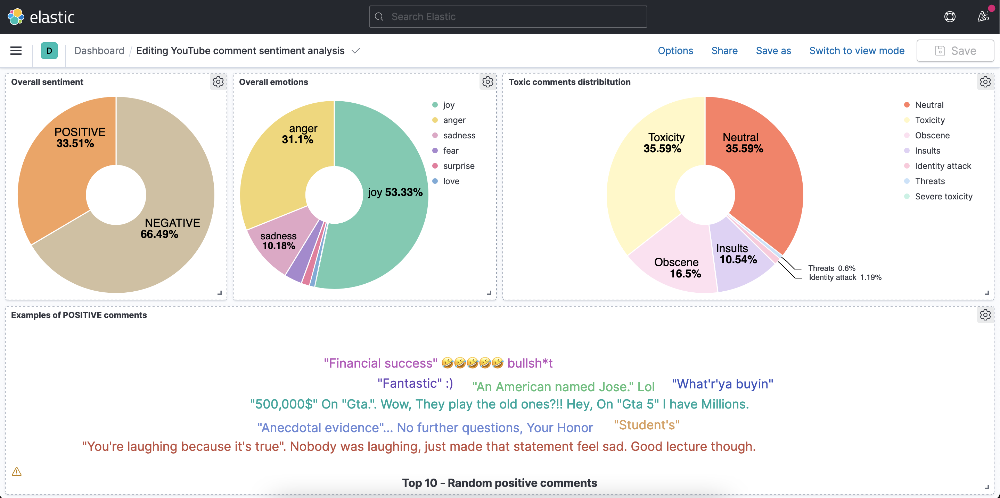

- Overall sentiment : pie chart showing the distribution of positive, negative and neutral comments.
- Overall emotion : pie chart showing the distribution of emotions in the comments.
- Topics : bar chart counting the number of comments discussing a given topic. In the best case scenario they represent objective aspects of a piece of content a creator can work on improving.
- Haters list : list of users responsible for posting inappropriate comments.

Additional :
- Word clouds : a word cloud of the positive and negative comments.
- Sentiment/ emotion examples : a set of comments that best represent each sentiment or emotion.
- Average length of comments : in number of words. Is the audience very verbose ?

In [108]:
from top2vec import Top2Vec

documents = [v['snippet.textDisplay'] for k,v in comments]
print(documents[0])
#topic_classifier = Top2Vec(documents, embedding_model='universal-sentence-encoder')

ModuleNotFoundError: No module named 'top2vec'